# Computer Vision - P4


## Delivery

Your overall grading will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented exhaustively and in *English*.

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Answers to questions also need to be in *English*.

- Make sure to print and plot exactly what it is indicated. If a reference image is provided, your output is expected to be exactly the same unless instructed differently.

- The deliverable of both parts must be a file named **P4_Student1_Student2.zip** that includes:
    - The notebook P4_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.
    - All the images used in this notebook (upload the ones that were not provided)
    
- It is required that your code can be run by us without need of any modification and without getting any errors.

- Use packages and solutions that were covered in your class and tutorials. If you are unsure about using a particular package, you should seek clarification from your instructor to confirm whether it is allowed.

- Please refrain from utilizing resources like ChatGPT to complete this lab assignment.


**Deadline (Campus Virtual): November 28th, 23:00 h**

==============================================================================================
## Descriptors extraction for object detection, based on template matching, ORB, and HOG
==============================================================================================

The main topics of Laboratory 4 are:

    4.1) SSD and Normalized Cross-correlation for template matching

    4.2) HOG image descriptor for object (person) detection

    4.3) Recognition by correspondance, based on feature extraction (ORB)

In order to complete this practicum, the following concepts need to be understood: template matching, feature localization (Harris, Censure), feature descriptor (HOG,ORB, Sift) methods.

It is highly recommendable to structure the code in functions in order to reuse code for different tests and images and make it shorter and more readable. Specially the visualization commands should be encapsulated in separate functions.

In [1]:
# Imports
from skimage import io
from matplotlib import pyplot as plt
import numpy as np
from skimage import io, color, img_as_float, transform, exposure
from skimage.feature import match_template, hog, CENSURE, match_descriptors, plot_matches, ORB, SIFT
from queue import PriorityQueue
import matplotlib.patches as patches
import random
import time
import os
%matplotlib inline

# Auxiliar functions

In [2]:
# Auxiliary function to display a set of images with titles
def showImage(figsize, images, titles, cmap='gray', show_axis=False):
    if len(images) != len(titles):
        raise ValueError("The number of images and titles must be the same.")
    
    # Calculate the number of rows needed for 3 images per row
    n_rows = int(np.ceil(len(images) / 3))
    fig = plt.figure(figsize=figsize)

    for index, image in enumerate(images):
        # Calculate the appropriate row and column for each image
        row = index // 3 + 1
        col = index % 3 + 1
        ax = fig.add_subplot(n_rows, 3, index + 1)
        ax.set_title(titles[index])
        ax.imshow(image, cmap=cmap)
        if not show_axis:
            ax.axis('off')
    plt.show()

In [3]:
# Function to convert any image to grayscale, handling alpha channel if present
def to_grayscale(image):
    # Check if the image has 3 dimensions (row, column, channel)
    if len(image.shape) == 3:
        # Check if the image has 4 channels (RGBA)
        if image.shape[-1] == 4:
            # Convert RGBA to RGB
            image = color.rgba2rgb(image)
        # Now convert to grayscale
        return color.rgb2gray(image)
    # If the image is already 2D, return as is
    return image

## 1 Template matching

**1.1 (10 points)** Given the image 'einstein.png' and the template image 'eye.png', detect the location of the template in the image comparing the use of:
- SSD distance (hint: norm() in numpy.linalg).
- normalized cross-correlation (hint: match_template() of skimage.feature).

Don't forget to normalize the images (having pixel values between [0,1]) before comparing them.

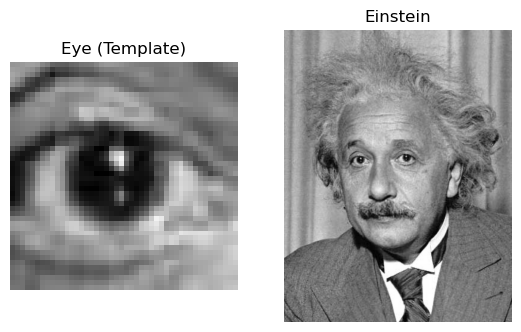

In [4]:
# Your solution here

# Display the template and target images
eye=io.imread('./images/eye.png')
einstein=io.imread('./images/einstein.png')

showImage((10, 5), [eye, einstein], ['Eye (Template)', 'Einstein'])

Create a **function** for template matching applying SSD distance and normalized cross-correlation and display the results in the following format:

<img src="images/tm.png" width="800" height="400">

**Use titles in all figures to understand what is being displayed.**

Note: the decision of threshold for SSD distance and normalized cross-correlation will affect your results, try values that get you as close to the shown result as possible but we understand you might not get exactly the same outcome.

In [5]:
# Your solution here

# Function to apply SSD distance for template matching
def ssd(image, template, threshold):
    # Convert images to floating point format for normalization
    image, template = img_as_float(image), img_as_float(template)

    # Calculate the size of the region to scan in the image
    matchx = image.shape[0] - template.shape[0]
    matchy = image.shape[1] - template.shape[1]
    
    # Initialize the result matrix
    result = np.zeros((matchx, matchy))
    
    # Iterate over the image to find the SSD
    for i in range(matchx):
        for j in range(matchy):
            result[i][j] = np.linalg.norm(image[i:i + template.shape[0], j:j + template.shape[1]] - template)
    
    # Return the result and a thresholded binary version
    return [result, result < threshold]

In [6]:
# Function to apply normalized cross-correlation for template matching
def cross_correlation(image, template, threshold):
    # Normalize the images
    image = img_as_float(image)
    template = img_as_float(template)
    
    # Use the match_template function for cross-correlation
    result = match_template(image, template)
    
    # Return the result and a thresholded binary version
    return [result, result > threshold]

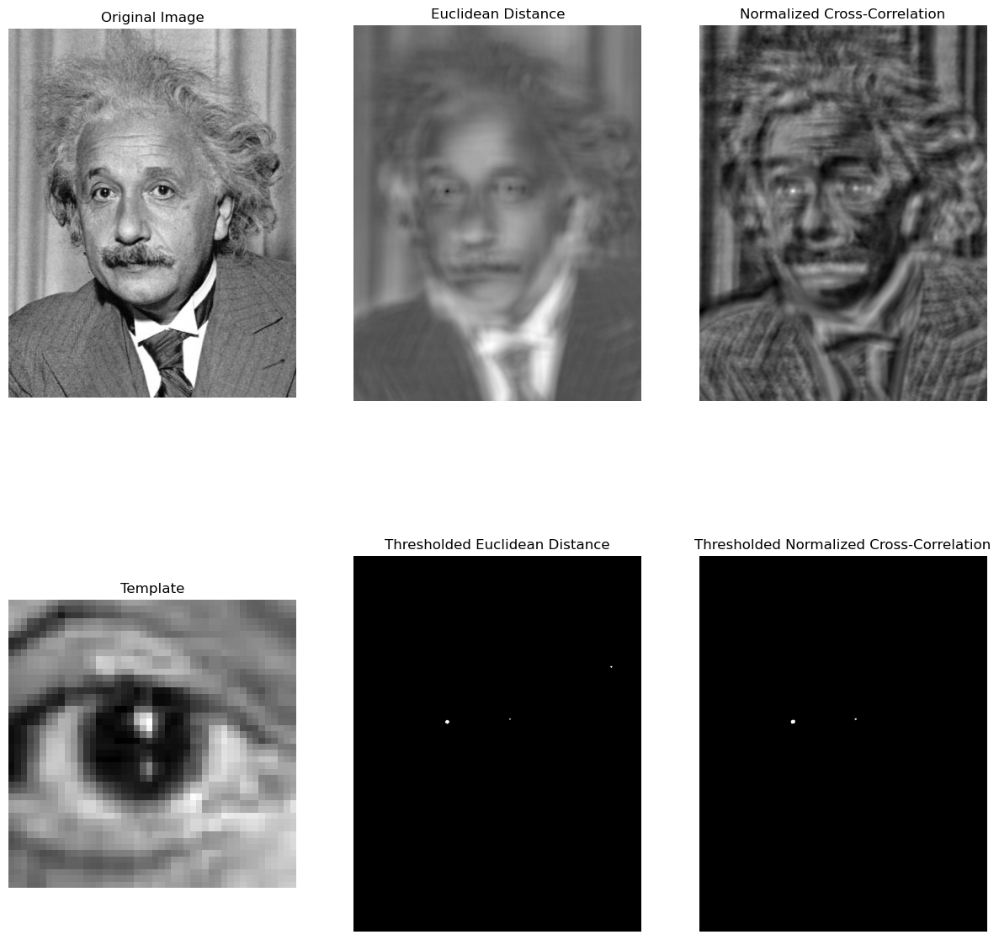

In [7]:
# Convert images to grayscale
image_gray = to_grayscale(einstein)
template_gray = to_grayscale(eye)

# Perform template matching using SSD and cross-correlation
imagesSSD = ssd(image_gray, template_gray, threshold=8.4)
imagesCR = cross_correlation(image_gray, template_gray, threshold=0.55)

# Prepare images and titles for display
images = [image_gray, imagesSSD[0], imagesCR[0], template_gray, imagesSSD[1], imagesCR[1]]
titles = ["Original Image", "Euclidean Distance", "Normalized Cross-Correlation", 
          "Template", "Thresholded Euclidean Distance", "Thresholded Normalized Cross-Correlation"]

# Display the results using the showImage function
showImage(figsize=(15, 15), images=images, titles=titles)

**1.2 (5 points)** How does the result of the template matching change if the image changes its contrast (for example if you make it clearer or darker)?

Similarly to the previous case, please, visualize the euclidean distance and normalized cross-correlation images as well as the binarized (thresholded) images in the two cases.

**Note:** Use titles of the figures to explain what is displayed.


**Answer to the question**

> To explore how changes in contrast affect the results of template matching, we'll apply the same template matching methods (SSD distance and normalized cross-correlation) to both the original einstein.png image and a version with altered contrast, einstein_br.png. The expectation is that changes in contrast could affect the matching accuracy, as both SSD and normalized cross-correlation rely on pixel intensity values.

Read `einstein_br.png` and display the results of the template matching techniques used on 1.1 on this image, using `eye.png` as template:

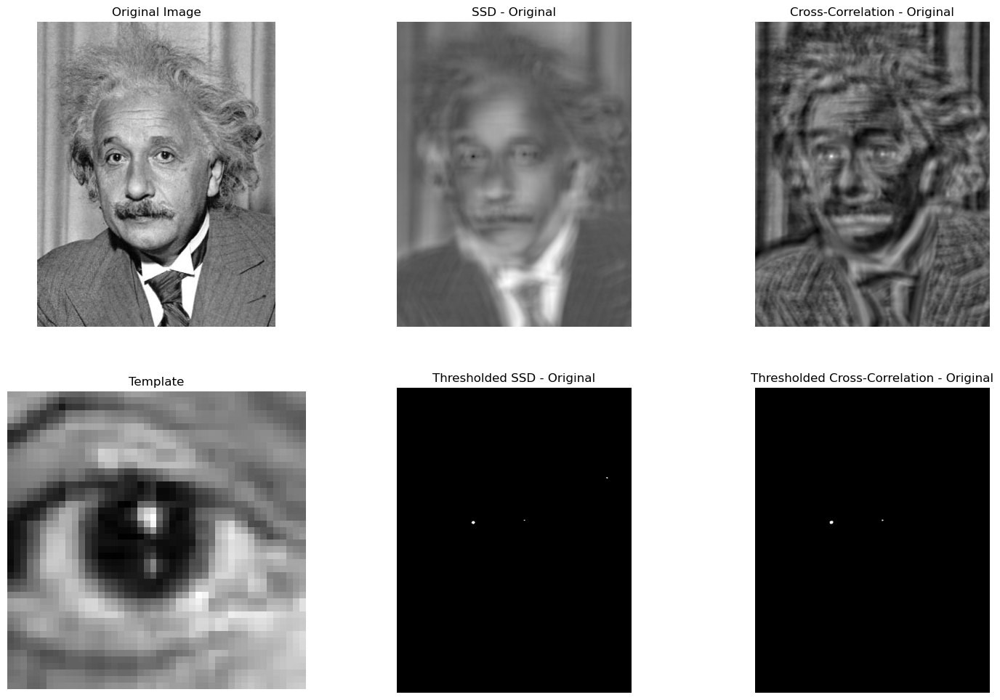

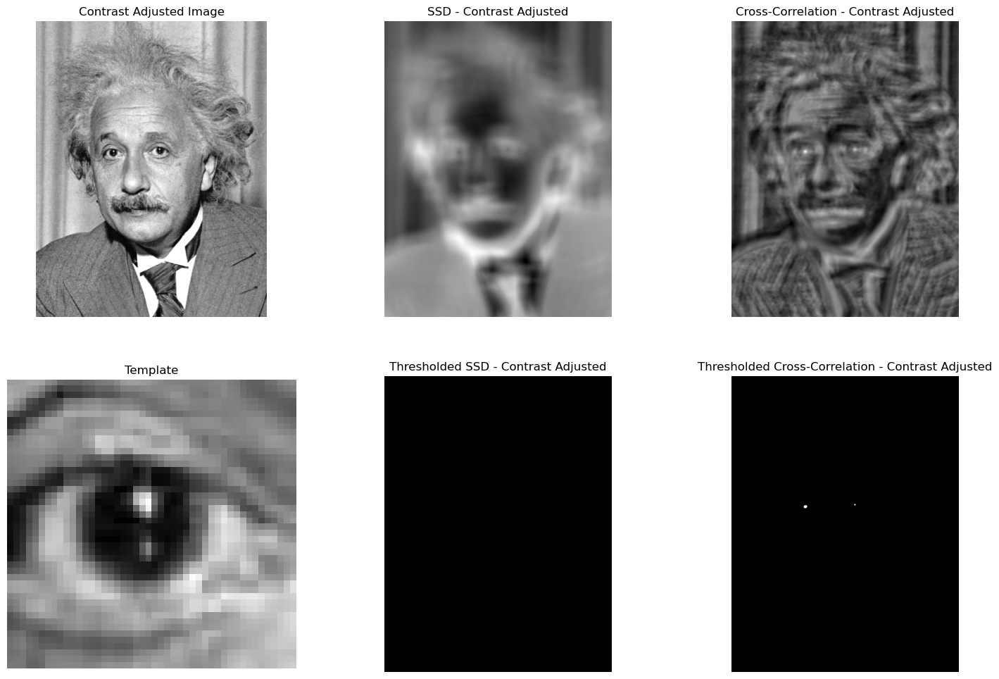

In [8]:
# Your solution here

einstein_br = io.imread('./images/einstein_br.png')  # Adjusted contrast image

# Convert images to grayscale
template_gray = to_grayscale(eye)
image_gray = to_grayscale(einstein)
image_gray_br = to_grayscale(einstein_br)

# Perform template matching on original image
imagesSSD = ssd(image_gray, template_gray, threshold=8.4)
imagesCR = cross_correlation(image_gray, template_gray, threshold=0.55)

# Perform template matching on contrast-adjusted image
imagesSSD_br = ssd(image_gray_br, template_gray, threshold=8.4)
imagesCR_br = cross_correlation(image_gray_br, template_gray, threshold=0.55)

# Prepare images and titles for display - Original Image
images_original = [image_gray, imagesSSD[0], imagesCR[0], template_gray, imagesSSD[1], imagesCR[1]]
titles_original = ["Original Image", "SSD - Original", "Cross-Correlation - Original", 
                   "Template", "Thresholded SSD - Original", "Thresholded Cross-Correlation - Original"]

# Display results for the original image
showImage(figsize=(18, 12), images=images_original, titles=titles_original)

# Prepare images and titles for display - Contrast Adjusted Image
images_contrast_adjusted = [image_gray_br, imagesSSD_br[0], imagesCR_br[0], template_gray, imagesSSD_br[1], imagesCR_br[1]]
titles_contrast_adjusted = ["Contrast Adjusted Image", "SSD - Contrast Adjusted", "Cross-Correlation - Contrast Adjusted",
                            "Template", "Thresholded SSD - Contrast Adjusted", "Thresholded Cross-Correlation - Contrast Adjusted"]

# Display results for the contrast-adjusted image
showImage(figsize=(18, 12), images=images_contrast_adjusted, titles=titles_contrast_adjusted)

Print the minimum SSD and the maximum Normalized Cross-Correlation (NCC)

In [9]:
# Your solution here

# Find and print the minimum value in the SSD result
min_ssd = np.min(imagesSSD[0])
print(f"Minimum SSD: {min_ssd}")

# Find and print the maximum value in the NCC result
max_ncc = np.max(imagesCR[0])
print(f"Maximum NCC: {max_ncc}")

Minimum SSD: 1.9895304595412766
Maximum NCC: 0.9768202443115033


**1.3 (5 points)** Read `einstein_mask.png` and display the results on this image using your previously coded function, using the `eye.png` template:

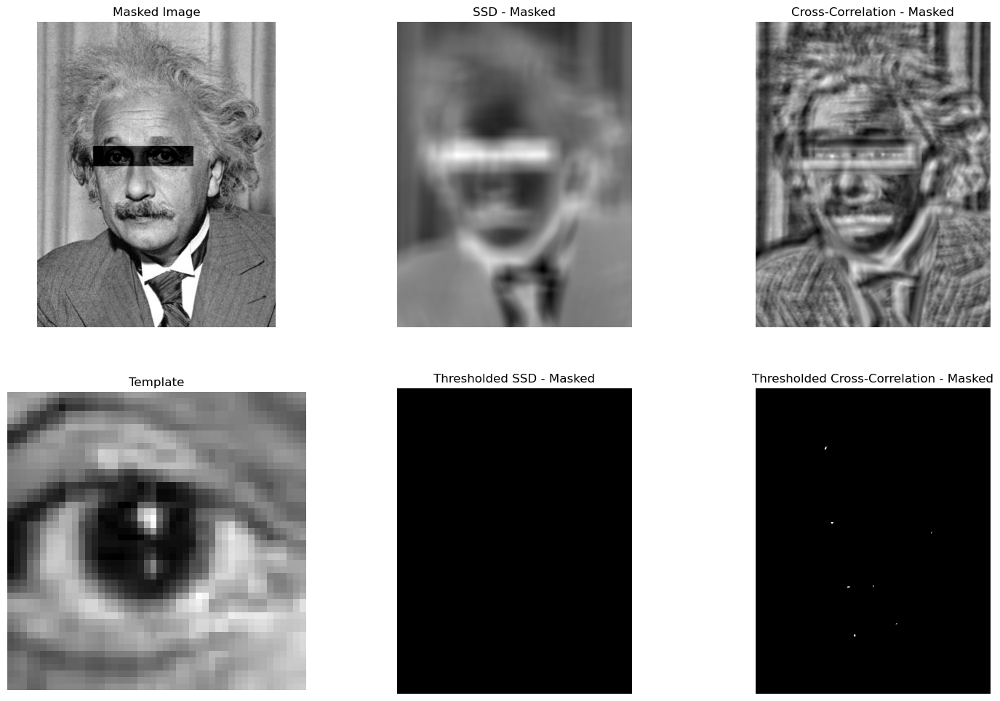

In [10]:
# Your solution here

# Read the template and masked target images
eye = io.imread('./images/eye.png')
einstein_mask = io.imread('./images/einstein_mask.png')

# Convert images to grayscale
template_gray = to_grayscale(eye)
image_gray_mask = to_grayscale(einstein_mask)

# Perform template matching on masked image
imagesSSD_mask = ssd(image_gray_mask, template_gray, threshold=8.7)
imagesCR_mask = cross_correlation(image_gray_mask, template_gray, threshold=0.5)

# Prepare images and titles for display
images_mask = [image_gray_mask, imagesSSD_mask[0], imagesCR_mask[0], 
               template_gray, imagesSSD_mask[1], imagesCR_mask[1]]
titles_mask = ["Masked Image", "SSD - Masked", "Cross-Correlation - Masked", 
               "Template", "Thresholded SSD - Masked", "Thresholded Cross-Correlation - Masked"]

# Display the results using the showImage function
showImage(figsize=(18, 12), images=images_mask, titles=titles_mask)

Print the minimum SSD and the maximum NCC

In [11]:
# Your solution here

# Find and print the minimum value in the SSD result
min_ssd_mask = np.min(imagesSSD_mask[0])
print(f"Minimum SSD: {min_ssd_mask}")

# Find and print the maximum value in the NCC result
max_ncc_mask = np.max(imagesCR_mask[0])
print(f"Maximum NCC: {max_ncc_mask}")

Minimum SSD: 23.70009485966591
Maximum NCC: 0.6166362739336941


What are the distances between the template and the image around the eyes of the image?

> The distances between the template and the image around the eyes, as measured by the Sum of Squared Differences (SSD), will be low, close to 0.0, indicating a good match. In contrast, the values from the Normalized Cross-Correlation (NCC) around the eyes will be high, approaching 1.0, also suggesting a strong match. These outcomes are expected since the template used for matching is an image of an eye, aligning well with the eye regions in the target image.

Comment the template matching process:
* Are the algorithms affected by contrast changes in the image?
    > SSD: SSD is sensitive to changes in contrast. When the contrast of an image changes, the pixel intensity values are altered, directly affecting the SSD calculations. Higher contrast might exaggerate differences, potentially leading to higher SSD values even if the structural match is good.

    > NCC: NCC is generally more robust to contrast changes. It measures correlation in terms of patterns and structures, rather than absolute pixel intensities. Therefore, NCC can still perform well under varying contrast conditions, although extreme changes in contrast might still have some impact.
    
* How do metrics (i.e. minimum euclidean distance and maximum NCC) change in all previous cases? Is there a big difference among these values?
    > Minimum Euclidean Distance (SSD): In cases where the template matches well with a region in the image (e.g., the eye template with the eye region in the Einstein image), the SSD values will be low. If the image undergoes contrast adjustments, these SSD values might increase due to the intensification of pixel value differences, as we saw in the previous results.

    > Maximum NCC: A high NCC value near 1 indicates a strong match. NCC values would be consistently high in regions where the template matches well. Even with contrast adjustments, if the structural integrity of the image remains similar, NCC values may not show a drastic change.

* What parameters it has and which measure for image comparisons works better.
    > Parameters: The key parameters in template matching are the threshold values for determining a match in SSD and NCC. Choosing appropriate thresholds is crucial, as it affects the sensitivity of the match detection.
    
    > Effectiveness:
    
        1. If the primary concern is structural and pattern matching without being significantly influenced by lighting and contrast, NCC tends to be more effective.

        2. If exact pixel-to-pixel intensity matching is more important and the images are expected to have consistent lighting and contrast, SSD can be more suitable.

**1.4 (5 points)** How does the result of the template matching change if instead the template is the one that changes its contrast (for example if you make it clearer or darker)? To this purpose, use the `eye_br.png` template.

**Answer to the question**

1. Sum of Squared Differences (SSD):

    > SSD is sensitive to changes in pixel intensity. If the contrast of the template is altered, it can lead to significant differences in the SSD values, as SSD directly compares pixel intensities of the template and the target image. A template with higher or lower contrast might not match as well with the regions of the original image that would have been a good match with the unaltered template.

2. Normalized Cross-Correlation (NCC):
    > NCC is more robust to changes in contrast than SSD. It measures the correlation of patterns and structures rather than focusing on exact pixel intensities. However, significant changes in contrast can still affect NCC, especially if they alter the perceived structural or pattern information in the template. Mild contrast adjustments might have a minimal impact, but drastic changes could lead to reduced correlation scores in regions that would otherwise match well.

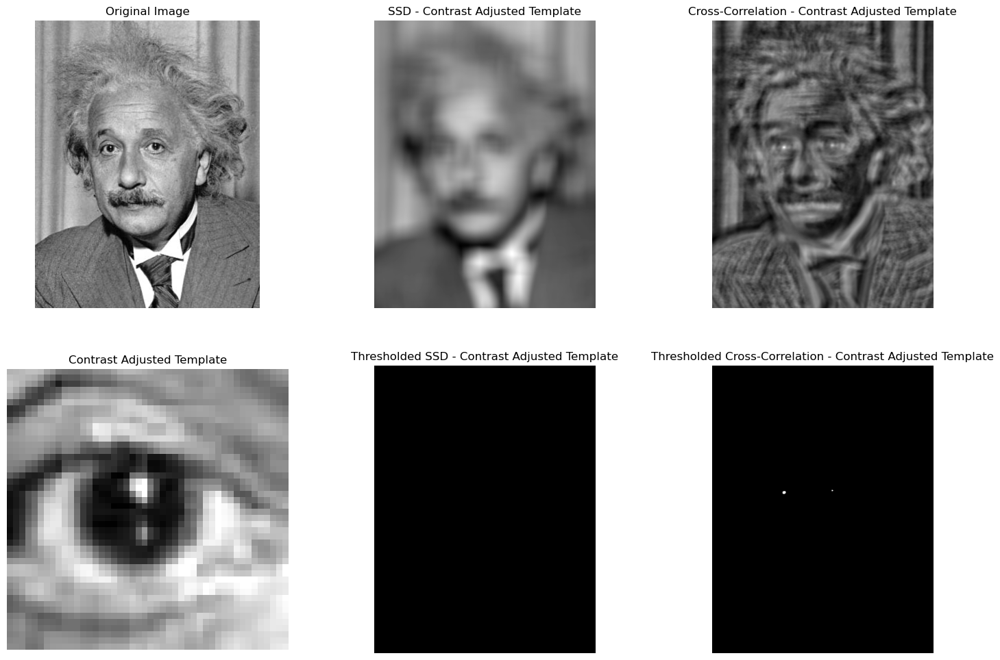

In [12]:
# Your solution here

# Read the contrast-adjusted template
eye_br = io.imread('./images/eye_br.png')

# Convert the contrast-adjusted template to grayscale
template_gray_br = to_grayscale(eye_br)

# Perform template matching with the contrast-adjusted template
imagesSSD_br_template = ssd(image_gray, template_gray_br, threshold=8.4)
imagesCR_br_template = cross_correlation(image_gray, template_gray_br, threshold=0.55)

# Prepare images and titles for display with the contrast-adjusted template
images_br_template = [image_gray, imagesSSD_br_template[0], imagesCR_br_template[0], 
                      template_gray_br, imagesSSD_br_template[1], imagesCR_br_template[1]]
titles_br_template = ["Original Image", "SSD - Contrast Adjusted Template", "Cross-Correlation - Contrast Adjusted Template", 
                      "Contrast Adjusted Template", "Thresholded SSD - Contrast Adjusted Template", "Thresholded Cross-Correlation - Contrast Adjusted Template"]

# Display the results using the showImage function
showImage(figsize=(18, 12), images=images_br_template, titles=titles_br_template)

Check how the result changes if the template is rotated.

Visualize the template and its rotation by 2º, 5º, 10º, 15º and 20º. Obtain again the template matching using the Euclidean distance and normalized cross-correlation. Pick fixed values of thresholds that are well suited for the non rotated image.  

**Help:** use the function rotate() in skimage.transform

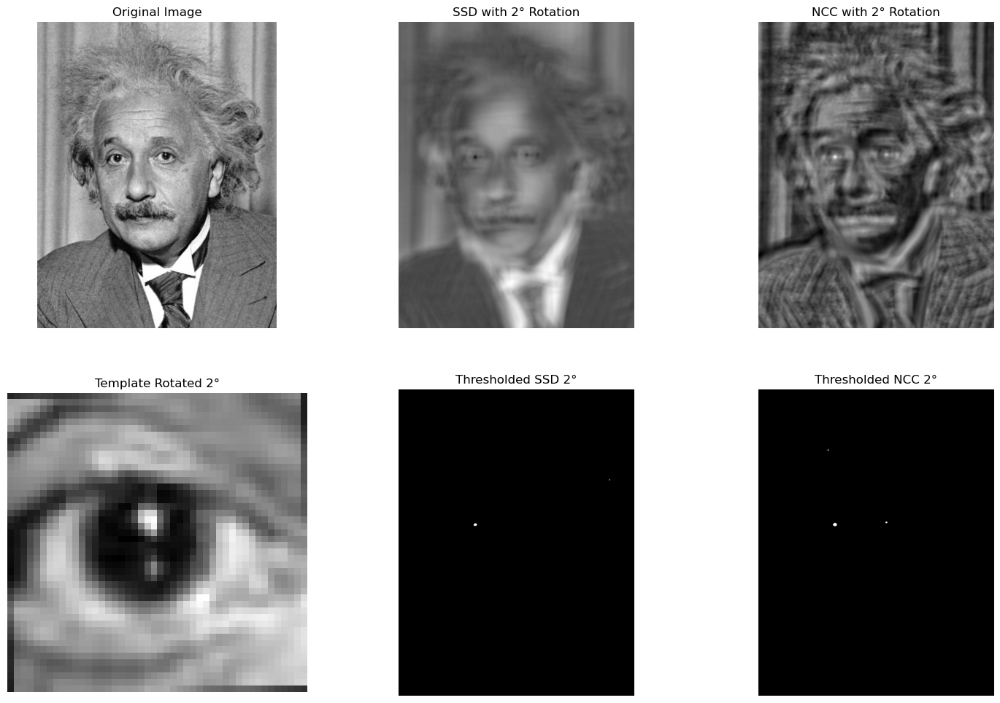

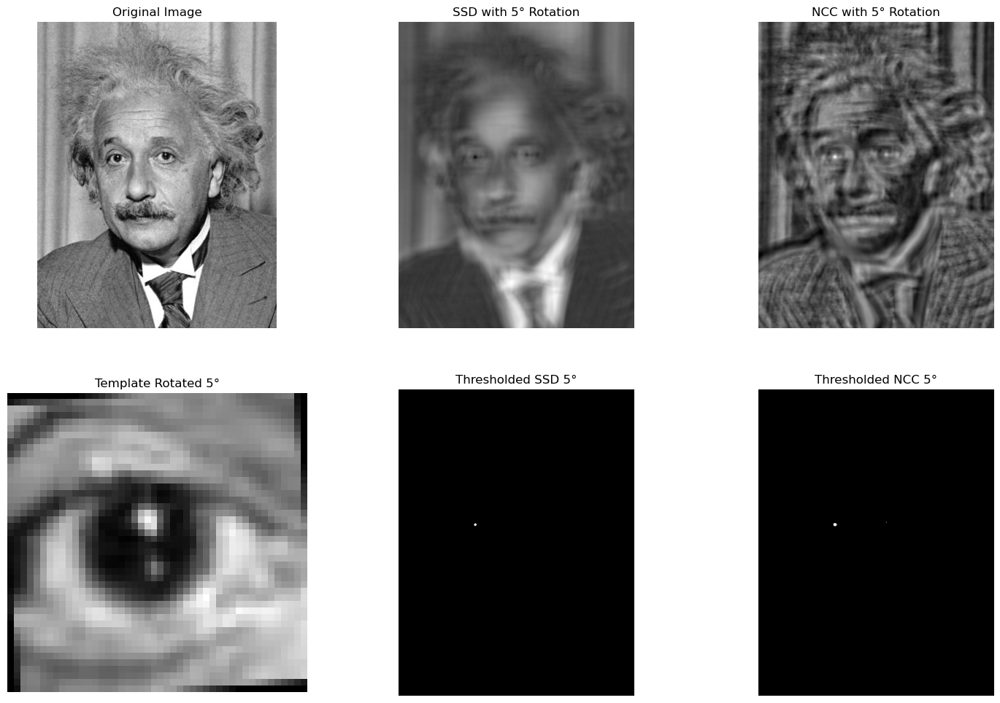

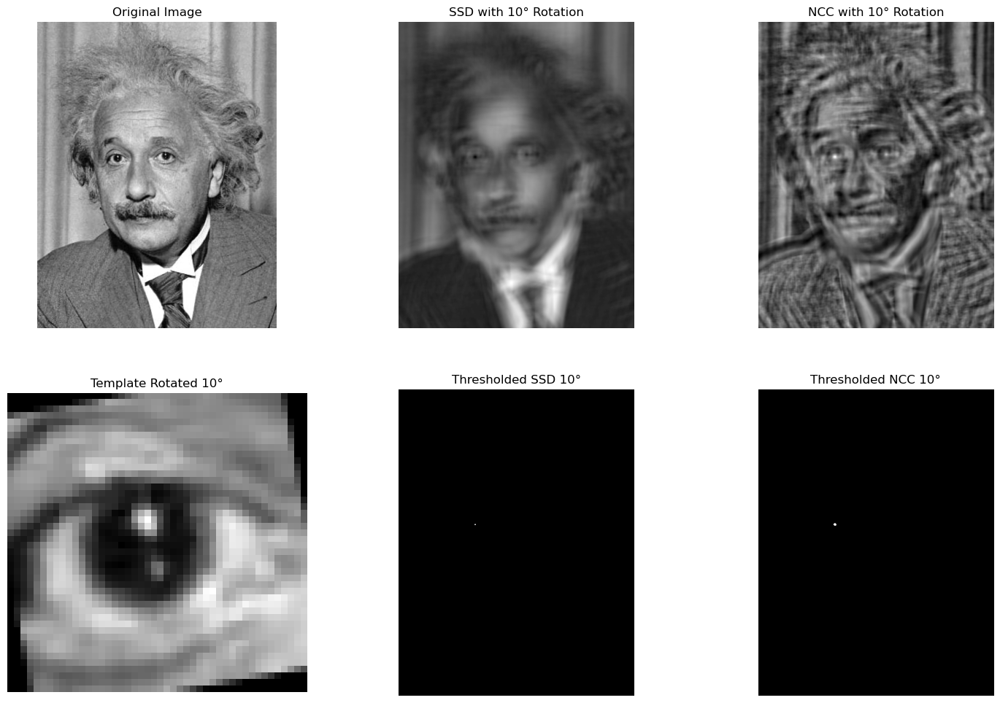

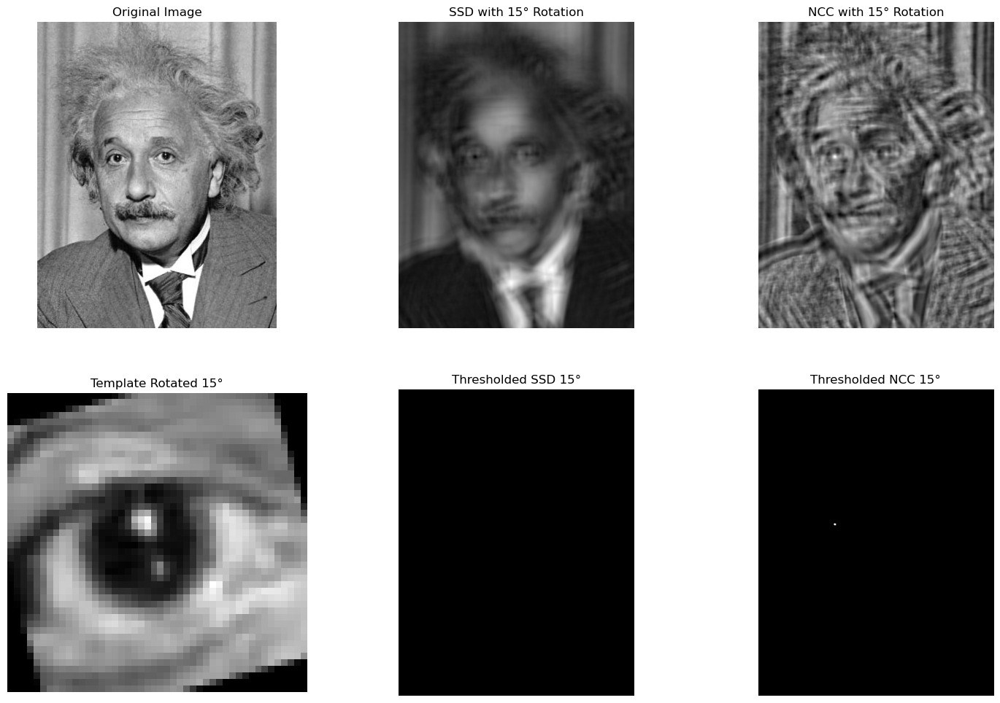

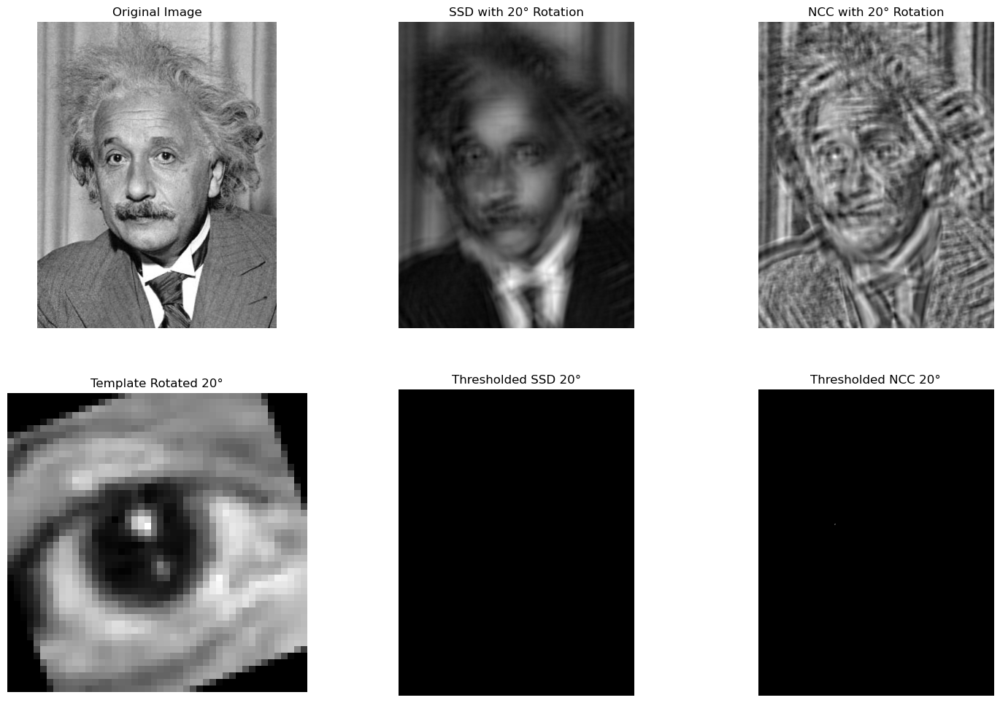

In [13]:
# Your solution here

# Function to rotate the template by a given angle
def rotate_template(template, angle):
    return transform.rotate(template, angle, resize=False)

# Read the original template and target image
eye = io.imread('./images/eye.png')
einstein = io.imread('./images/einstein.png')

# Convert images to grayscale
template_gray = to_grayscale(eye)
image_gray = to_grayscale(einstein)

# Define thresholds
ssd_threshold = 8.4
ncc_threshold = 0.5

# Angles for rotation
angles = [2, 5, 10, 15, 20]

# Loop through each angle to perform template matching and display results
for angle in angles:
    # Rotate the template by the current angle
    rotated_template = rotate_template(template_gray, angle)

    # Perform template matching with the rotated template
    ssd_result, ssd_thresholded = ssd(image_gray, rotated_template, ssd_threshold)
    ncc_result, ncc_thresholded = cross_correlation(image_gray, rotated_template, ncc_threshold)

    # Prepare images and titles for display for the current angle
    images = [image_gray, ssd_result, ncc_result, rotated_template, ssd_thresholded, ncc_thresholded]
    titles = ['Original Image', f'SSD with {angle}° Rotation', f'NCC with {angle}° Rotation',
              f'Template Rotated {angle}°', f'Thresholded SSD {angle}°', f'Thresholded NCC {angle}°']

    # Display the results using the showImage function
    showImage(figsize=(18, 12), images=images, titles=titles, show_axis=False)

Comment the template matching process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Is the algorithms affected by contrast changes in the tempate image?
* What parameters it has and which measure for image comparisons works better.

**Answer to the question**

> Template matching is a technique in image processing that finds parts of an image that match a template image. Commonly, it's used in applications like object detection, tracking, and recognition.

1. Sum of Squared Differences (SSD):

    > Algorithm: Calculates the sum of squared pixel differences between the template and the image.

    > Advantages: Simple and effective for similar lighting and contrast.

    > Disadvantages: Sensitive to lighting and contrast changes; not robust to geometric changes.
    
    > Parameters: A threshold to identify matches; lower SSD values indicate better matches.

2. Normalized Cross-Correlation (NCC):

    > Algorithm: Measures similarity through the correlation coefficient between the template and the image.

    > Advantages: More robust to lighting variations; better in varied conditions.

    > Disadvantages: Computationally intensive; not immune to geometric changes.
    
    > Parameters: A threshold for matching; higher NCC values (closer to 1) signify stronger matches.

3. Impact of Contrast Changes in Template Image

    > SSD: Highly sensitive to contrast changes in the template.

    > NCC: More resilient to contrast changes, but significant alterations can still affect results.

4. Best Measure for Image Comparisons

    > SSD is suitable when the template and image have consistent lighting and contrast.

    > NCC is preferred for robustness against lighting variations.
    
    > Choice depends on specific task requirements and conditions.

# 2 Histogram of Oriented Gradients

In this section we will treat the following topic: HOG image descriptor. Application to person detection.

The Histogram of Oriented Gradients (HOG) feature descriptor is classical image descriptor for object detection.

Given the image `person_template.bmp` and the folder `/images/TestPersonImages/`, apply the HOG descriptor in order to detect where there is a person in the images. To this purpose, apply the "sliding window" technique. We use images from GRAZ 01 data from [INRIA datasets](http://pascal.inrialpes.fr/data/human/).

**2.1. (5 points)** Read the template (`person_template.bmp`), obtain its HOG descriptor (with the optimal parameters) and visualize it.

Help: the HOG detector function is in the skimage.feature library ([Help](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html#sphx-glr-auto-examples-features-detection-plot-hog-py)).

Obtain 2 versions of the HOG descriptor:
- With the default parameters.
- Then with 4x4 pixels per cell and 2x2 cells per block and orientations set to 8

Visualize the original image, the default values HOG descriptor and the defined parameters HOG descriptor in a 1x3 grid of images.

In [14]:
# Auxiliary function to get the HOG features of an image using the default parameters
def getHOG(image, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3), channel_axis=None):
    img_gray_f = img_as_float(image)

    if channel_axis is not None:
        fd, hog_image = hog(img_gray_f, orientations=orientations, pixels_per_cell=pixels_per_cell,
                        cells_per_block=cells_per_block, visualize=True, channel_axis=channel_axis)
    else:
        fd, hog_image = hog(img_gray_f, orientations=orientations, pixels_per_cell=pixels_per_cell,
                        cells_per_block=cells_per_block, visualize=True)
    return hog_image

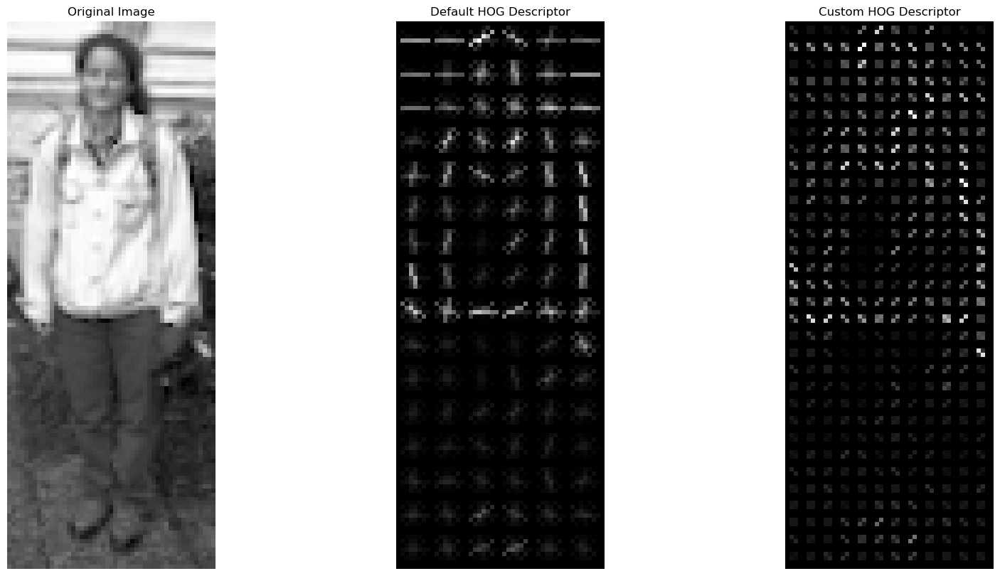

In [15]:
# Your solution here

# Read and preprocess the image
person = io.imread('./images/person_template.bmp')
person_gray = to_grayscale(person)

# Obtain HOG descriptors with default and custom parameters
hog_default = getHOG(person_gray)  # Default parameters of the hog function
hog_custom = getHOG(person_gray, orientations=8, pixels_per_cell=(4, 4), cells_per_block=(2, 2))

# Visualize the images
images = [person_gray, hog_default, hog_custom]
titles = ['Original Image', 'Default HOG Descriptor', 'Custom HOG Descriptor']
showImage((20, 10), images, titles)

Print and explain the number of feature resulting on the default parameters HOG descriptor (4536). Break this number down, starting from the original image size.

In [16]:
# Your solution here

# The default parameters for the HOG descriptor are:
# orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)

# Original image size
print(f"Original Image Dimensions: {person_gray.shape}") # --> (129, 49)

## Cells calculation ##
# Each cell is 8x8 pixels
# The number of cells in the x direction is the width divided by the number of pixels per cell
print(f"Number of Cells in X Direction: {person_gray.shape[1] // 8}") # --> 6 (since partial cells are ignored)

# The number of cells in the y direction is the height divided by the number of pixels per cell
print(f"Number of Cells in Y Direction: {person_gray.shape[0] // 8}") # --> 16 (since partial cells are ignored)

# The total number of cells is the product of the number of cells in each direction
print(f"Total Number of Cells: {(person_gray.shape[0] // 8) * (person_gray.shape[1] // 8)}") # --> 96

## Blocks calculation ##
# Each block is 3x3 cells
# The number of blocks in the x direction is the number of cells in the x direction minus 2 (or number of cells in the x direction minus the number of cells per block plus 1)
print(f"Number of Blocks in X Direction: {person_gray.shape[1] // 8 - 2}") # --> 4

# The number of blocks in the y direction is the number of cells in the y direction minus 2 (or number of cells in the y direction minus the number of cells per block plus 1)
print(f"Number of Blocks in Y Direction: {person_gray.shape[0] // 8 - 2}") # --> 14

# The total number of blocks is the product of the number of blocks in each direction
print(f"Total Number of Blocks: {(person_gray.shape[0] // 8 - 2) * (person_gray.shape[1] // 8 - 2)}") # --> 56

## Features calculation ##
# Each cell in a block contriubutes 'orientations' number of features
# Each block thus has features equal to the number of cells in the block times the number of orientations
print(f"Number of Features per Block: {(3 * 3) * 9}") # --> 81 features

# The total number of features is the product of the number of blocks and the number of features per block
print(f"Total Number of Features: {56 * 81}") # --> 4536 features


Original Image Dimensions: (129, 49)
Number of Cells in X Direction: 6
Number of Cells in Y Direction: 16
Total Number of Cells: 96
Number of Blocks in X Direction: 4
Number of Blocks in Y Direction: 14
Total Number of Blocks: 56
Number of Features per Block: 81
Total Number of Features: 4536


**2.2. (15 points)** Apply the HOG descriptor on the complete set of images for person detection.

a) Read images from the folder "TestPersonImages", slide a window on each image, obtain the HOG descriptor and compare to the HOG descriptor of the person template.

b) Visualize the location in the image that is the most similar to the person template using the distance between the template and test image descriptors.

Display the results of every person detection following this format:

<img src="images/hog.png" width="400" height="200">

In [17]:
def compare(template, image, orientations, pixels_per_cell, cells_per_block, channel_axis=None):
    # Compute the HOG descriptor for the template image
    hog_template = getHOG(template, orientations, pixels_per_cell, cells_per_block, channel_axis)
    
    # Calculate the maximum x and y coordinates for the sliding window based on image and template sizes
    matchx = image.shape[0] - template.shape[0]
    matchy = image.shape[1] - template.shape[1]

    # Compute the HOG descriptor for the entire test image
    result = getHOG(image, orientations, pixels_per_cell,
                    cells_per_block, channel_axis)
    
    # PriorityQueue to store distances and coordinates, for finding the minimum distance
    pq = PriorityQueue()
    
   # Sliding window: iterate over the test image with a step size of 5 pixels
    for i in range(0,matchx,5):
        for j in range(0,matchy,5):
            # Extract the region of the image corresponding to the current window position
            region = image[i:i+template.shape[0],j:j+template.shape[1]]
            hog_region = getHOG(region, orientations, pixels_per_cell,
                    cells_per_block, channel_axis)
            hog_region_rescaled = exposure.rescale_intensity(hog_region, in_range=(0,20))
            
            # Calculate the Euclidean distance between the HOG descriptor of the region and the template
            hog_distance = np.linalg.norm(hog_region_rescaled - hog_template)

            # Store the distance and coordinates in the PriorityQueue
            info = [i, j]
            pq.put((hog_distance, info))
                   
    # Retrieve the coordinates of the region with the minimum distance to the template
    inf = pq.get()[1]
    minX = inf[0]
    minY = inf[1]

    # Draw rectangles on the original image and the HOG image to indicate the detected region
    rect1 = patches.Rectangle((minY,minX), template.shape[1], template.shape[0], edgecolor='r', facecolor='none')
    rect2 = patches.Rectangle((minY,minX), template.shape[1], template.shape[0], edgecolor='r', facecolor='none')

    # Set up the figure for visualization
    _, position = plt.subplots(ncols=3, figsize=(15,20))
    position[0].imshow(template, cmap='gray')
    position[0].set_title("Person template")
    position[1].imshow(image, cmap='gray')
    position[1].add_patch(rect1)
    position[1].set_title("Best Region Match")
    position[2].imshow(result, cmap='gray')
    position[2].set_title("HOG distances")
    position[2].add_patch(rect2)
    plt.show()

Image number:  0


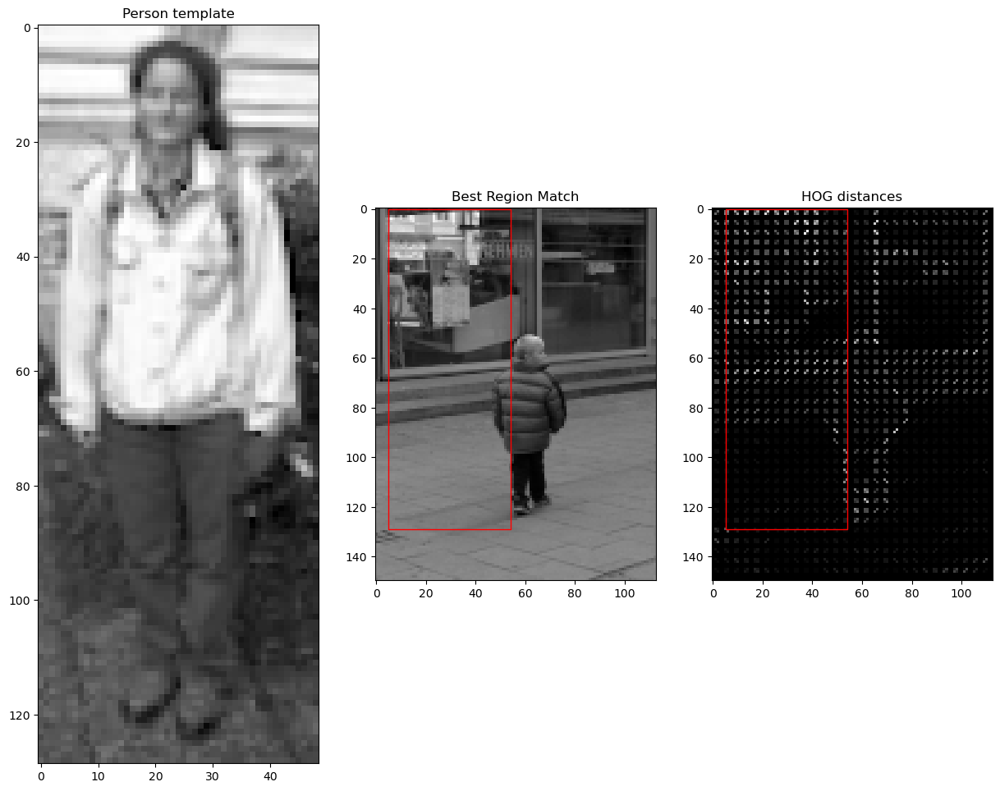

Image number:  1


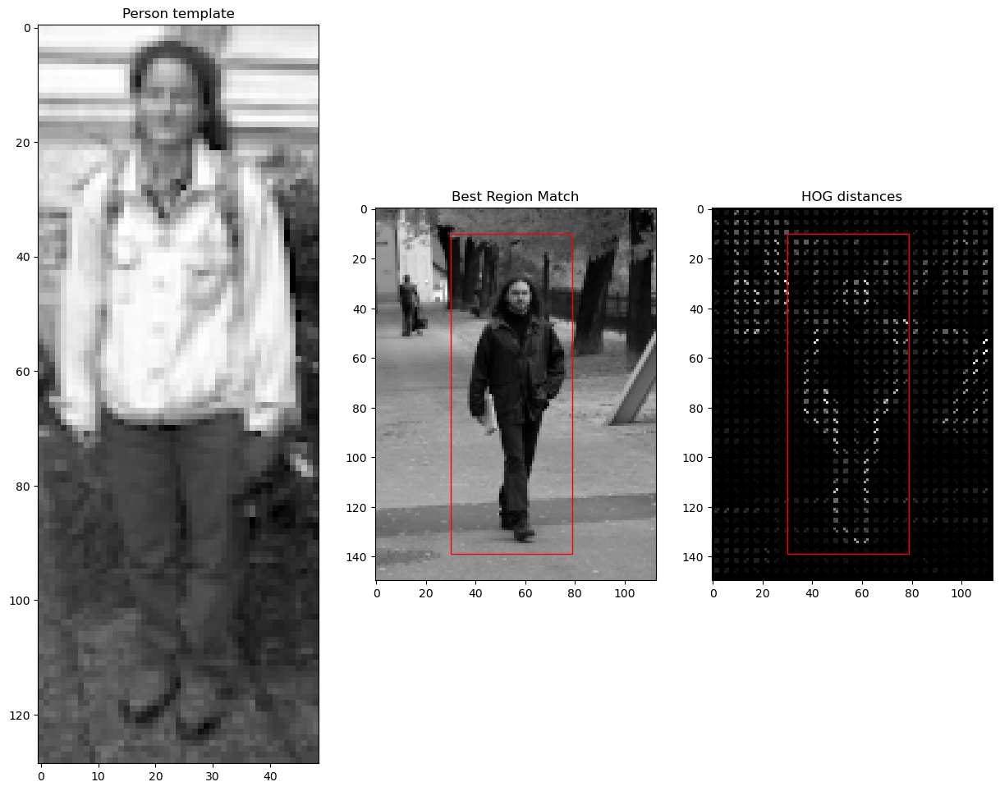

Image number:  2


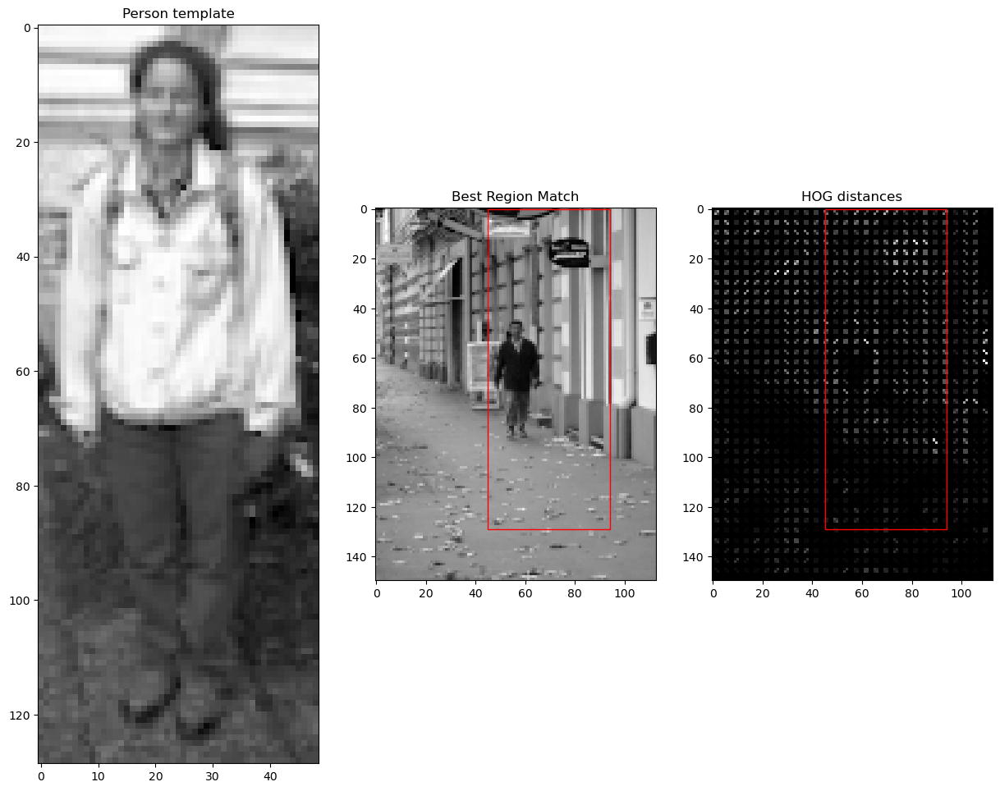

Image number:  3


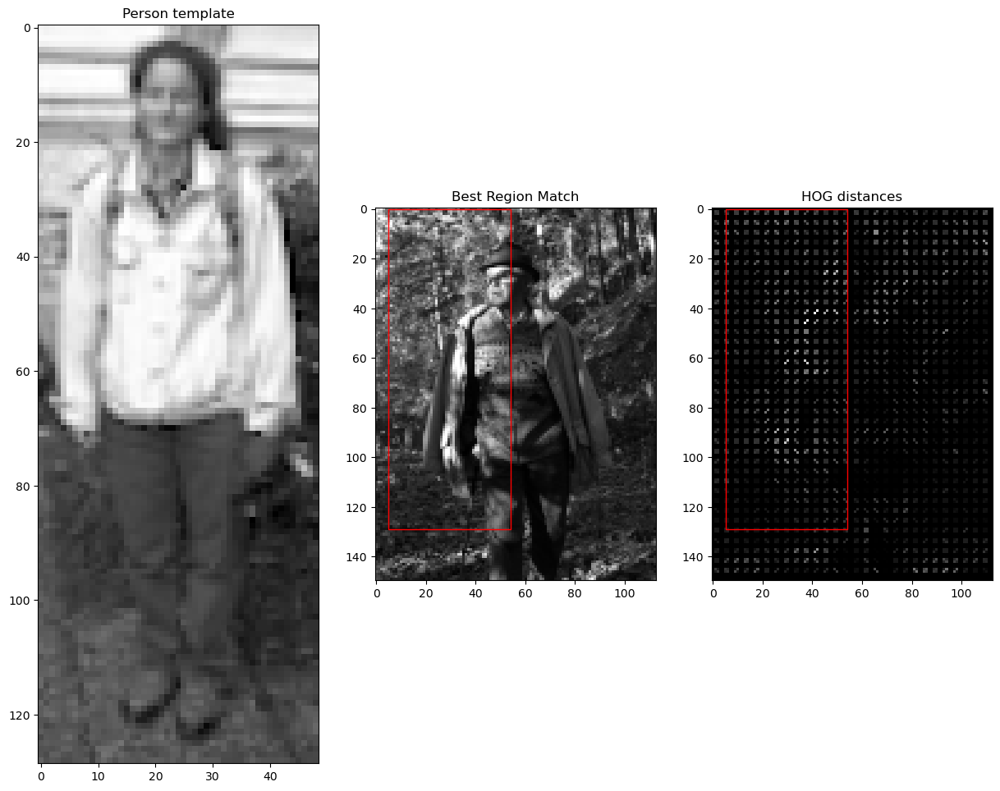

Image number:  4


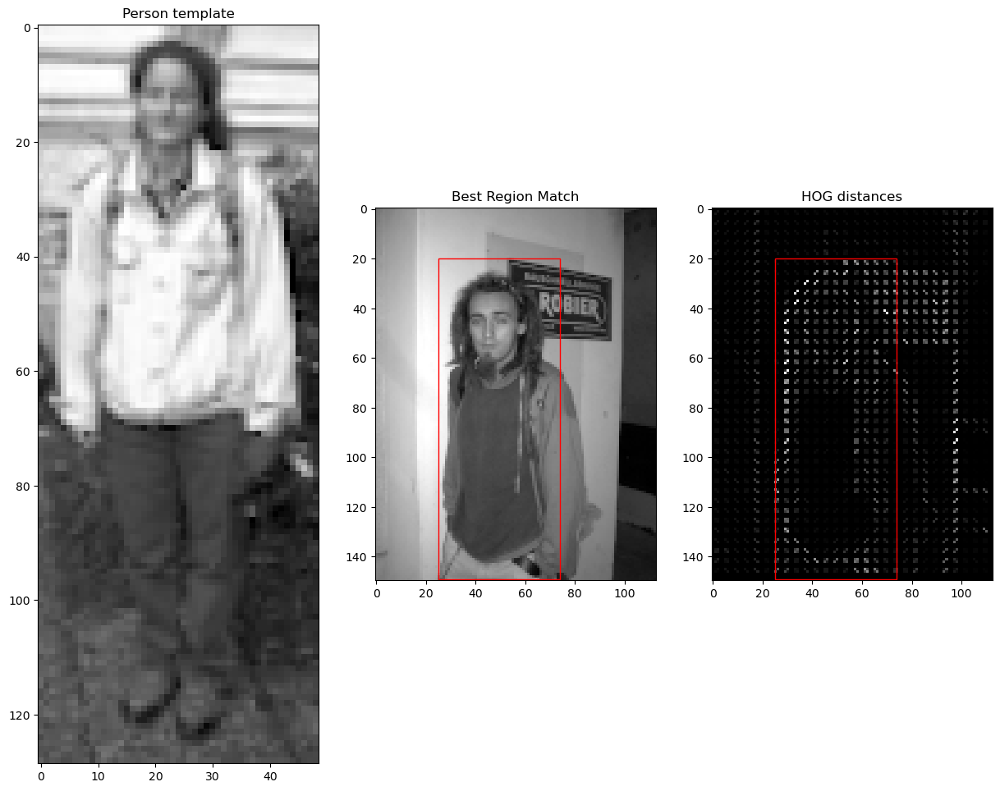

Image number:  5


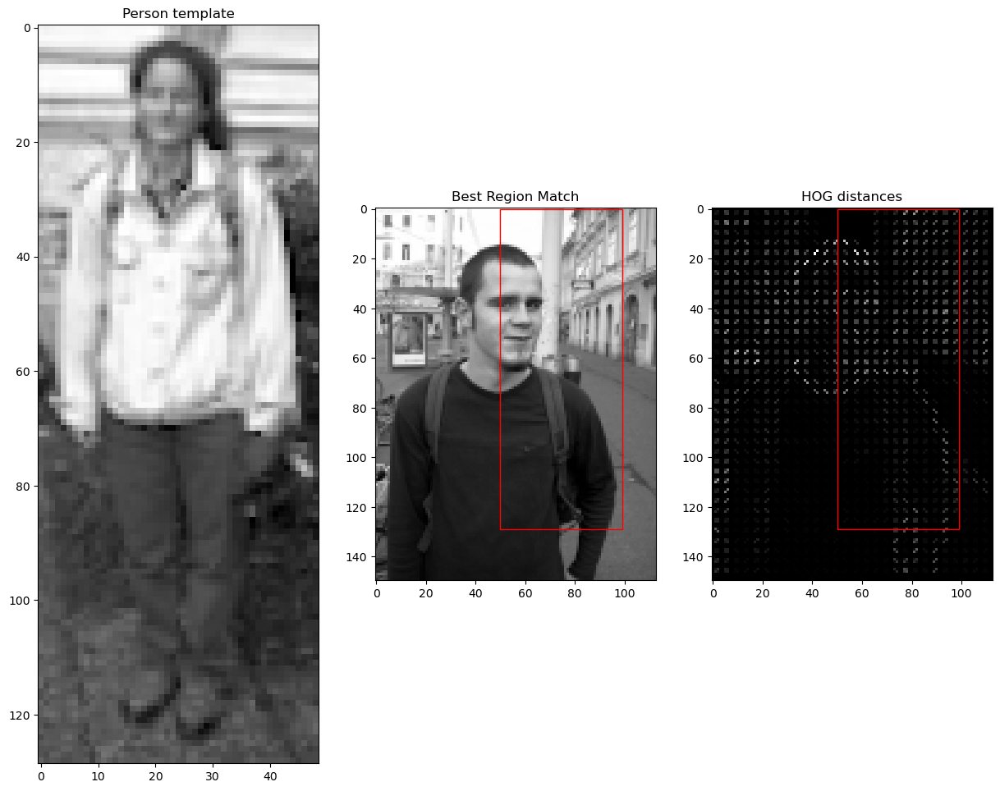

Image number:  6


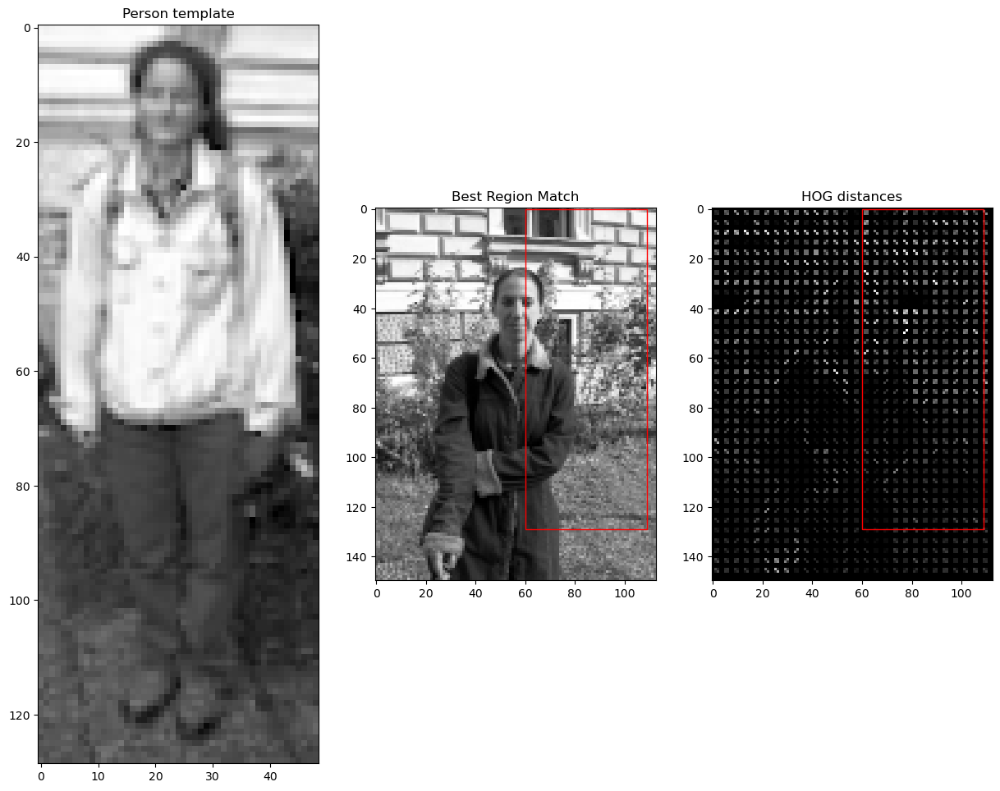

Image number:  7


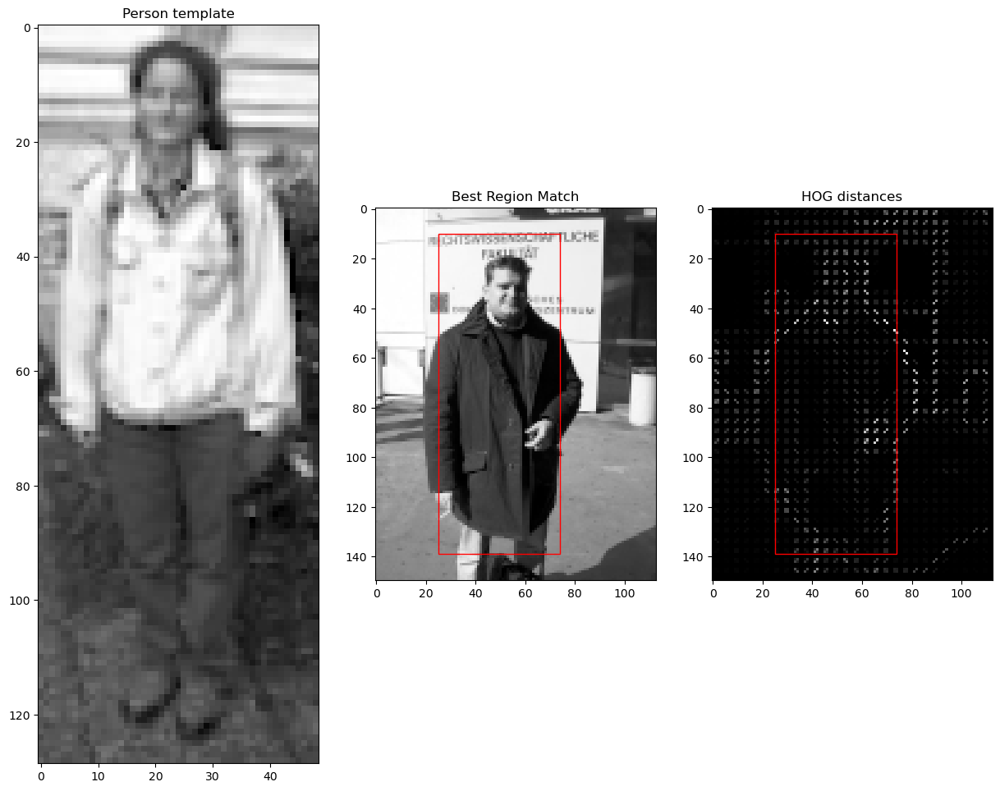

Image number:  8


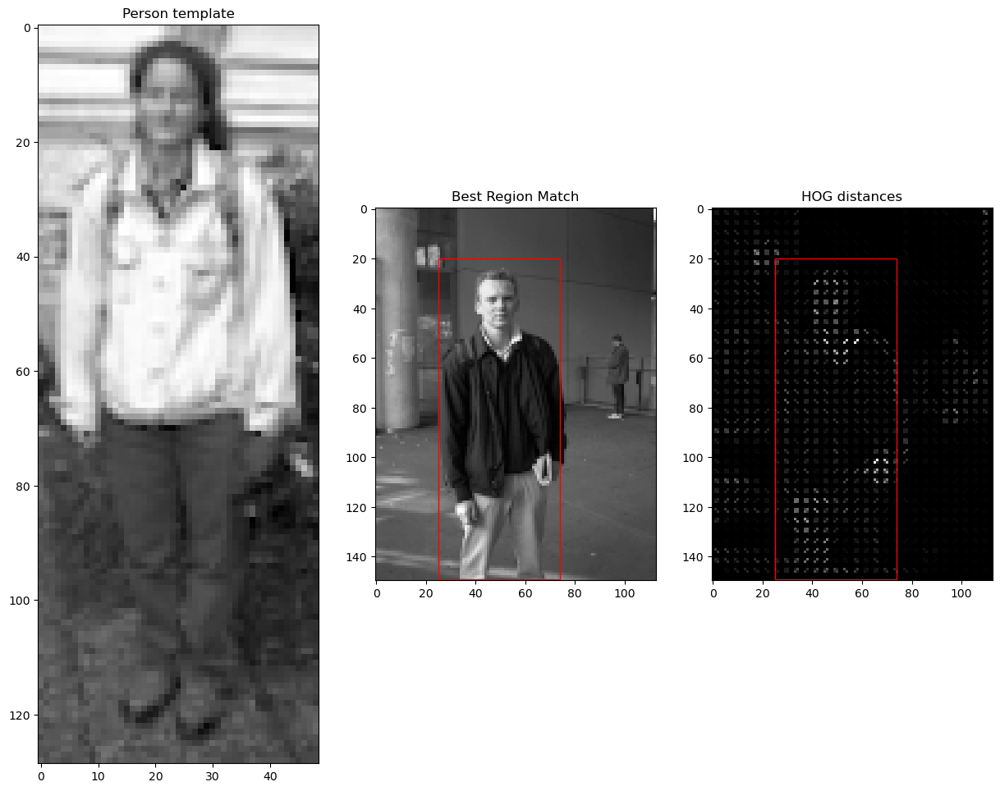

Image number:  9


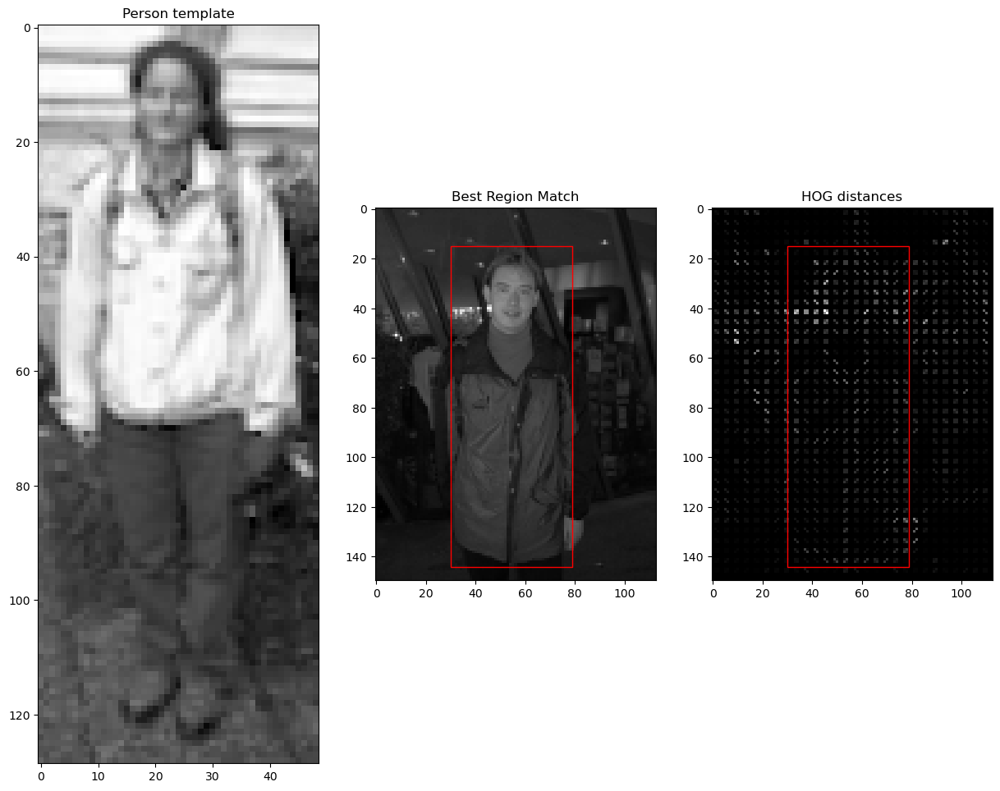

Image number:  10


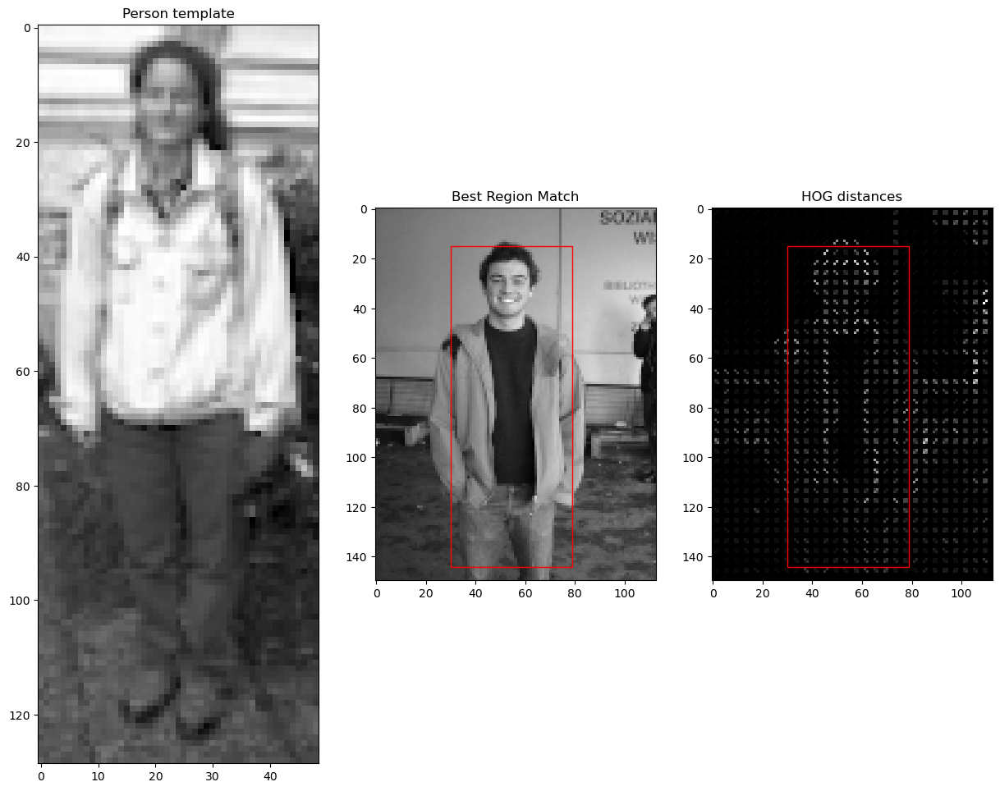

Image number:  11


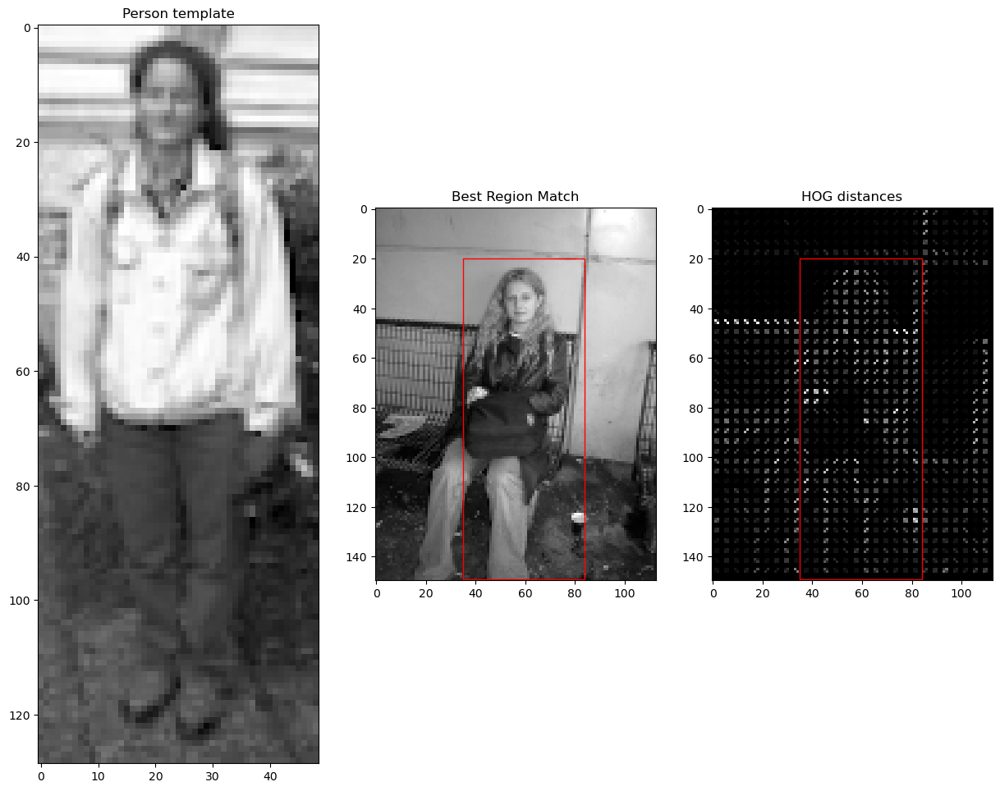

Image number:  12


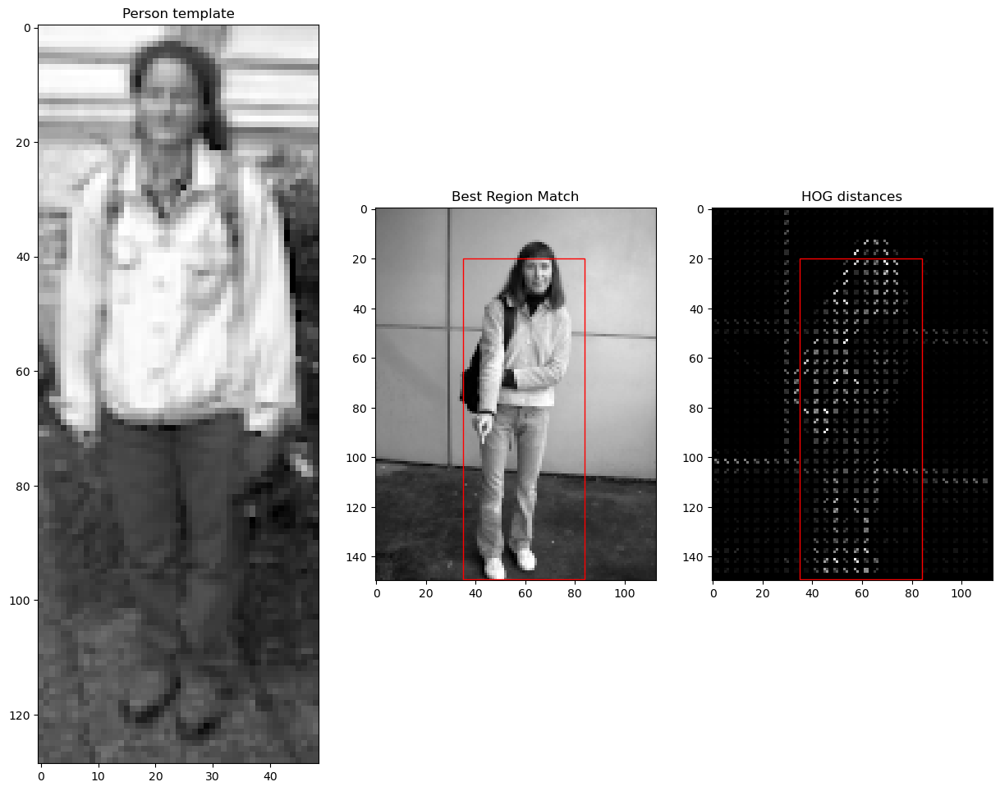

Image number:  13


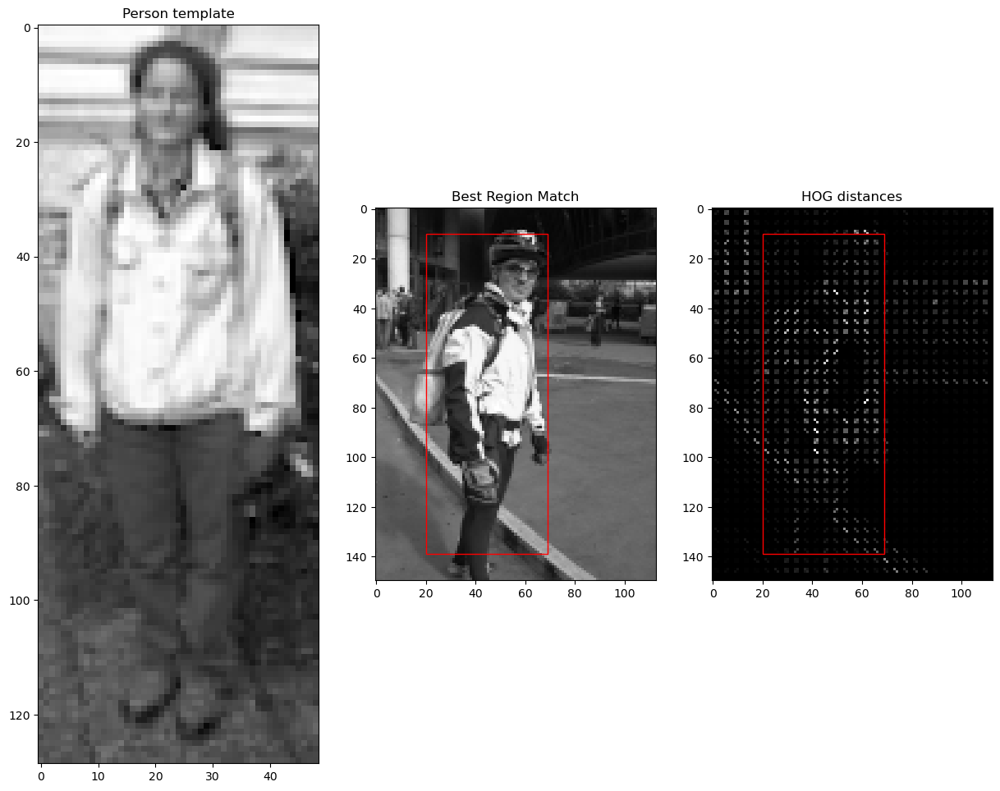

Image number:  14


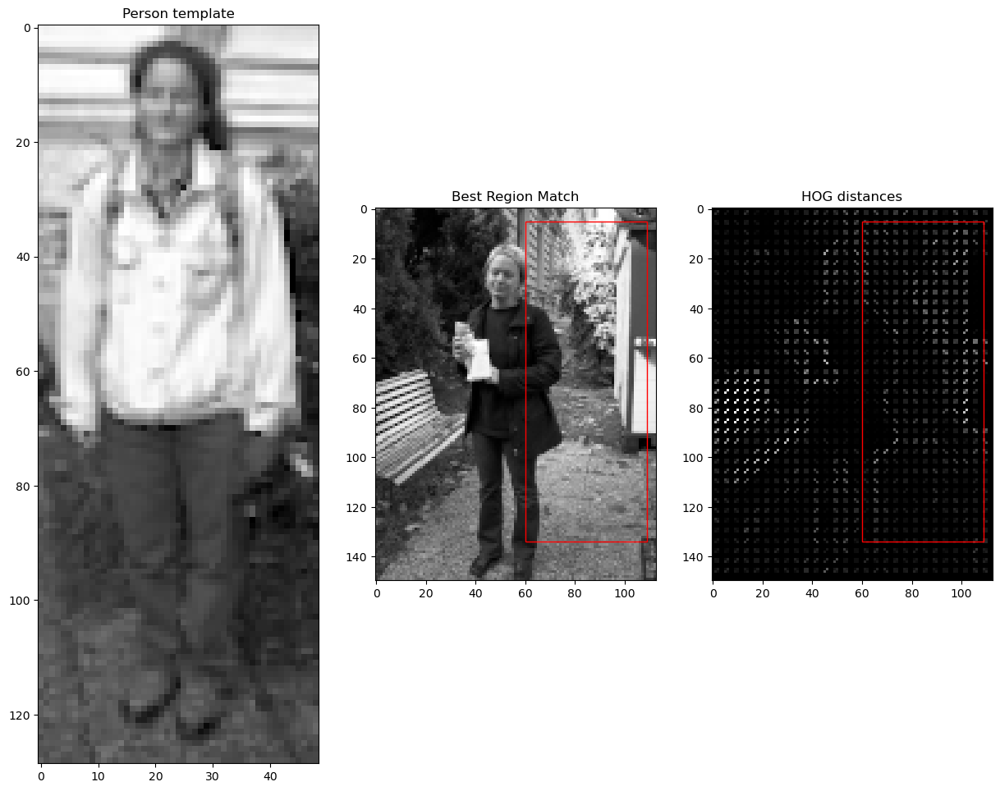

In [18]:
# Your solution here

# Load and process images
ic = io.ImageCollection('./images/TestPersonImages/*.bmp')
person = io.imread('./images/person_template.bmp')
person_gray = to_grayscale(person)

# Apply comparison for each image in the collection
for i, im in enumerate(ic):
    print("Image number: ", i)
    compare(person_gray, to_grayscale(im), orientations=8, pixels_per_cell=(4, 4),
                    cells_per_block=(3, 3))

Count on how many images were the persons detected correctly and discuss the failures.
What do you think can be the reasons for the failures?

> The person detection algorithm correctly identified persons in 10 out of 15 images, indicating a reasonably good performance. The failures in 5 images can be attributed to:

    1. Occlusions and Obstructions: Parts of the person being obscured by objects or other elements in the image, leading to missed detections.

    2. Variability in Appearance: Differences in clothing, pose, or size between the people in the images and the template, affecting the accuracy.

    3. Background Interference: Complex backgrounds or varying environmental conditions (like lighting) altering the visual features, causing incorrect detections.

    4. Parameter Sensitivity: The HOG descriptor and sliding window parameters might not be optimal for all scenarios, affecting detection performance.

> Improving the algorithm could involve using a more diverse set of templates, adjusting HOG and sliding window parameters, and potentially incorporating more advanced techniques like convolutional neural networks for better handling of variability and occlusions.

Test several values of the parameters (``orientations``, ``pixels_per_cell``, ``cells_per_block``) to show which are the optimal values for the person detection problem. Note: since you are testing several values and not the whole universe, this question might have different solutions, make sure to try several to at least be directionally correct

**Insights after testing different parameters**

> We've experimented with various parameters, yet the issue persists, primarily due to the lack of similarity between the template and the images. For instance, in images 0 and 2, the presence of a boy and a man, whose stature is smaller compared to the pedestrian in the template, results in poor detection. Additionally, in image 5, lighting significantly influences the detection accuracy, as it causes the person to blend in with the surroundings because of the color resemblance between their attire and the background.

Image number:  0 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


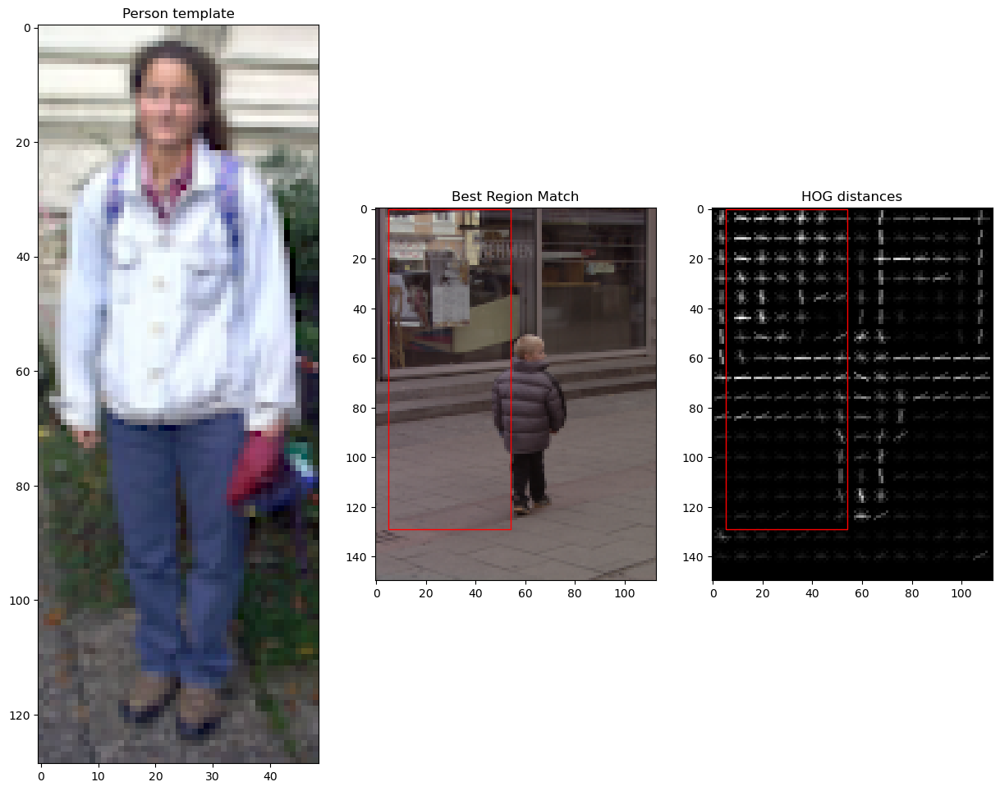

Image number:  0 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


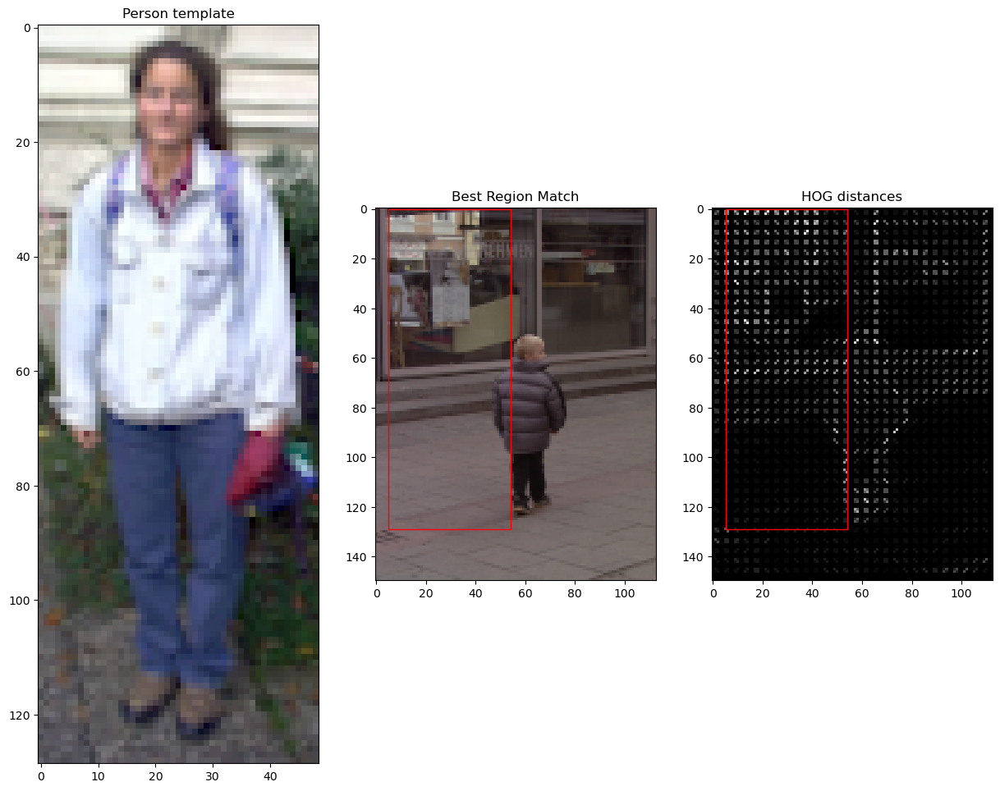

Image number:  0 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


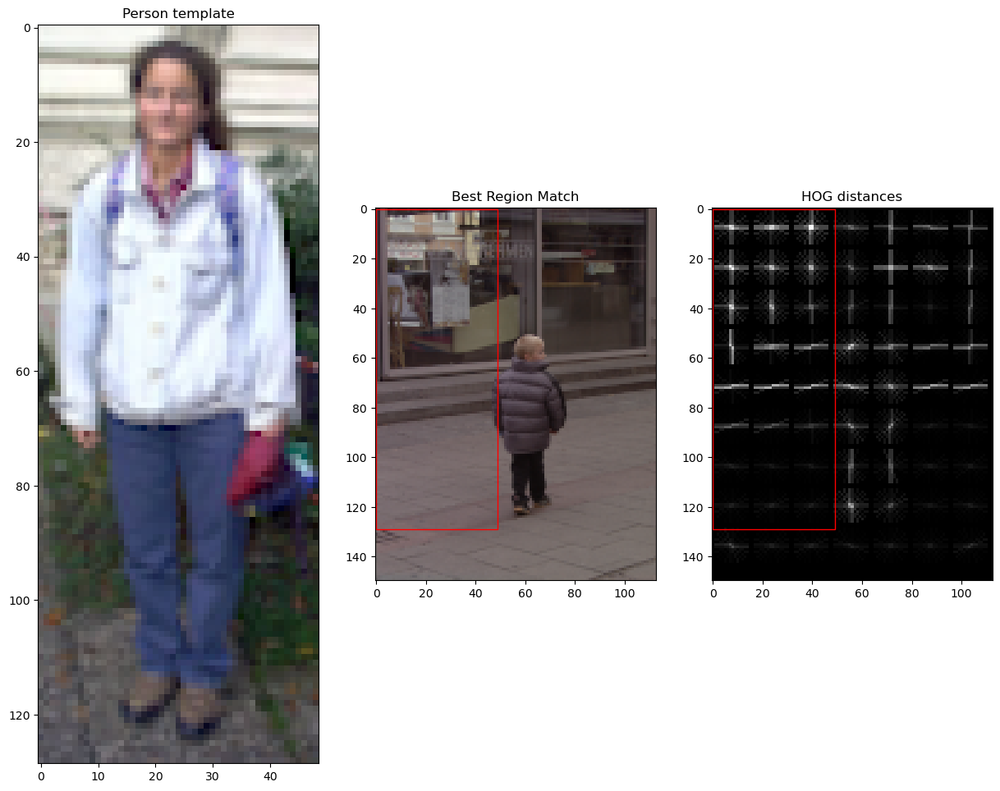

Image number:  1 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


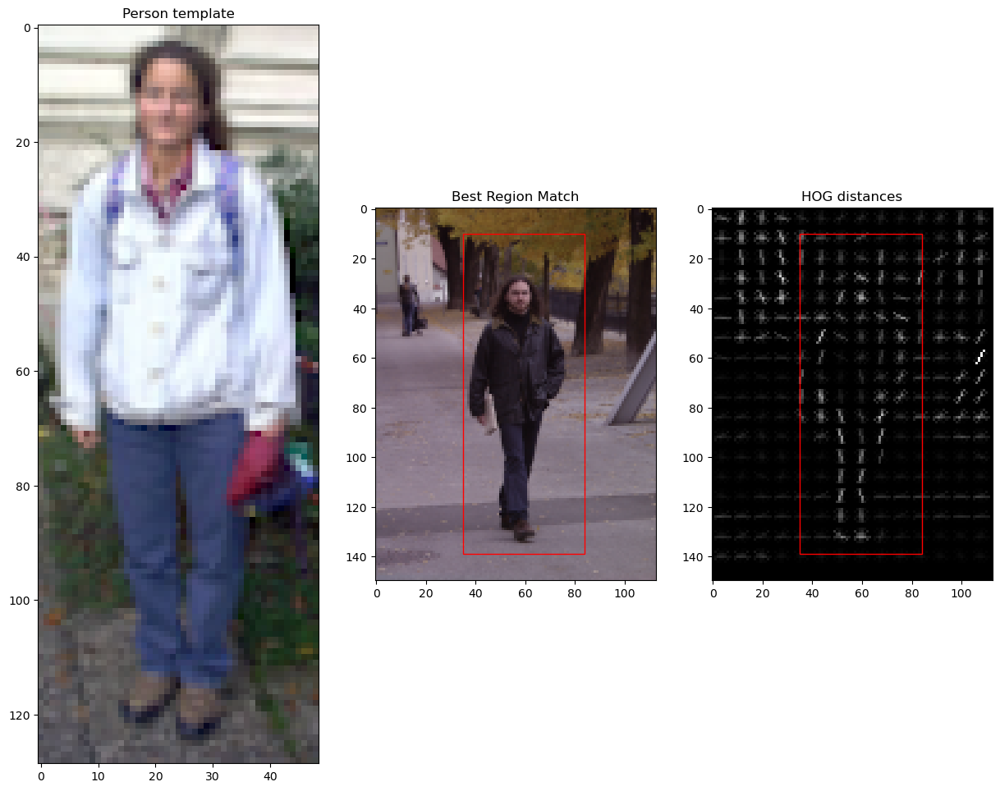

Image number:  1 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


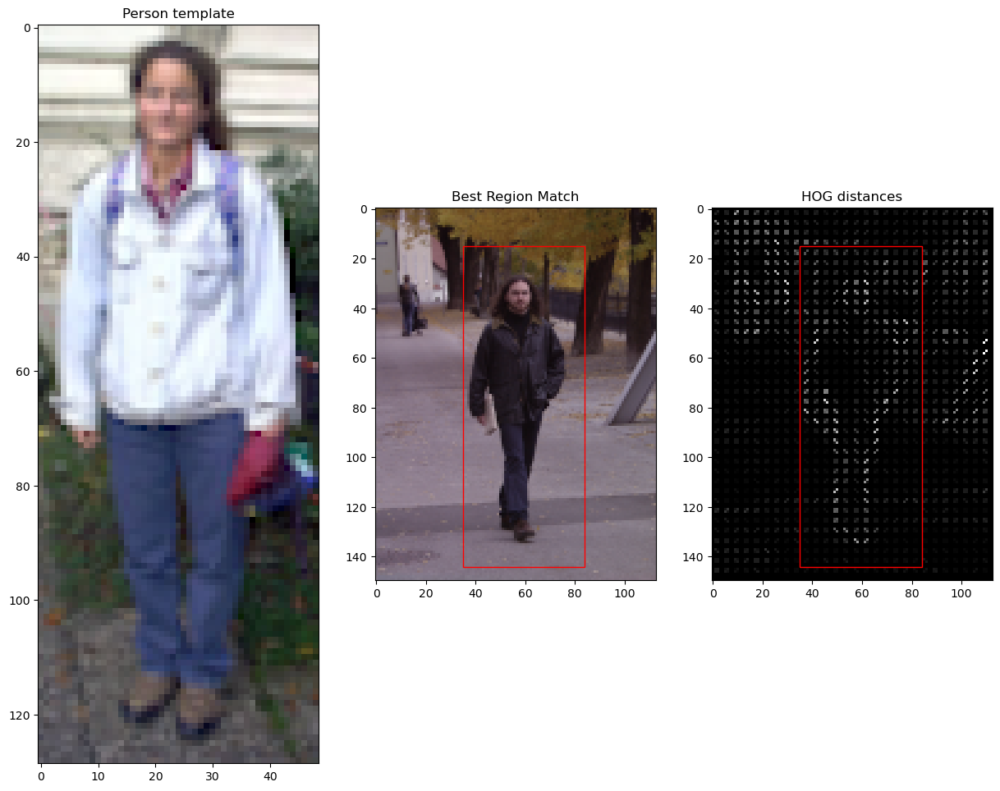

Image number:  1 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


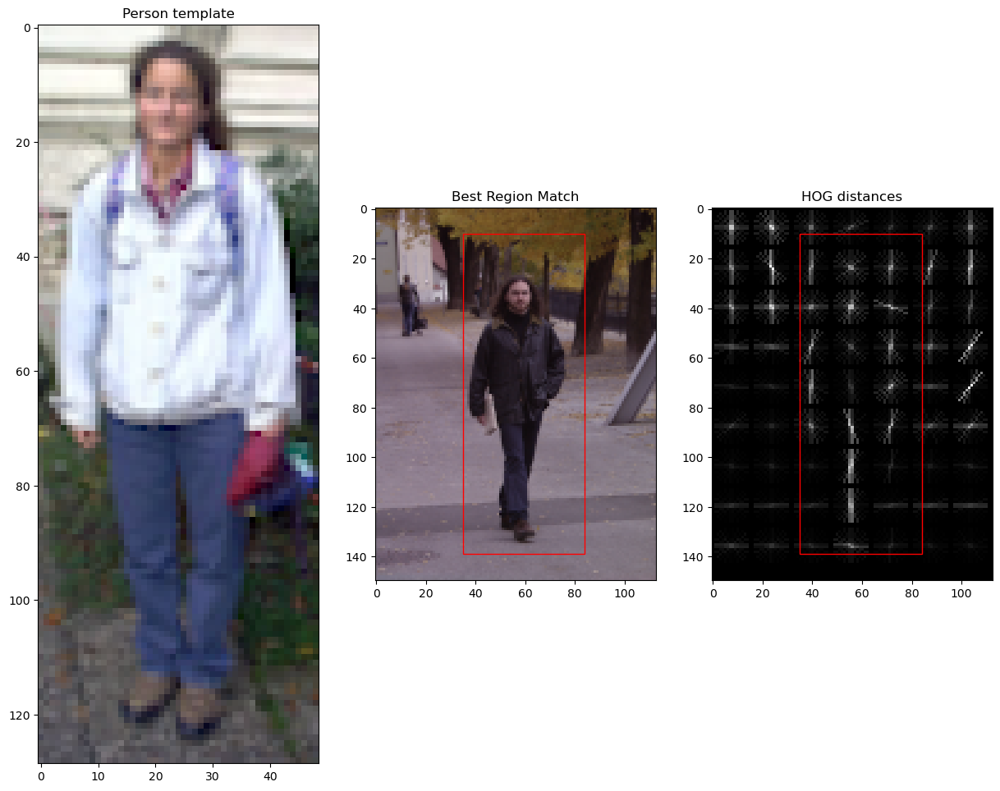

Image number:  2 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


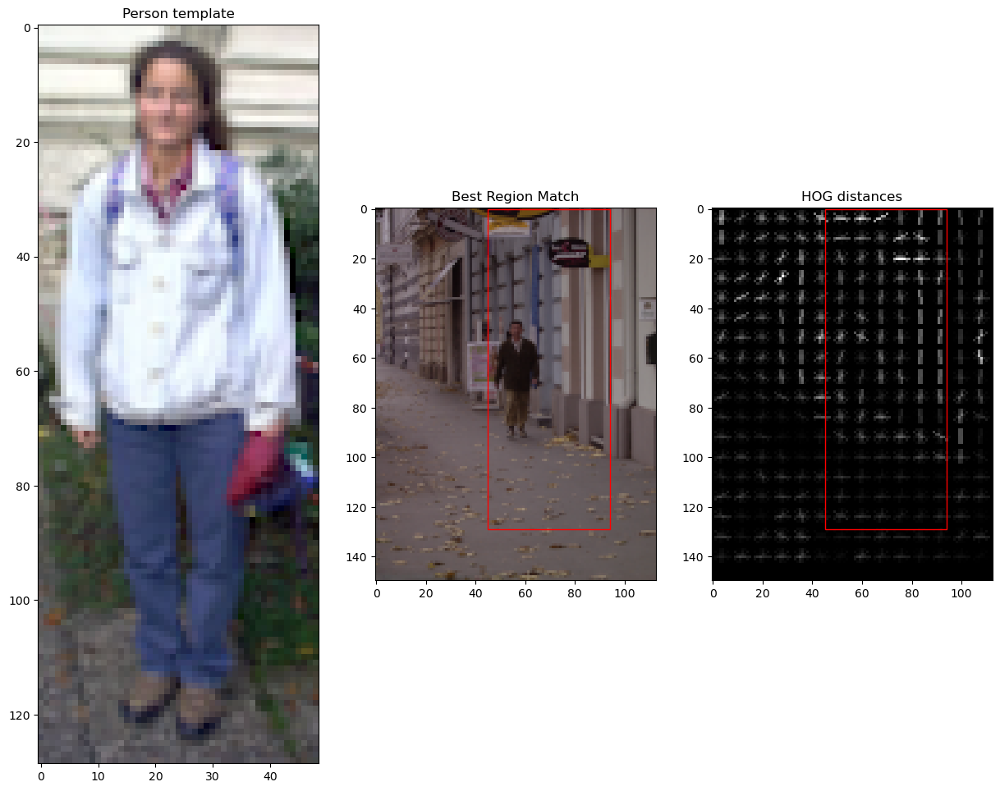

Image number:  2 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


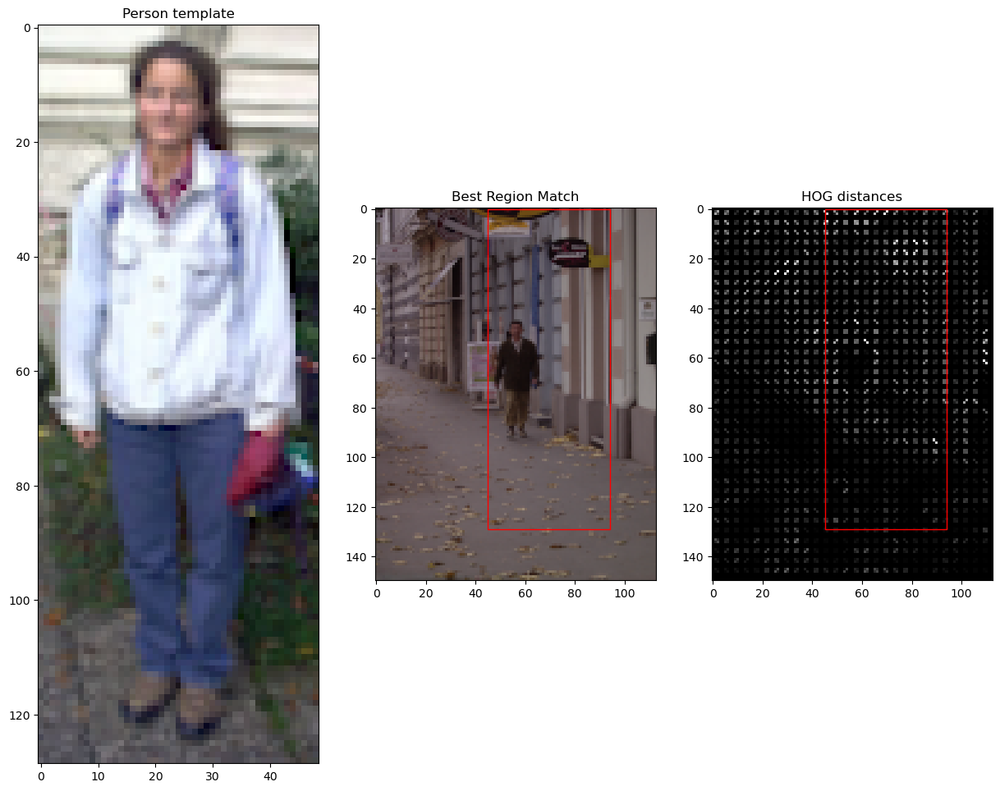

Image number:  2 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


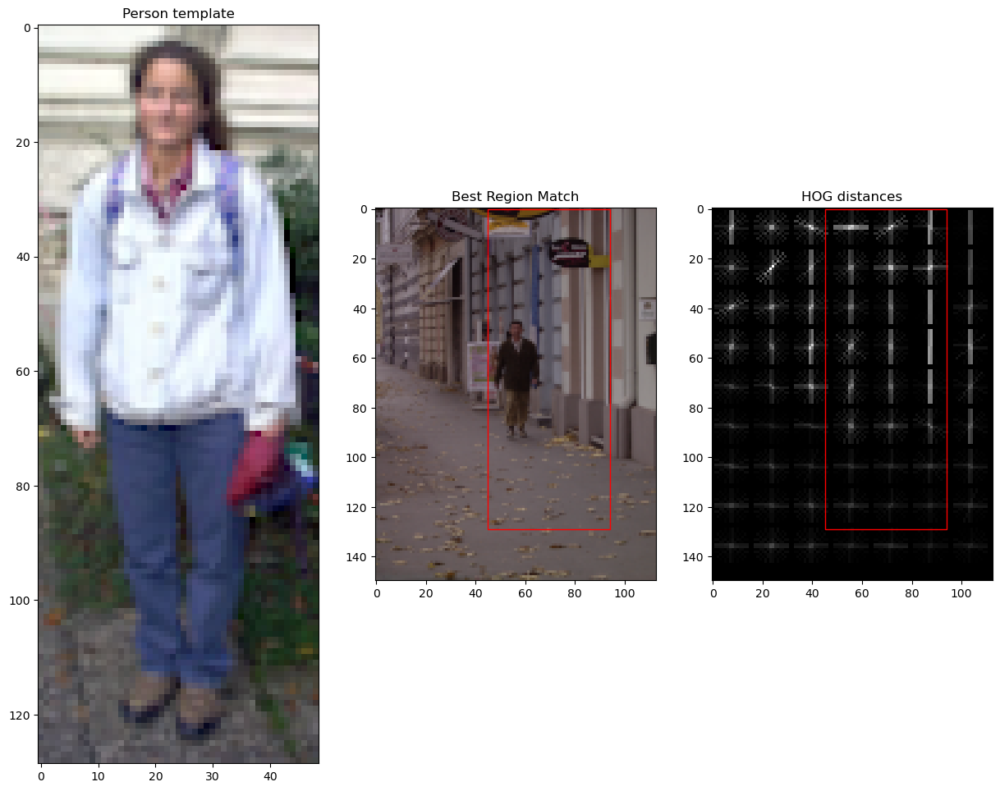

Image number:  3 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


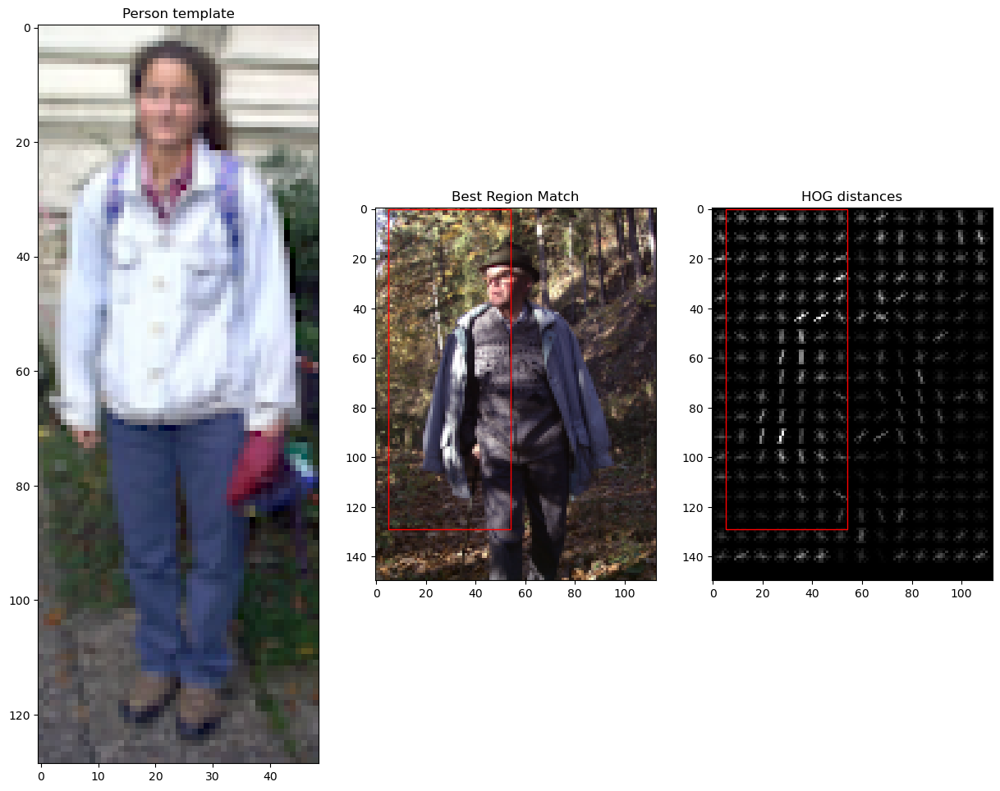

Image number:  3 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


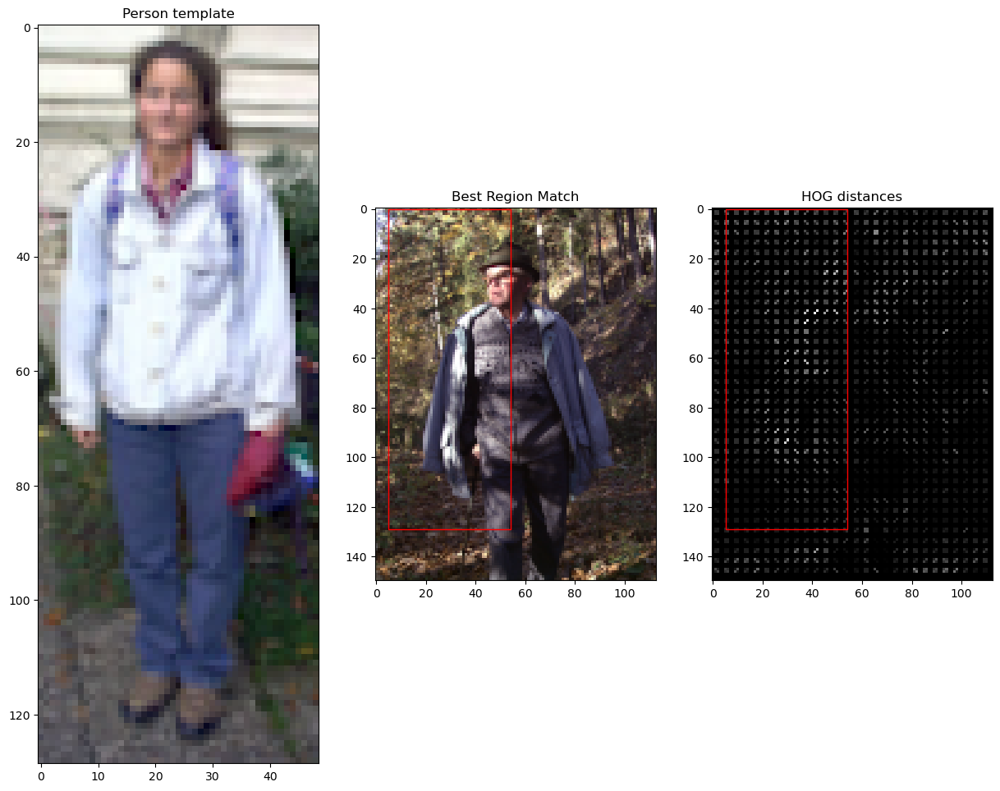

Image number:  3 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


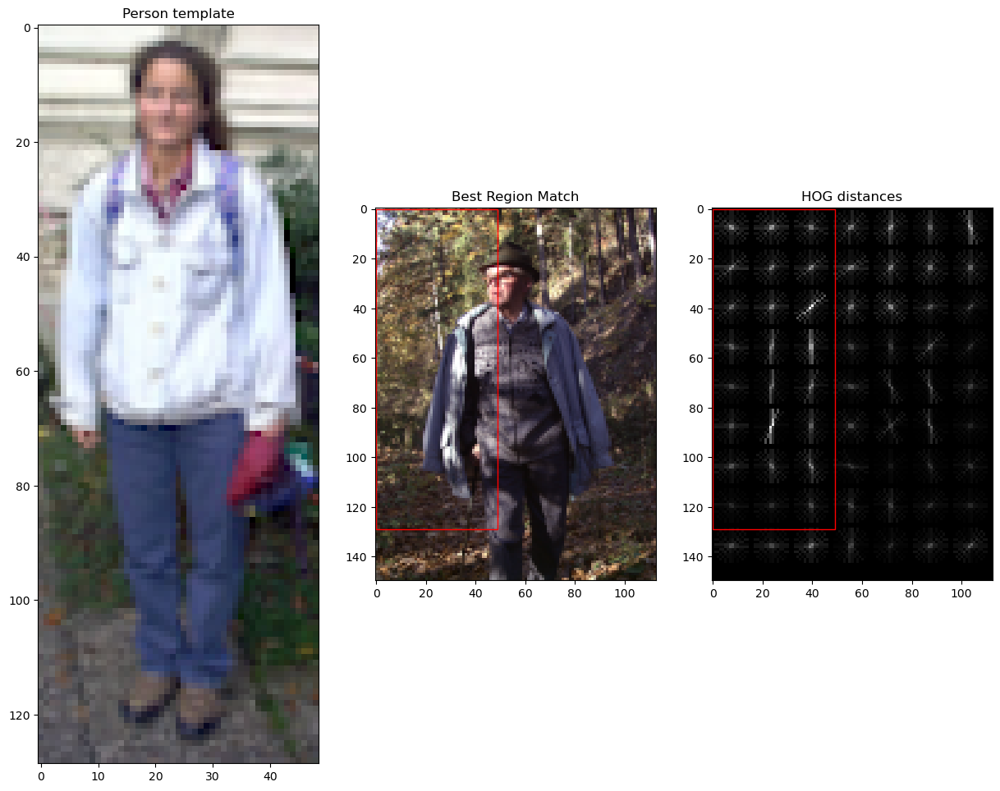

Image number:  4 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


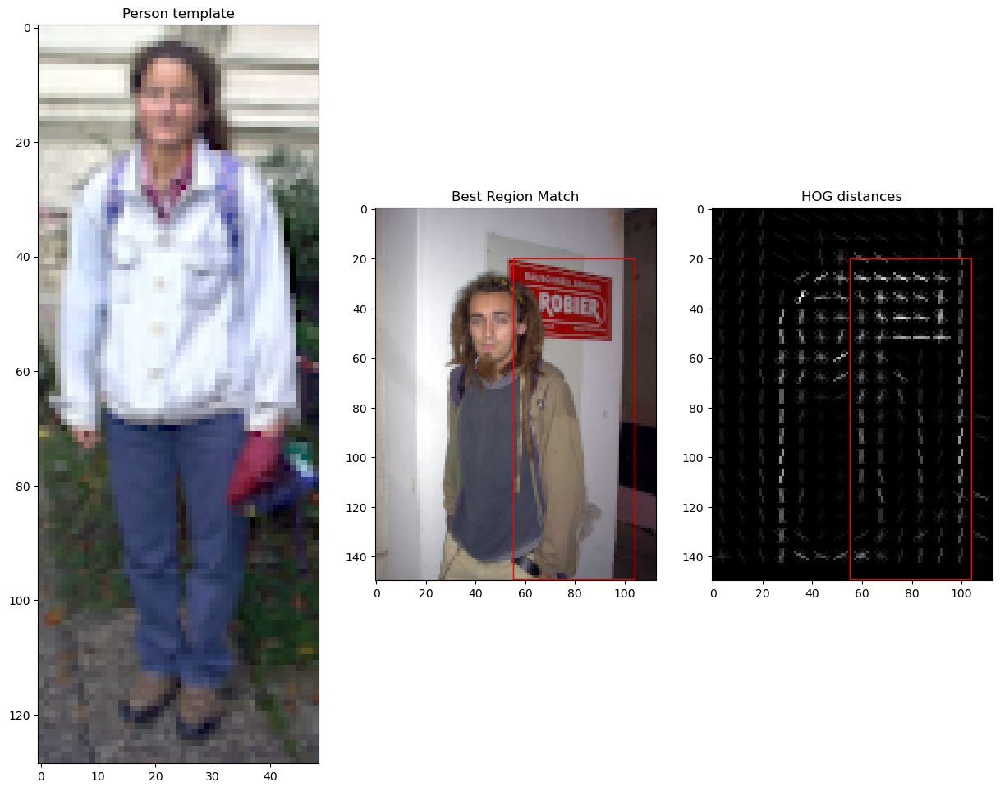

Image number:  4 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


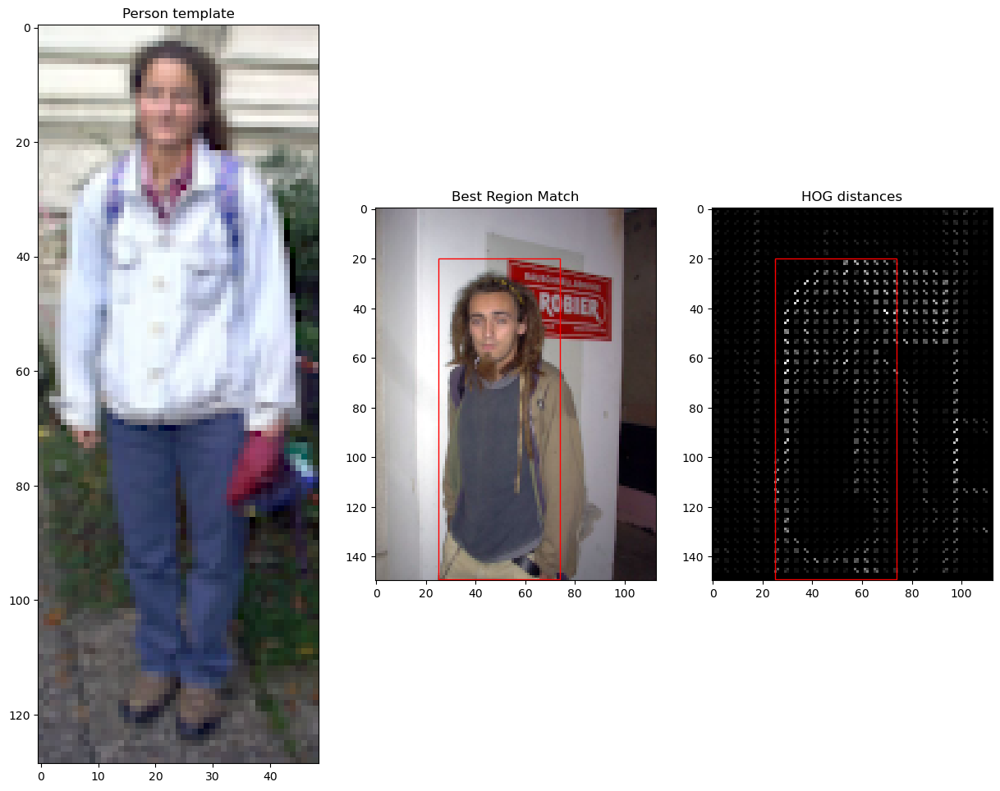

Image number:  4 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


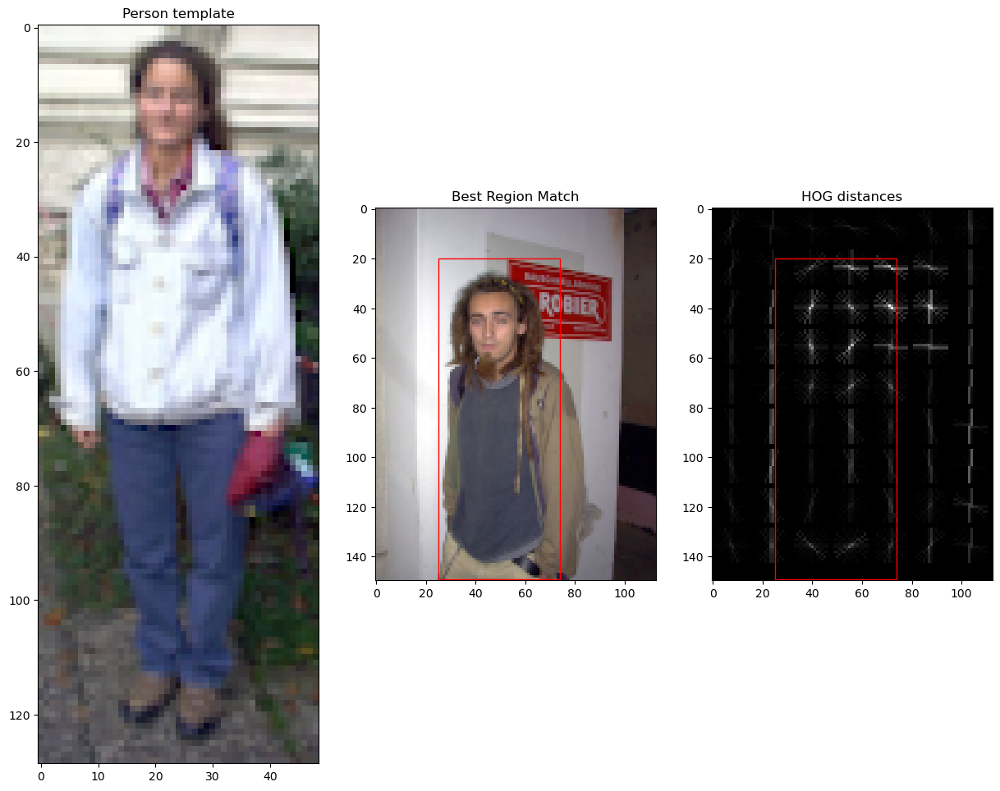

Image number:  5 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


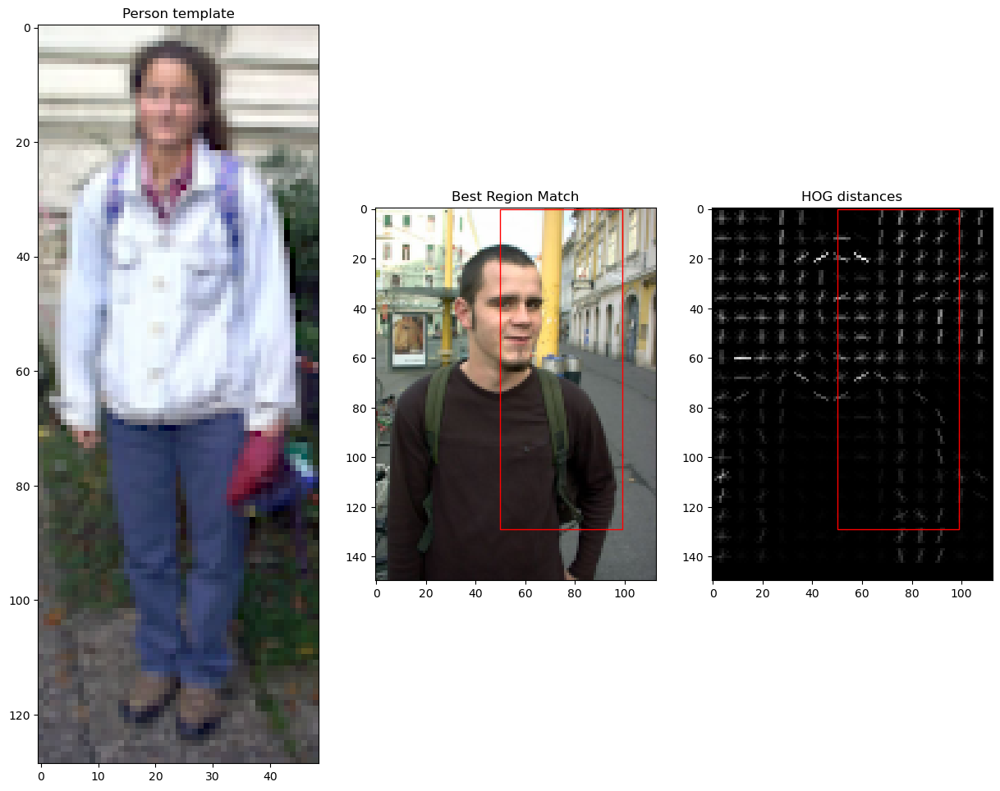

Image number:  5 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


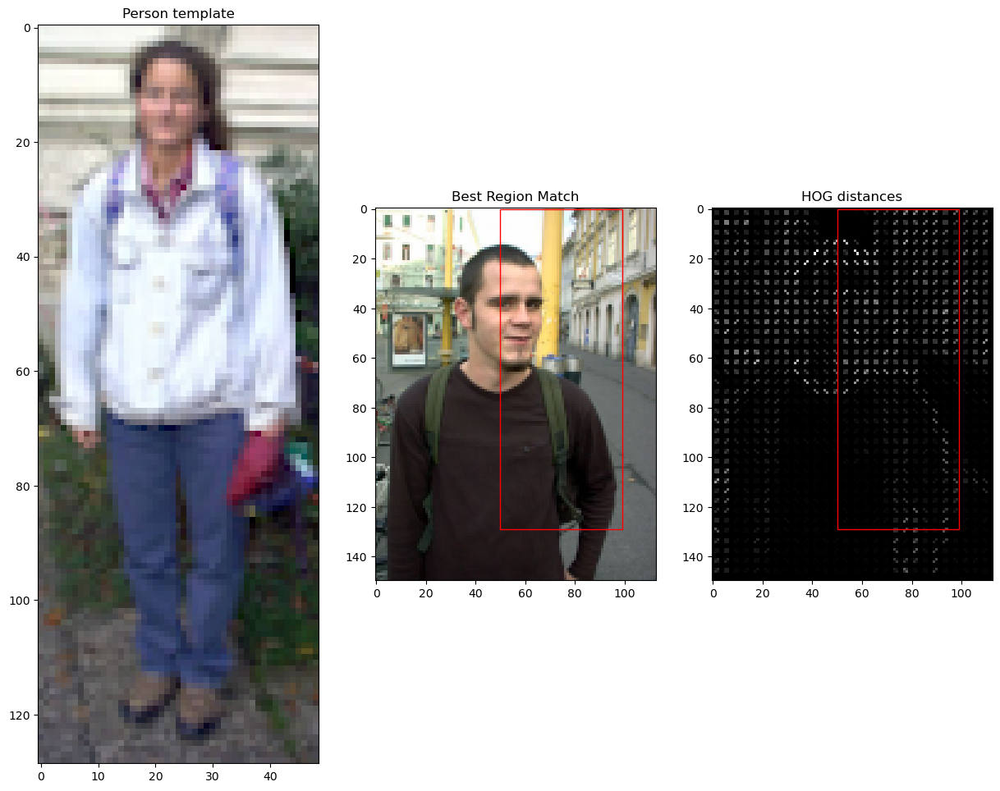

Image number:  5 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


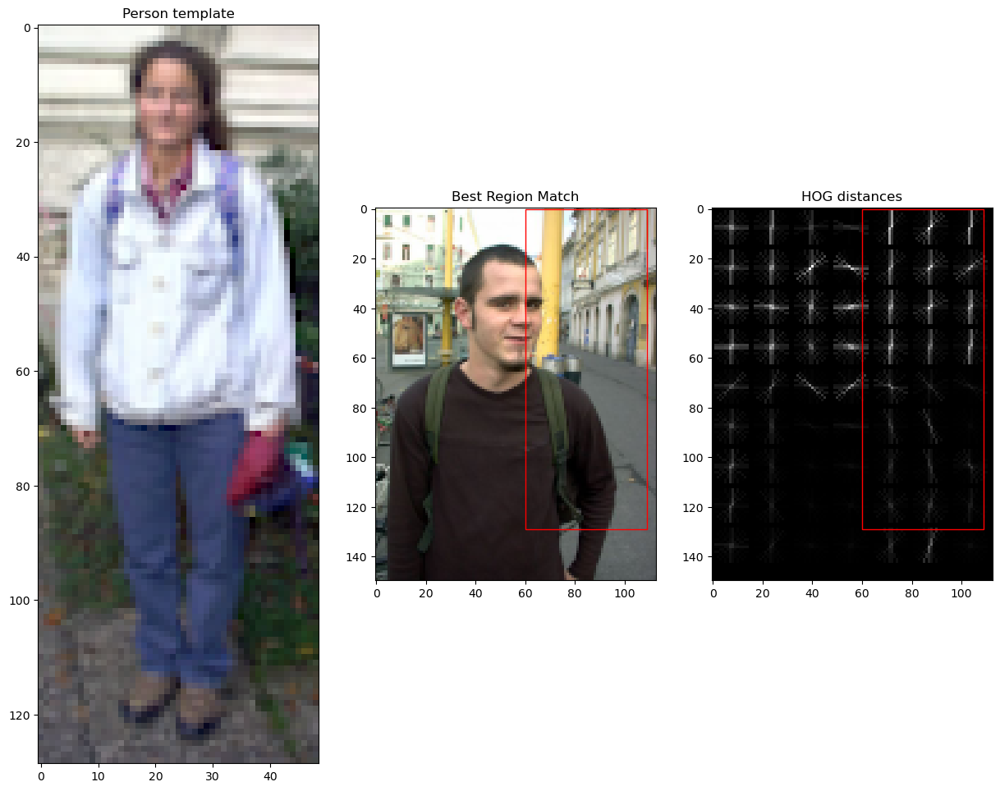

Image number:  6 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


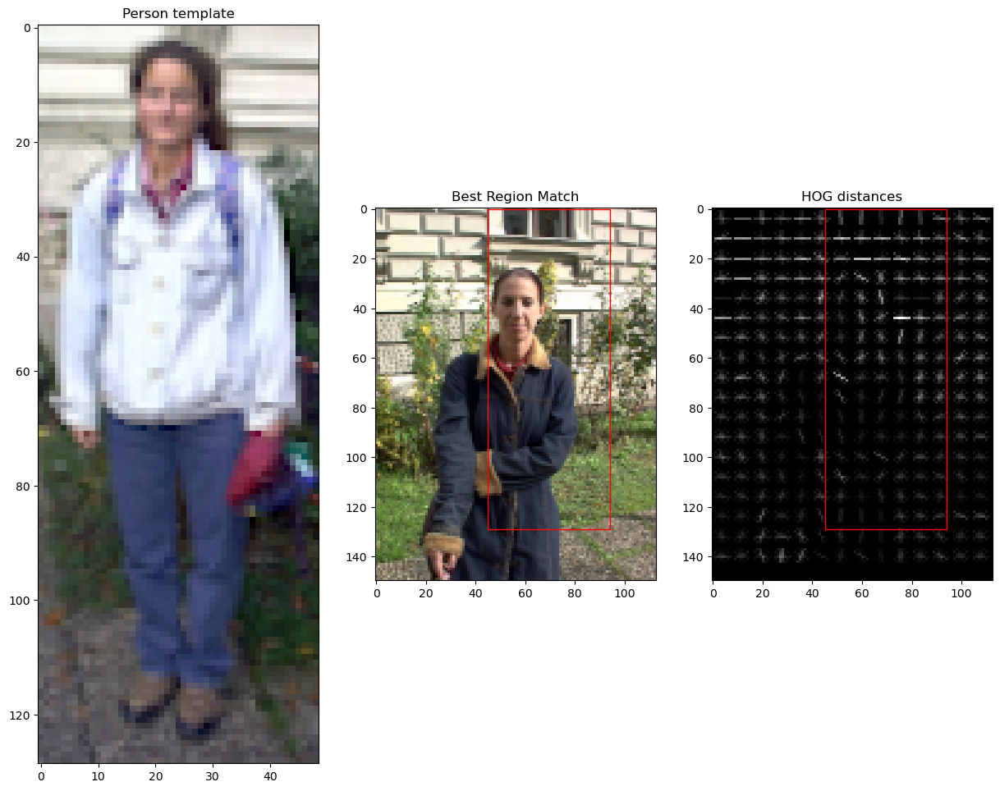

Image number:  6 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


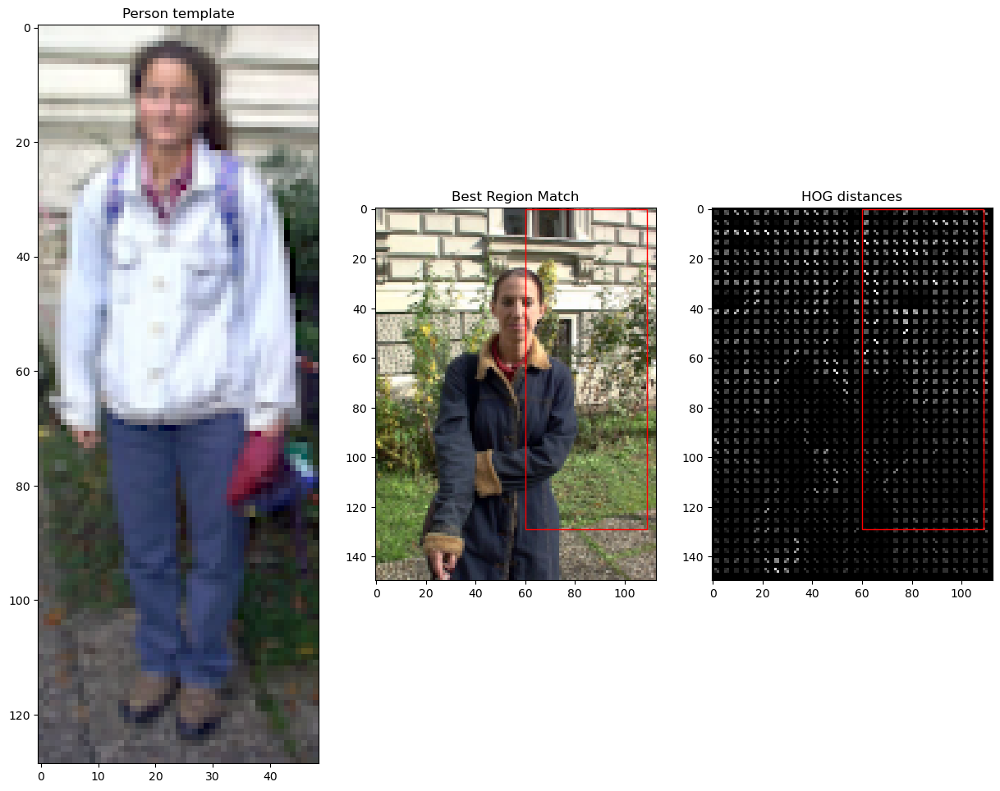

Image number:  6 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


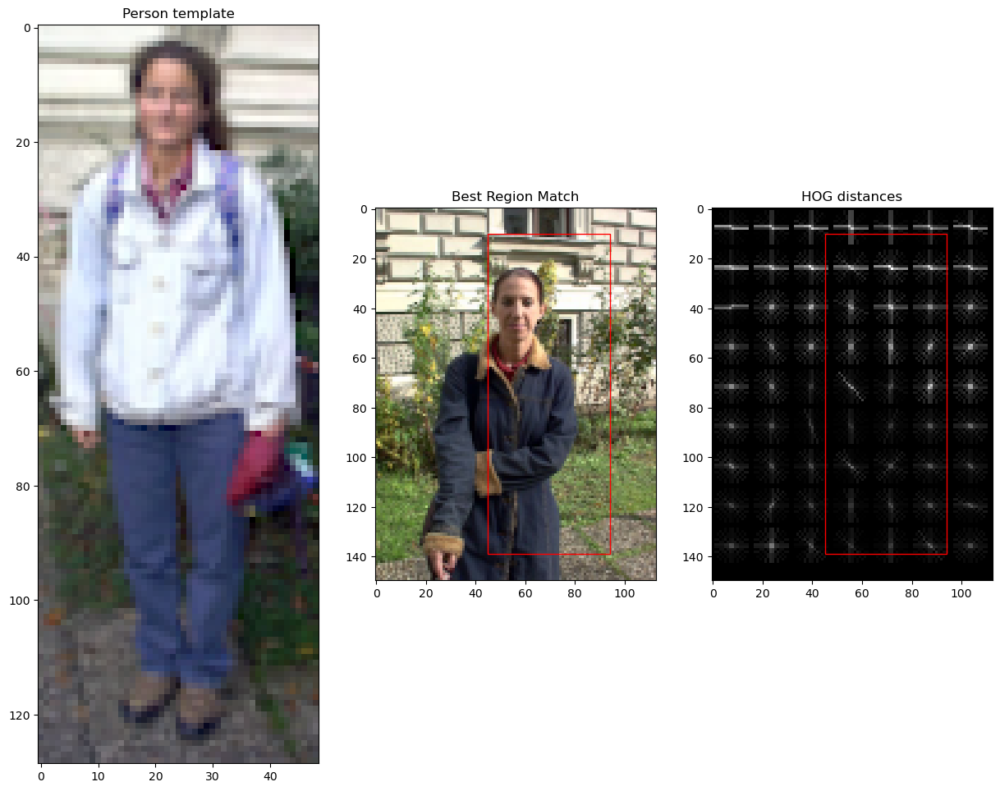

Image number:  7 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


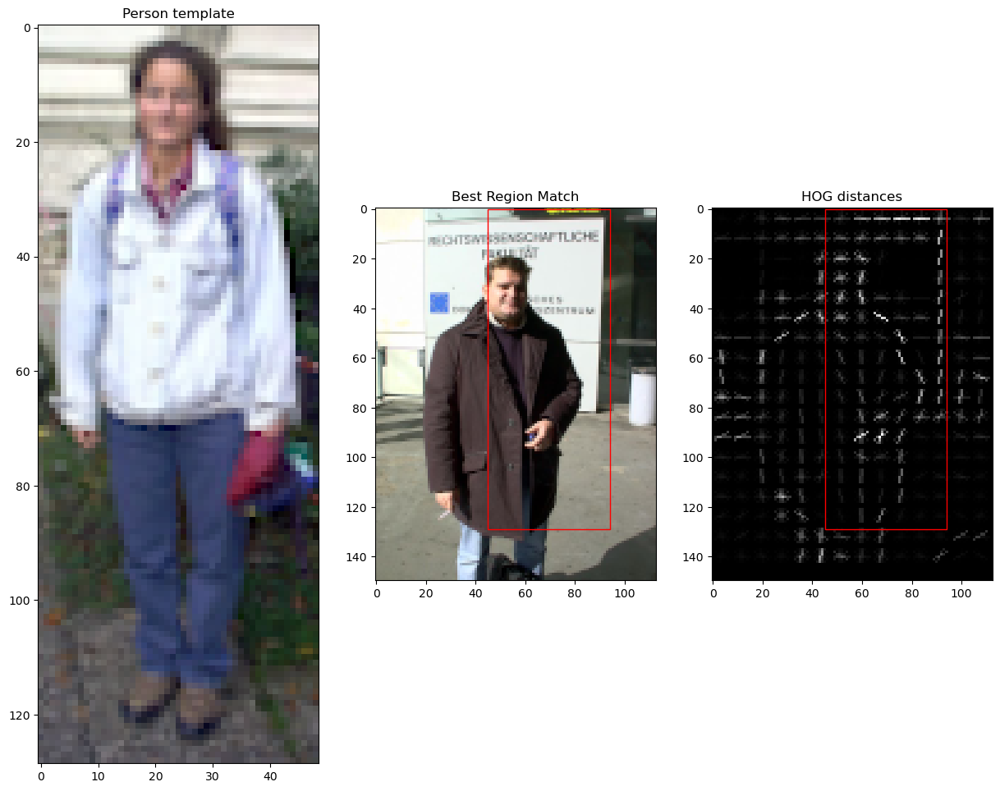

Image number:  7 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


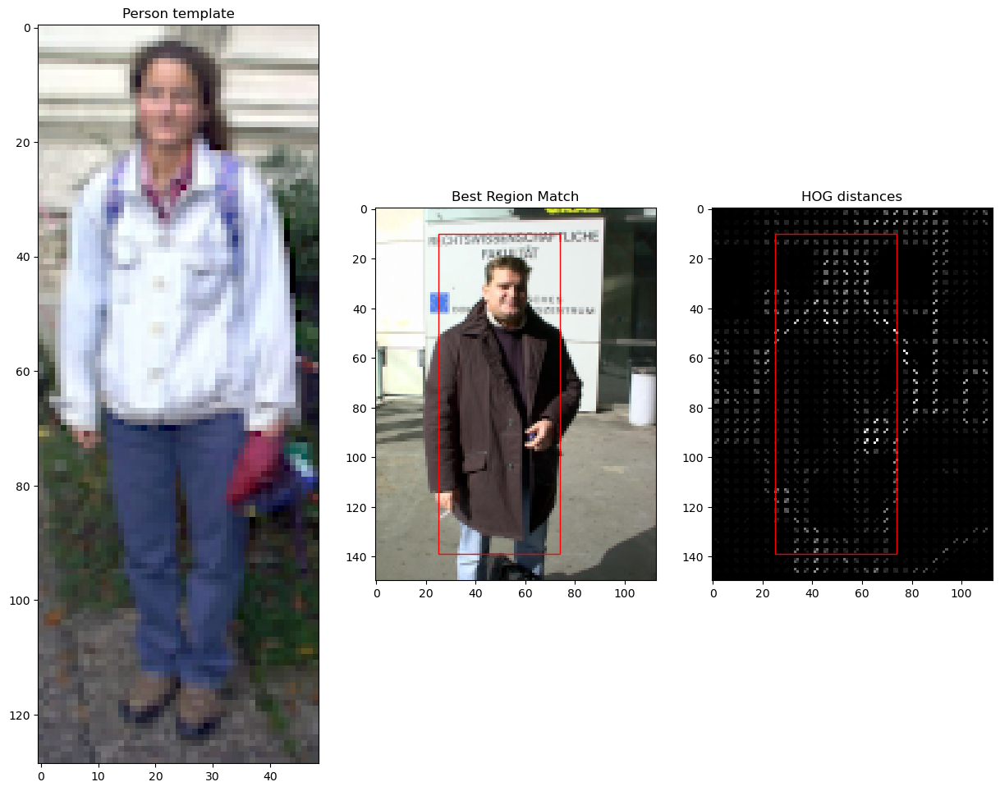

Image number:  7 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


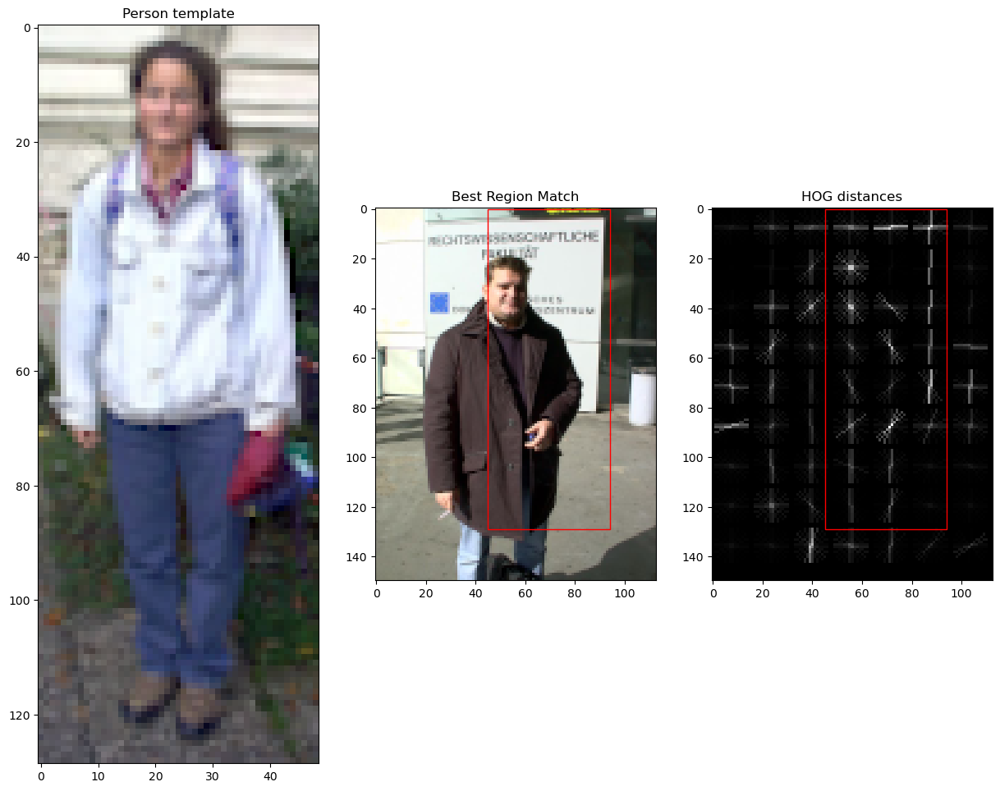

Image number:  8 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


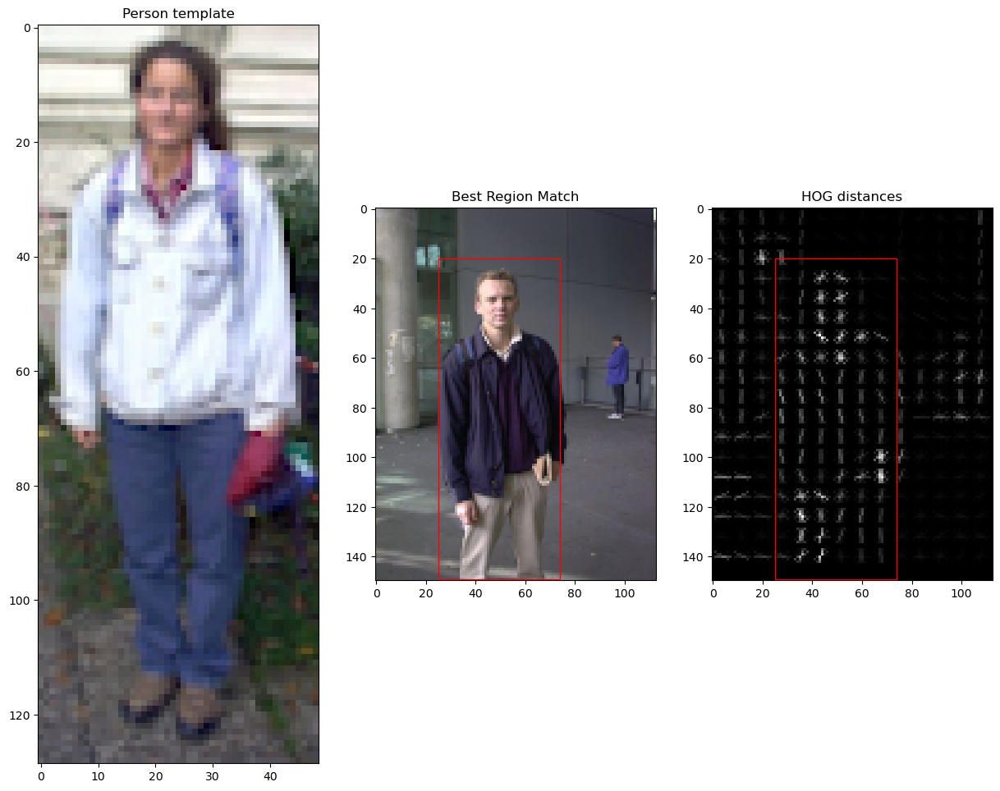

Image number:  8 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


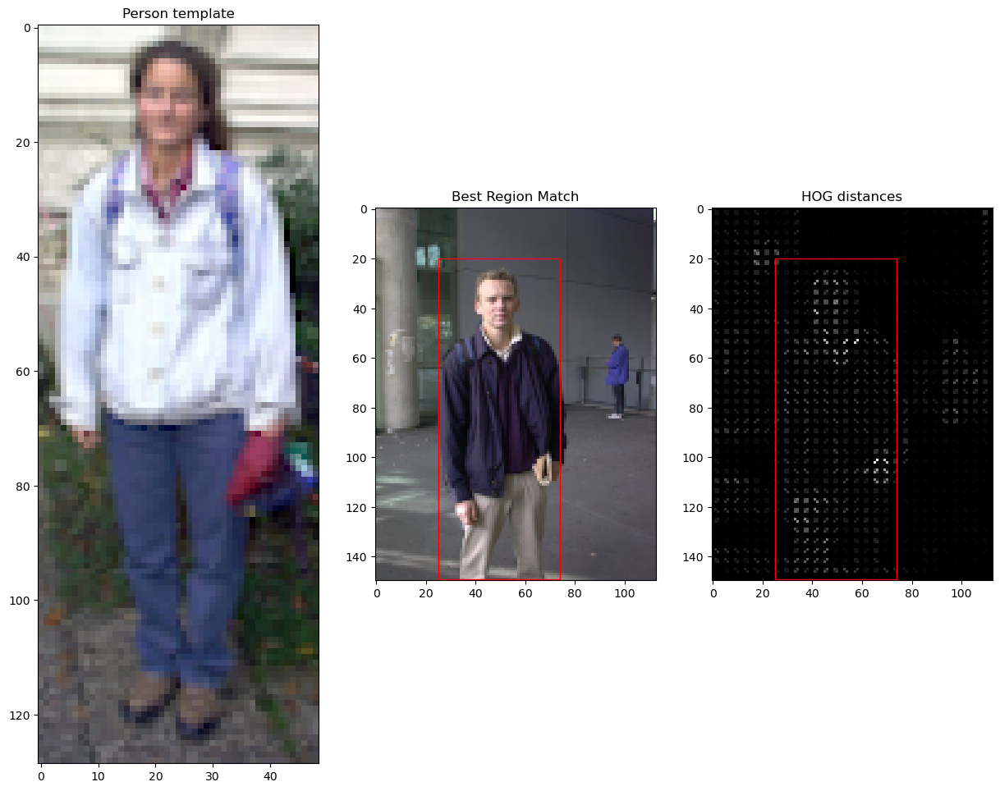

Image number:  8 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


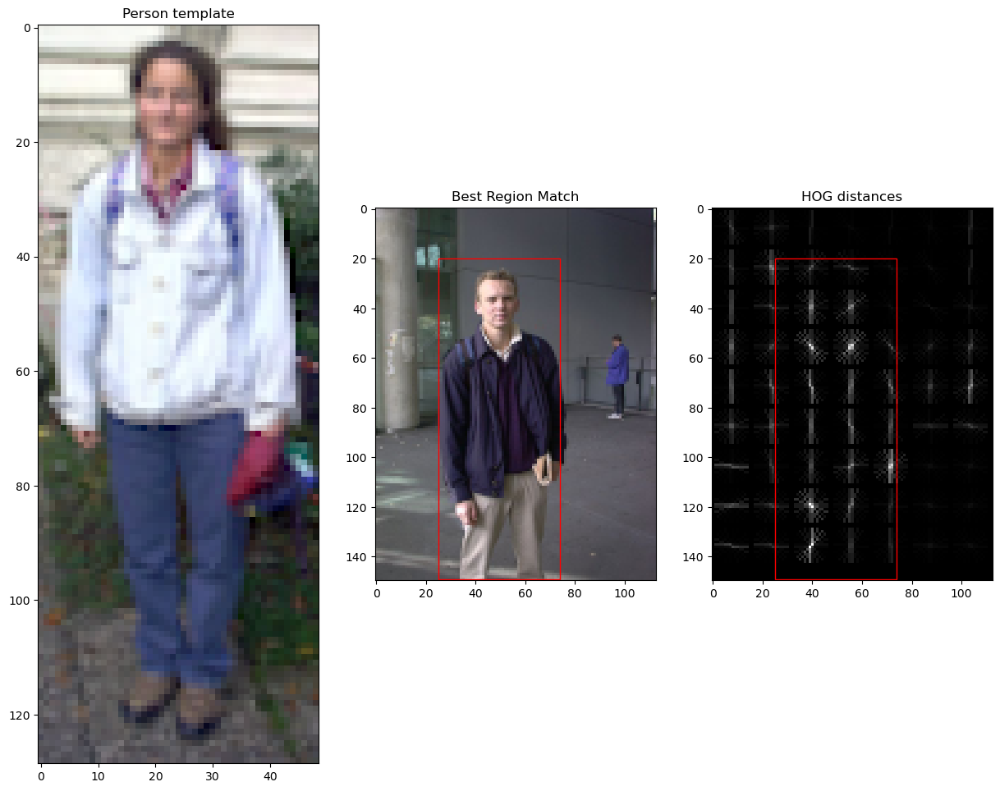

Image number:  9 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


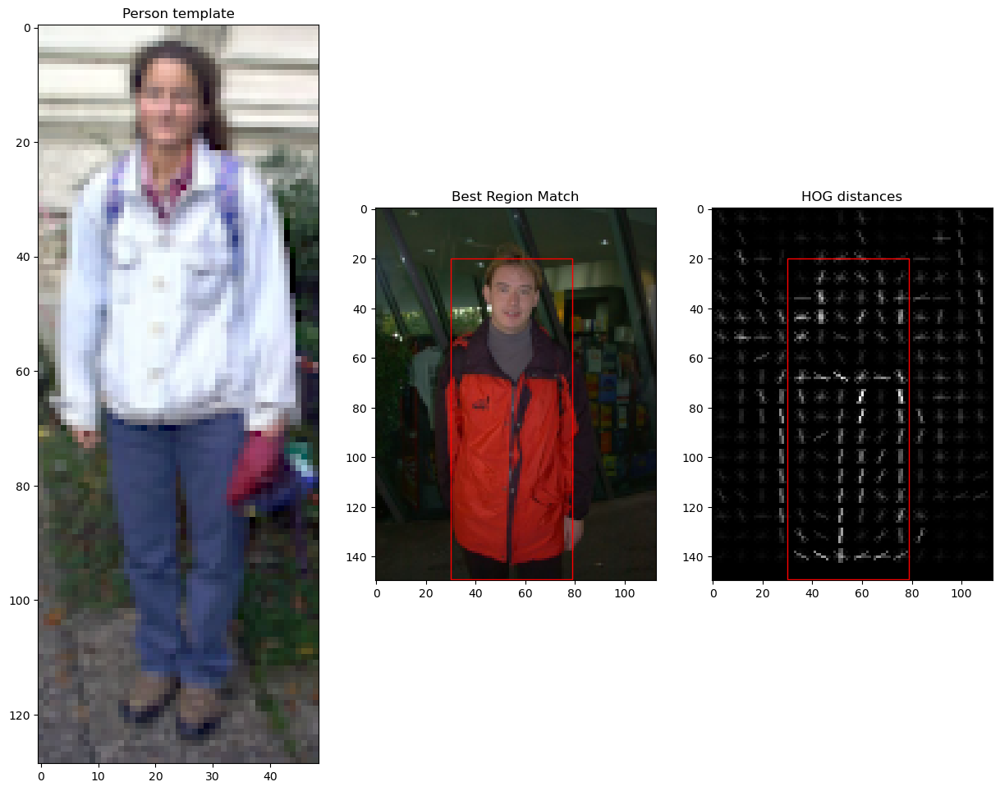

Image number:  9 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


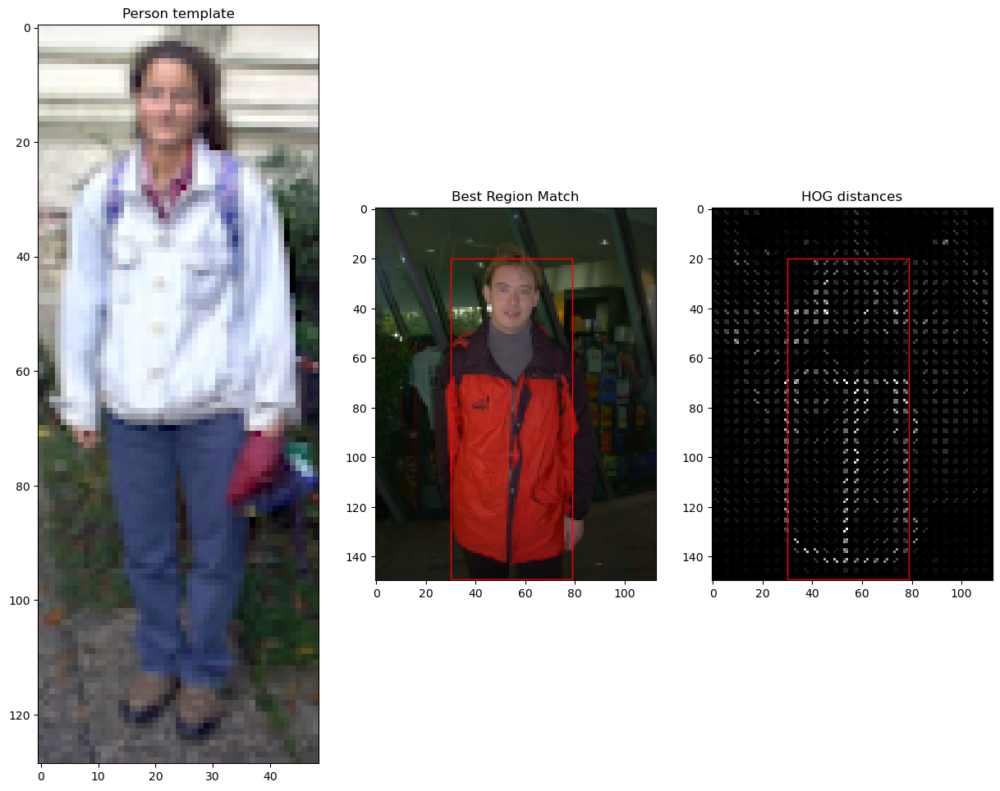

Image number:  9 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


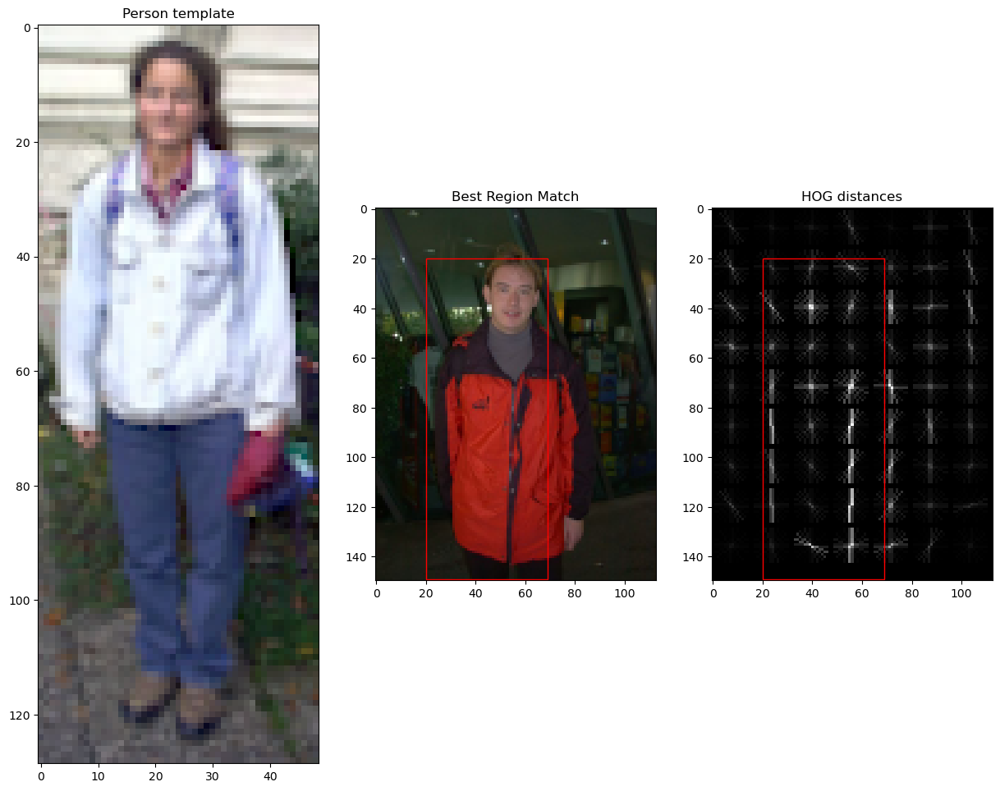

Image number:  10 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


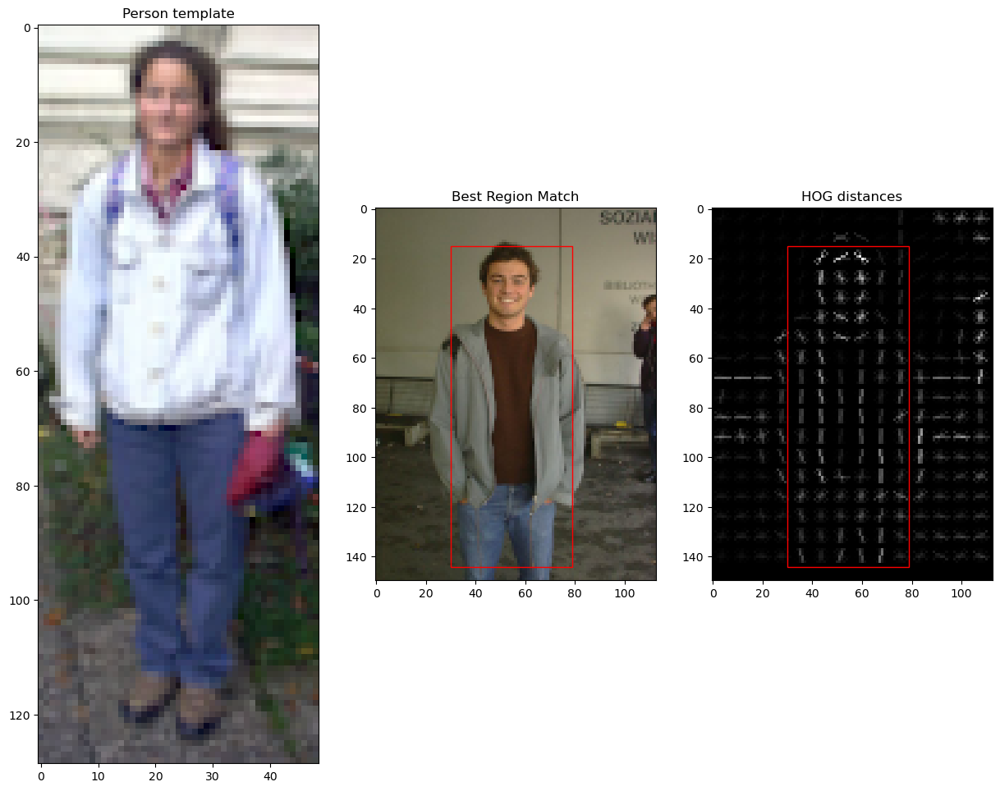

Image number:  10 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


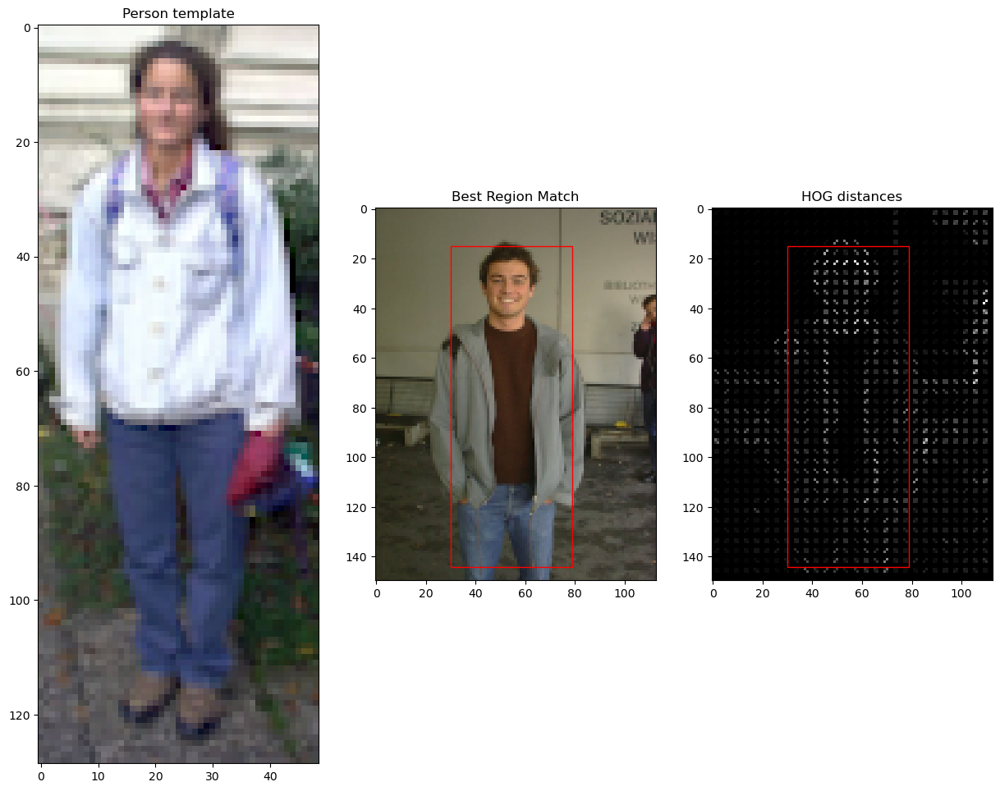

Image number:  10 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


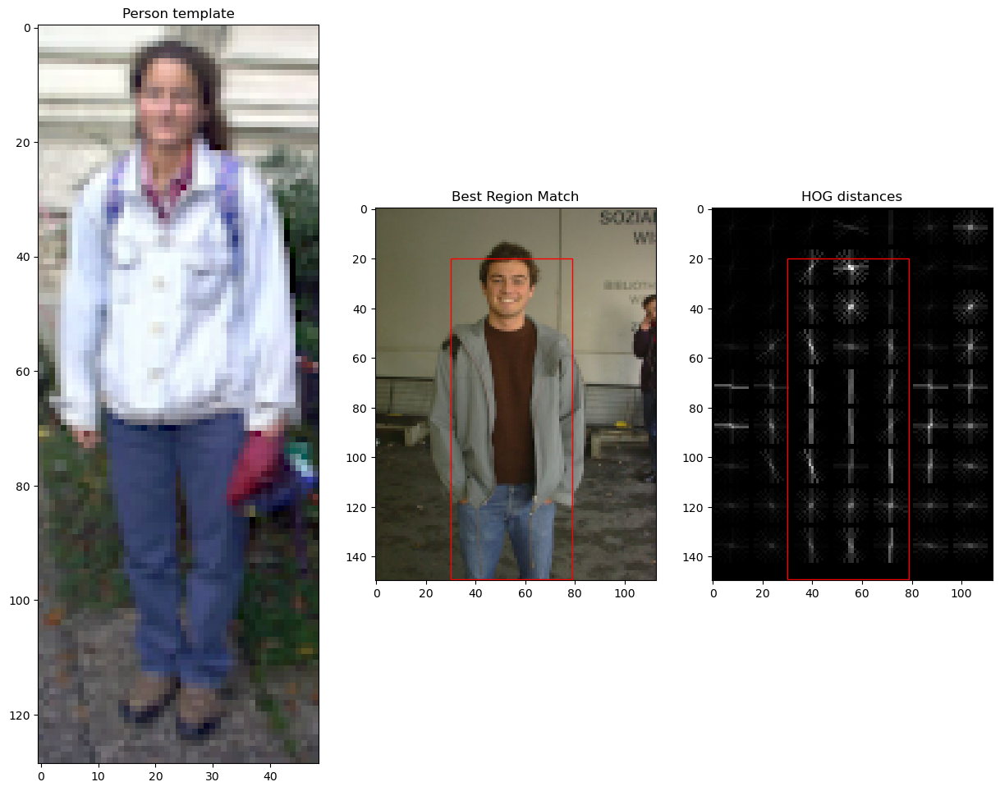

Image number:  11 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


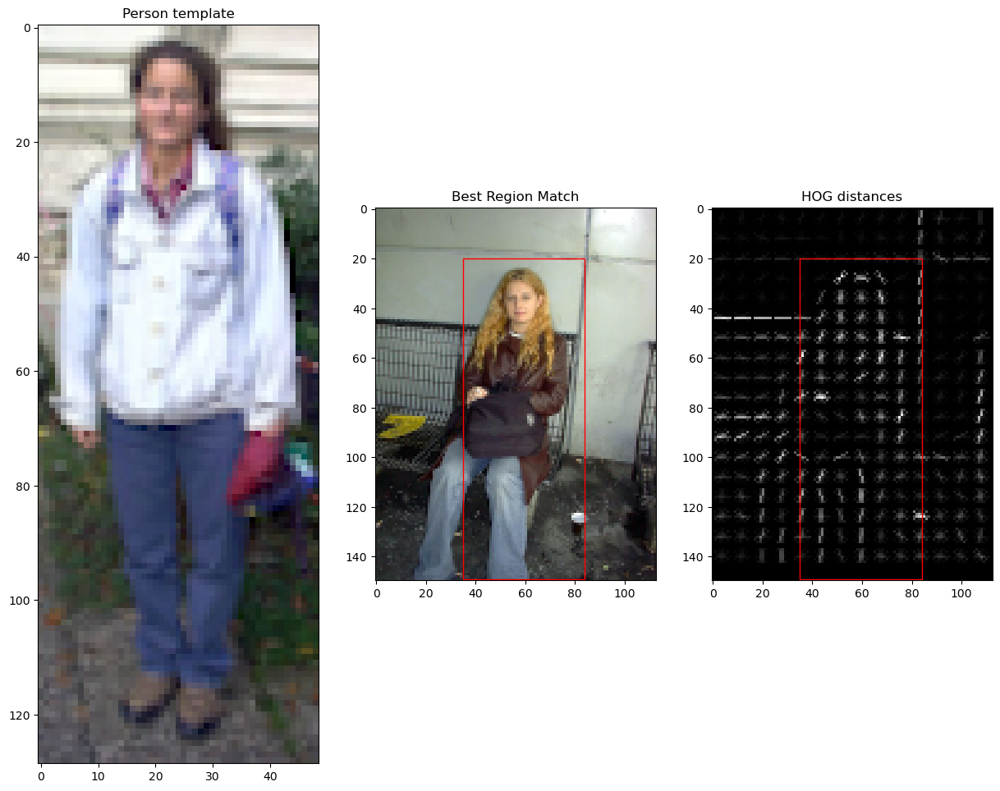

Image number:  11 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


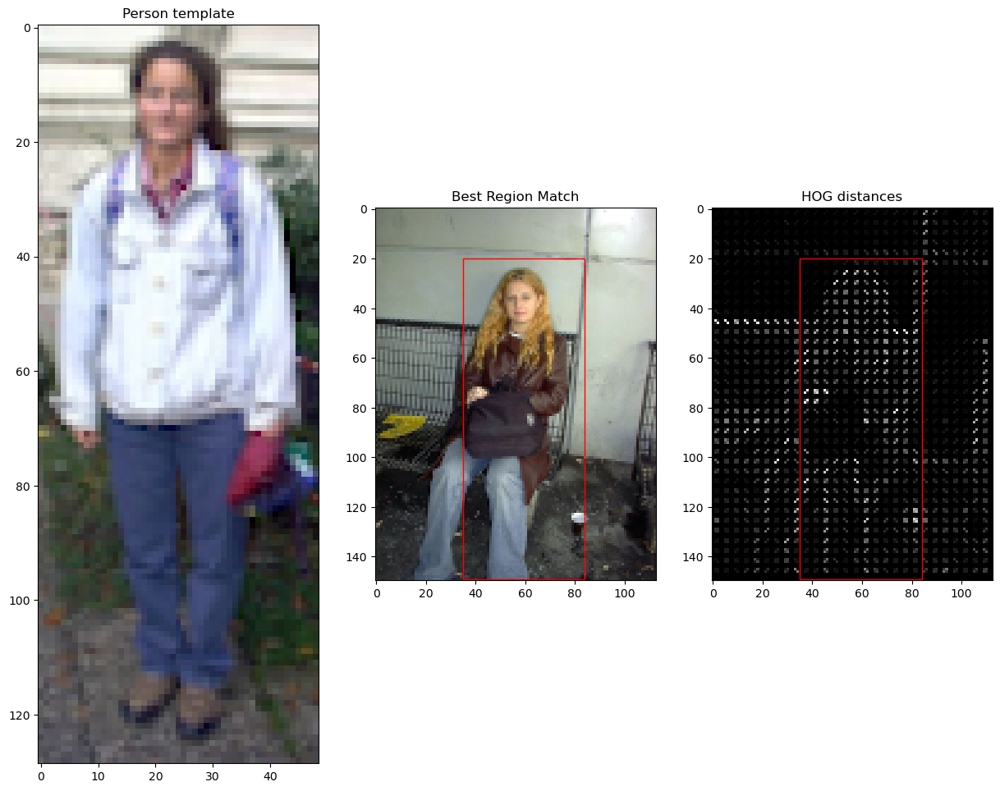

Image number:  11 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


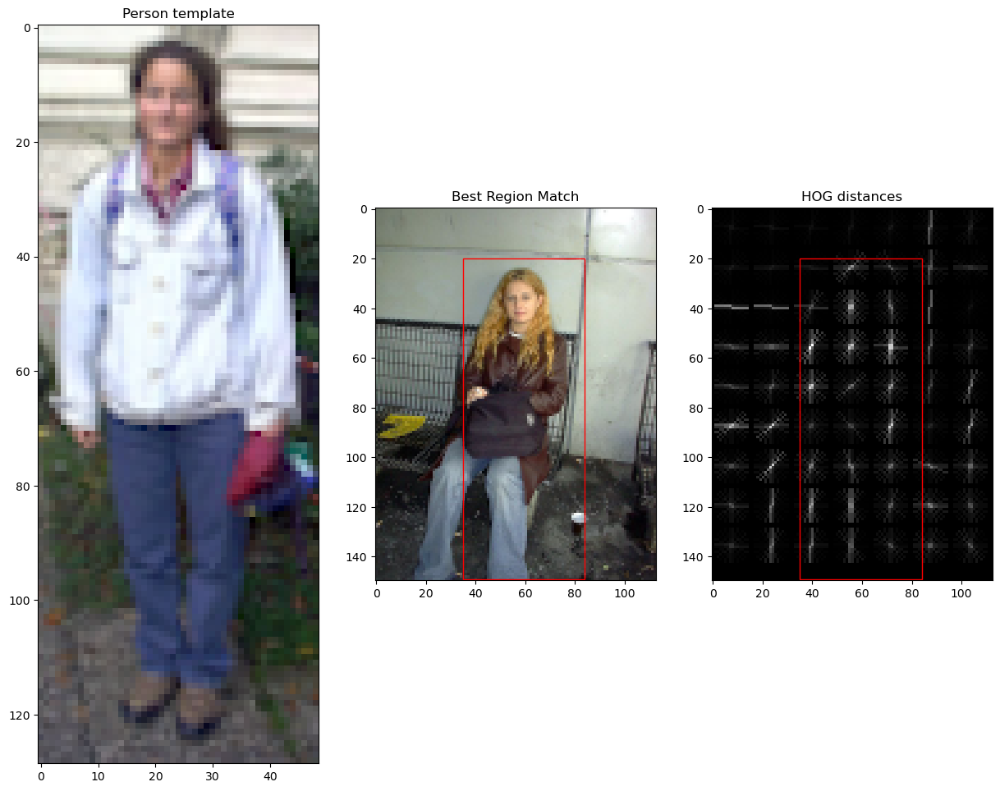

Image number:  12 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


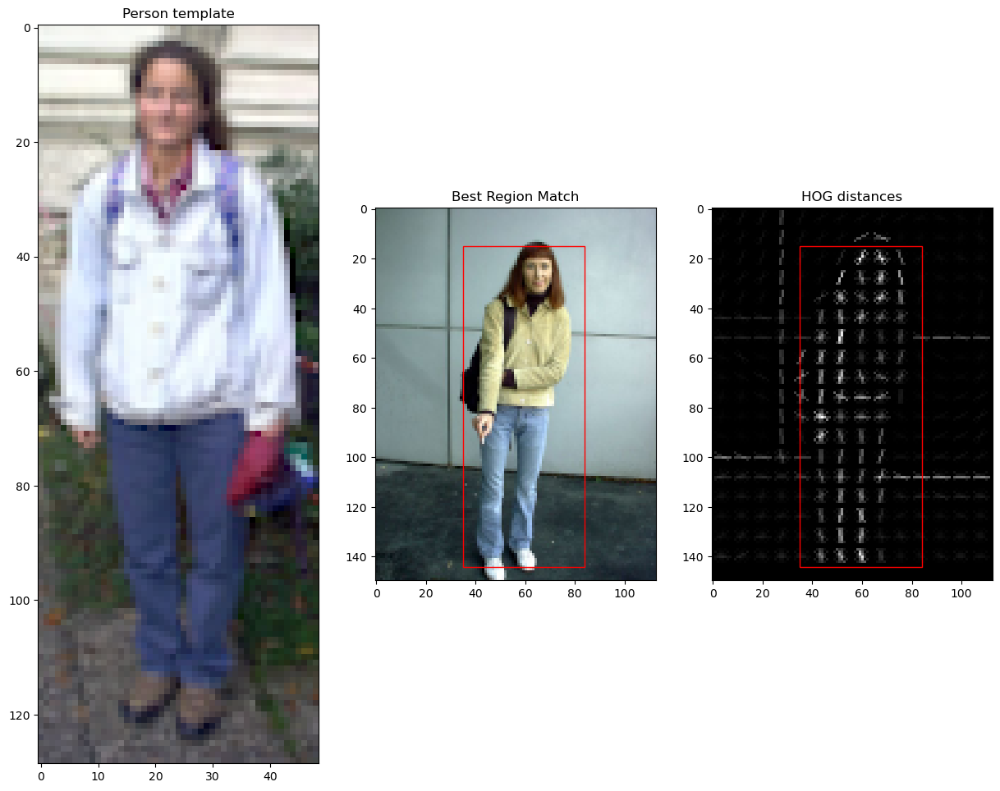

Image number:  12 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


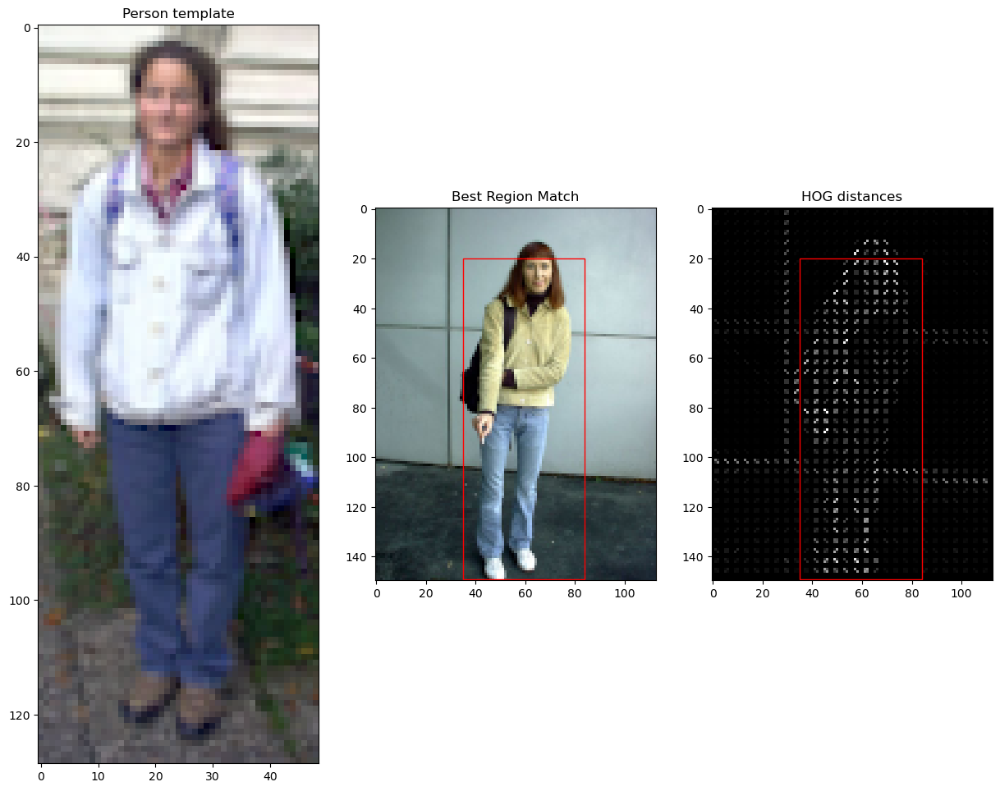

Image number:  12 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


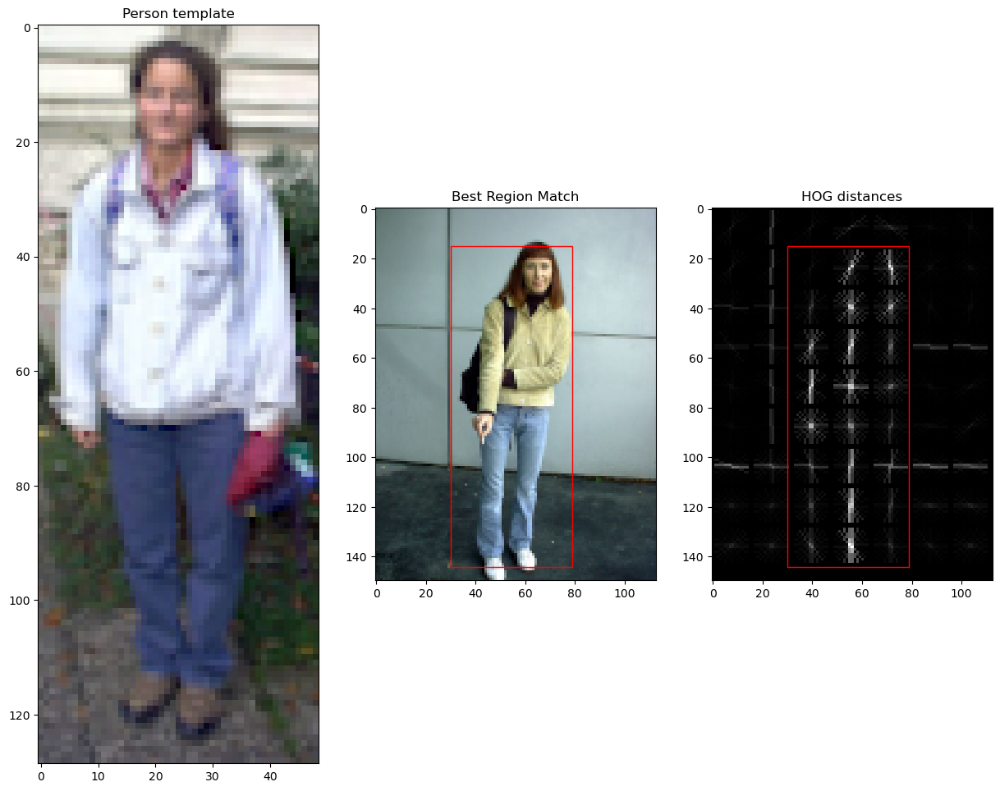

Image number:  13 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


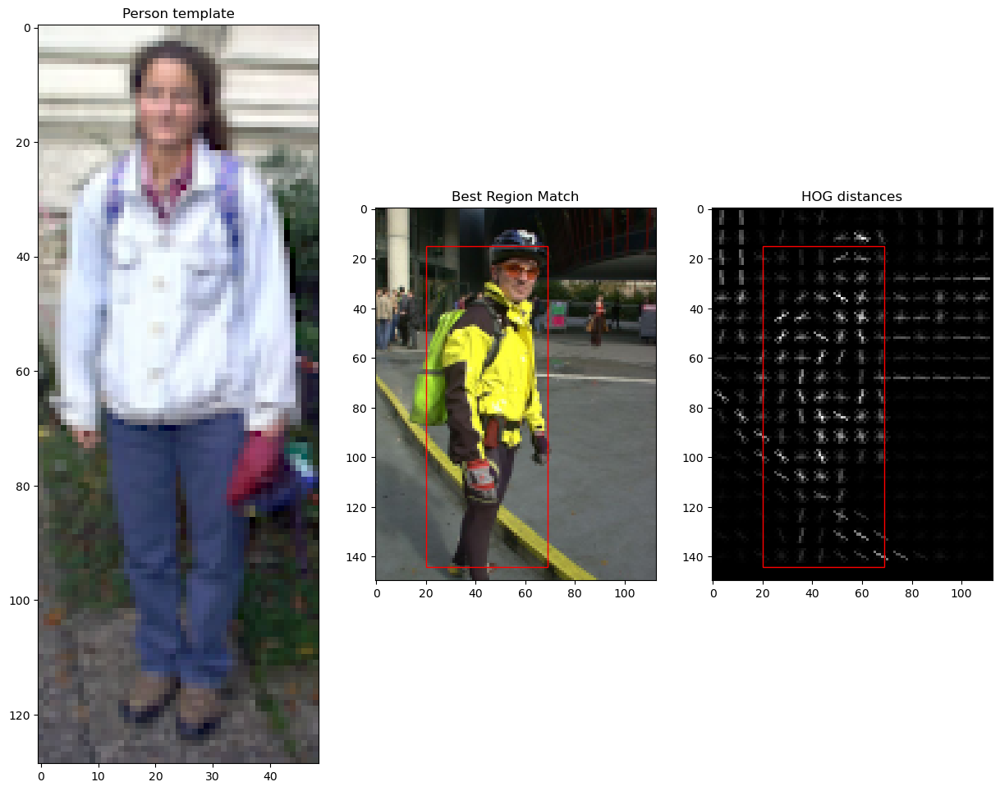

Image number:  13 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


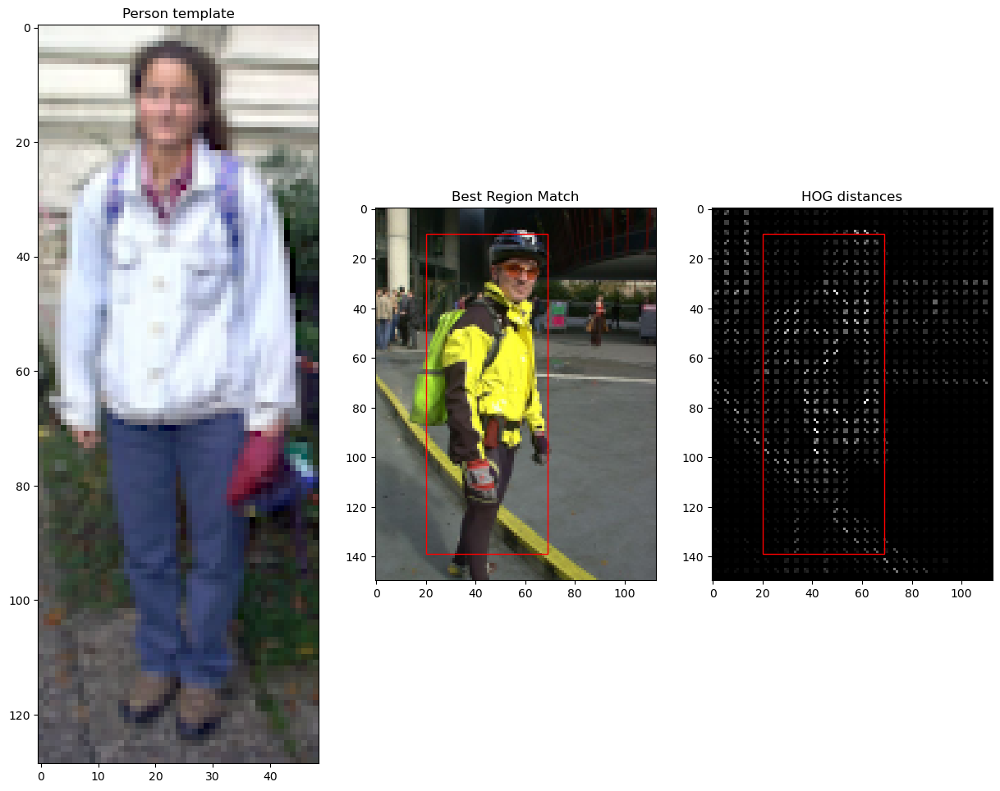

Image number:  13 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


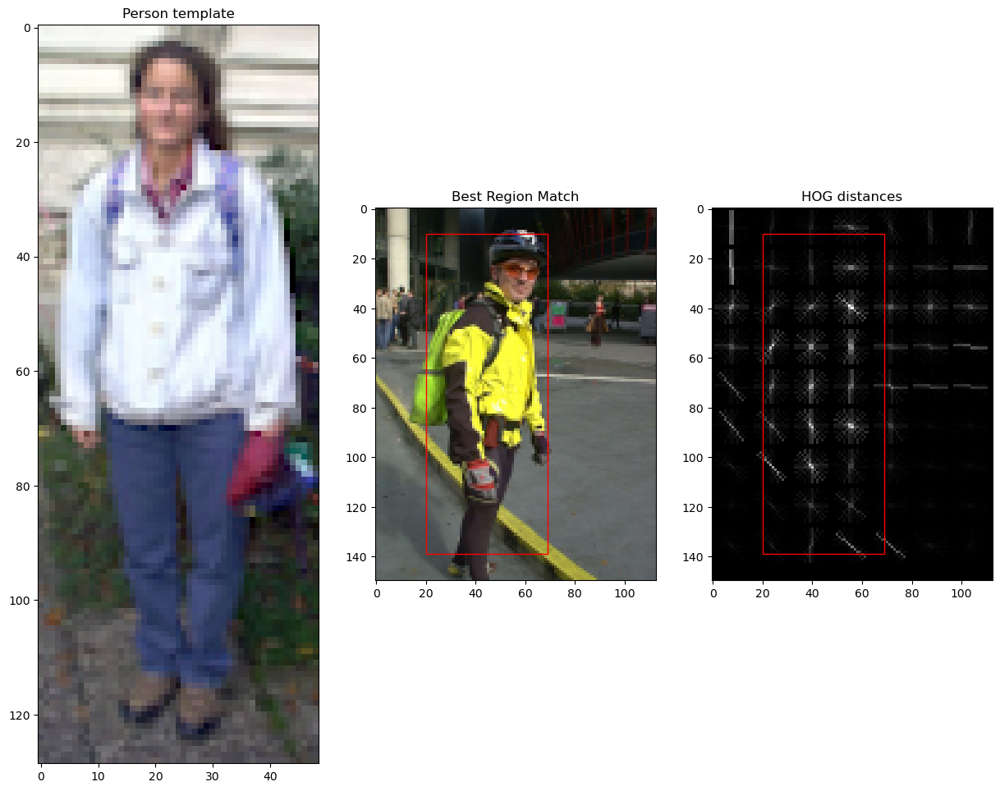

Image number:  14 with parameters:  orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)


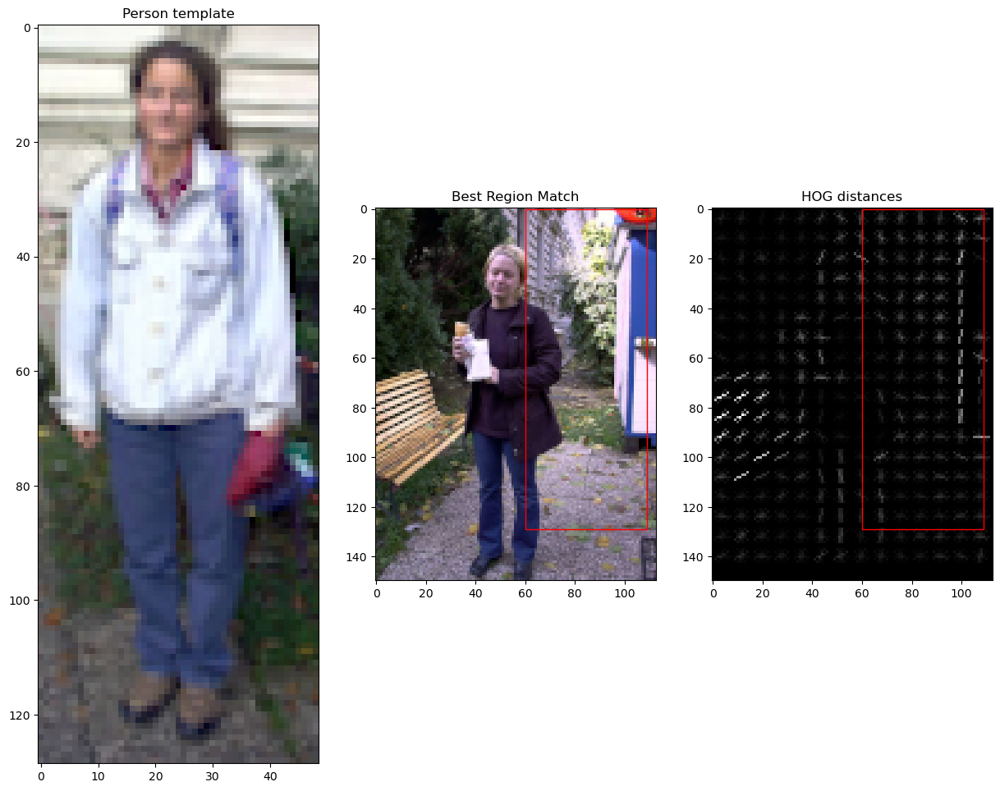

Image number:  14 with parameters:  orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)


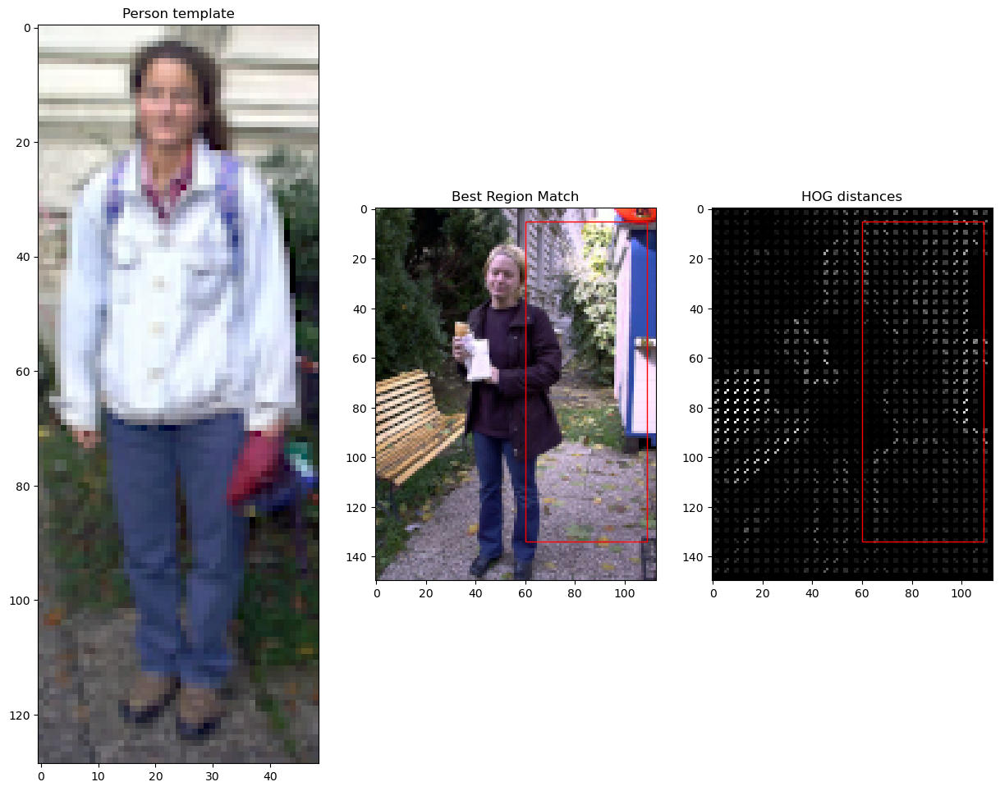

Image number:  14 with parameters:  orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)


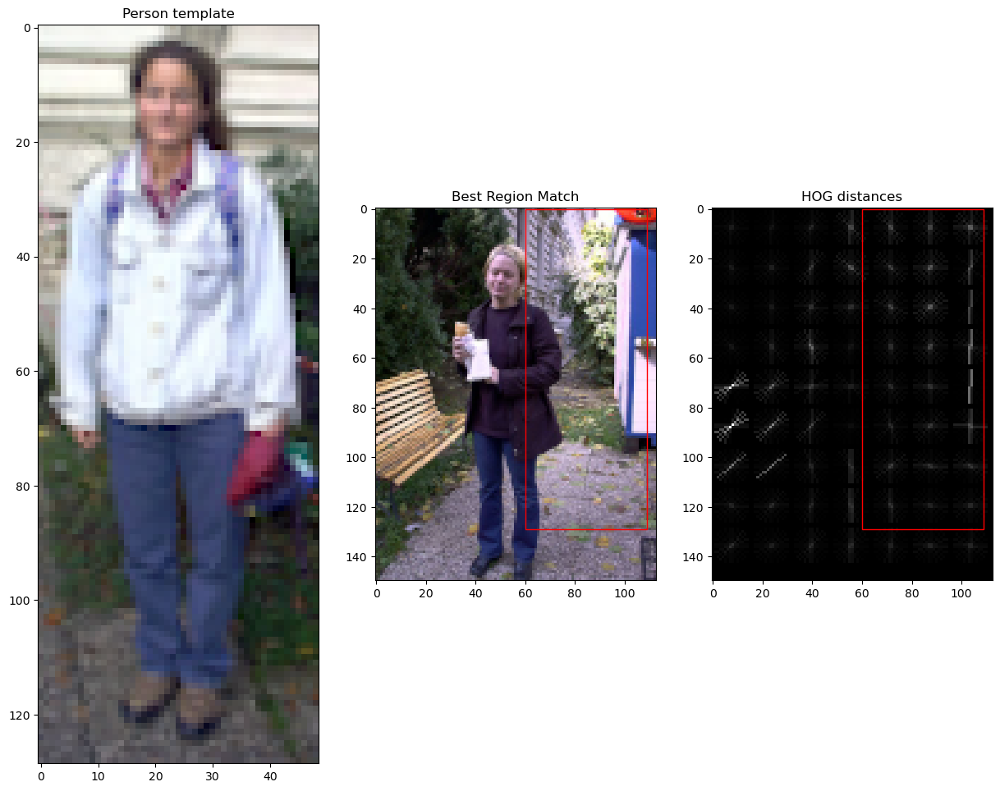

In [19]:
# Your solution here

# Load and process images
ic = io.ImageCollection('./images/TestPersonImages/*.bmp')
person = io.imread('./images/person_template.bmp')
person_gray = color.rgba2rgb(person)

# Apply comparison for each image in the collection
for i, im in enumerate(ic):
    print("Image number: ", i, "with parameters: ", "orientations=9, pixels_per_cell=(8, 8), cells_per_block=(3, 3)")
    compare(person_gray, im, orientations=9, pixels_per_cell=(8, 8),
                    cells_per_block=(3, 3), channel_axis=-1)
    print("Image number: ", i, "with parameters: ", "orientations=8, pixels_per_cell=(4, 4), cells_per_block=(3, 3)")
    compare(person_gray, im, orientations=8, pixels_per_cell=(4, 4),
                    cells_per_block=(2, 2), channel_axis=-1)
    print("Image number: ", i, "with parameters: ", "orientations=12, pixels_per_cell=(16, 16), cells_per_block=(4, 4)")
    compare(person_gray, im, orientations=12, pixels_per_cell=(16, 16),
                    cells_per_block=(4, 4), channel_axis=-1)


Comment the object detection process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Do you see any advantages of the HOG-based object detector compared to the template-based object detection? (The answer should be up to 10-15 lines).

**Answer to the quetion**

> The Histogram of Oriented Gradients (HOG) is an algorithm for object detection that operates by examining the directions of edges and gradients in an image. It divides the image into small regions called cells, computes histogram of gradient directions or edge orientations for the pixels within each cell, normalizes these histograms across larger, overlapping blocks for improved accuracy, and then uses these features to detect objects within the image.

- Advantages of HOG-based Object Detection:

    - Robustness to variations in geometric and photometric transformations, except for object orientation.

    - Effective in capturing edge and gradient structure that are very characteristic of local shape.

    - Well-suited for human detection tasks, as human forms have distinct edge and gradient patterns.

- Disadvantages of HOG-based Object Detection:

    - Computationally intensive, especially without the use of specialized hardware or optimizations.

    - Not invariant to object orientation; changes in orientation can significantly affect detection performance.
    
    - Can struggle with large intra-class variations and occlusions.

> Compared to template-based object detection, which relies on matching a template image at various scales and positions within a larger image, HOG-based detection has several advantages. It's more robust to changes in lighting and pose, as it uses gradient information rather than pixel intensities. HOG captures more of the structural and shape information of objects, making it less susceptible to background clutter and similar confounding factors. However, template-based methods can sometimes be more intuitive and easier to implement for simple detection tasks or when the object of interest has little variation in appearance and pose.

# 3 ORB feature detector and binary descriptor

Let us consider the problem of feature extraction that contains two subproblems:
- feature location,
- image feature description.

Let us focus on ORB, an approximation of SIFT method, and analyse if ORB is  scale and rotation invariant, a property that is very important for real-time applications.

**Hint:** `ORB` is a function within the module `skimage.feature`
                             
**Help**: We suggest to have a look at the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) how to compute the ORB descriptors and find the descriptors match. You can use the function match_descriptors from `skimage.feature` module in order to compute and show the similar detected descriptors of the given images.

**3.1 (10 points)** First, detect the censure in the image `starbucks4.jpg`. Analyze and discuss the effect of different values of the parameters in censure function. (this is a separate funcion from ORB)

**Answer to the question**

**Diferent parameters in CENSURE function**

- __mode__: This can be 'DoB', 'Octagon', or 'Star'. Each mode uses a different pattern for the center-surround feature detection. The choice of mode affects the types of features that are detected.

- __min_scale__: The minimum scale at which features are detected. Higher values can make the detector focus on larger features.

- __max_scale__: The maximum scale for feature detection. Adjusting this can help focus the detector on smaller or larger features.

- __line_threshold__: A threshold for eliminating edge-like features to reduce false positives.

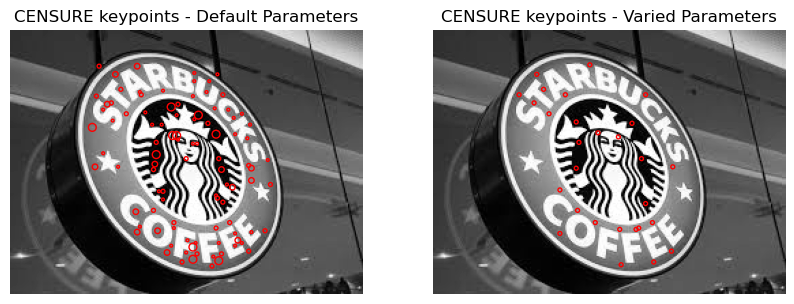

In [38]:
# Your solution here

# Load and convert the image to grayscale
starbucks = io.imread('./images/starbucks4.jpg')
starbucks_gray = to_grayscale(starbucks)

# Initialize CENSURE detector with default parameters
detector = CENSURE()

# Detect features
detector.detect(starbucks_gray)

# Display the keypoints with default parameters
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(starbucks_gray, cmap=plt.cm.gray)
plt.scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2 ** detector.scales,
            facecolors='none', edgecolors='r')
plt.title('CENSURE keypoints - Default Parameters')
plt.axis('off')

# Now vary the parameters --> change the mode to 'Star'
detector = CENSURE(mode='star', min_scale=2, max_scale=4, line_threshold=10)

# Detect features with new parameters
detector.detect(starbucks_gray)

# Display the keypoints with varied parameters
plt.subplot(1, 2, 2)
plt.imshow(starbucks_gray, cmap=plt.cm.gray)
plt.scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2 ** detector.scales,
            facecolors='none', edgecolors='r')
plt.title('CENSURE keypoints - Varied Parameters')
plt.axis('off')

plt.show()

**3.2 (10 points)** Detect the correspondences between the model image `starbucks.jpg` with the scene image `starbucks4.jpg`. You can adapt the code from the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html).

Define a function get_ORB implementing the algorithm in order to be able to apply it on different images. Comment the code in detail.

**Hint: If the function plot_matches() gives you an error you can use the plot_matches_aux() at the end of this file.**

Analyze and discuss the effect of different values of the parameter `max_ratio` in the match_descriptors function.


**Answer to the question**

> max_ratio is used to filter matches based on the distance ratio between the best and second-best match. A lower max_ratio (e.g., 0.7 or 0.8) will result in fewer matches because it only keeps matches where the best match is much better than the second-best. This helps to filter out ambiguous matches but might miss some correct matches.

> A higher max_ratio (close to 1.0) will allow more matches, including potentially incorrect ones, leading to more noise in the matching but could be useful if the images are very different and finding matches is difficult.

In [21]:
def get_ORB(img1, img2, n_keypoints):
    """
    Extracts and matches ORB features between two images.
    Args:
        img1, img2: Input images.
        n_keypoints: Number of keypoints to detect.
    Returns:
        Tuple containing processed images, keypoints, and matches.
    """
    # Convert images to grayscale and normalize
    img1_gray = to_grayscale(img1)
    img2_gray = to_grayscale(img2)

    # Initialize ORB detector
    orb = ORB(n_keypoints=n_keypoints)

    # Detect and extract features from the first image
    orb.detect_and_extract(img1_gray)
    keypoints1 = orb.keypoints
    descriptors1 = orb.descriptors

    # Detect and extract features from the second image
    orb.detect_and_extract(img2_gray)
    keypoints2 = orb.keypoints
    descriptors2 = orb.descriptors

    # Match descriptors between images
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=1.0)

    return img1_gray, img2_gray, keypoints1, keypoints2, matches

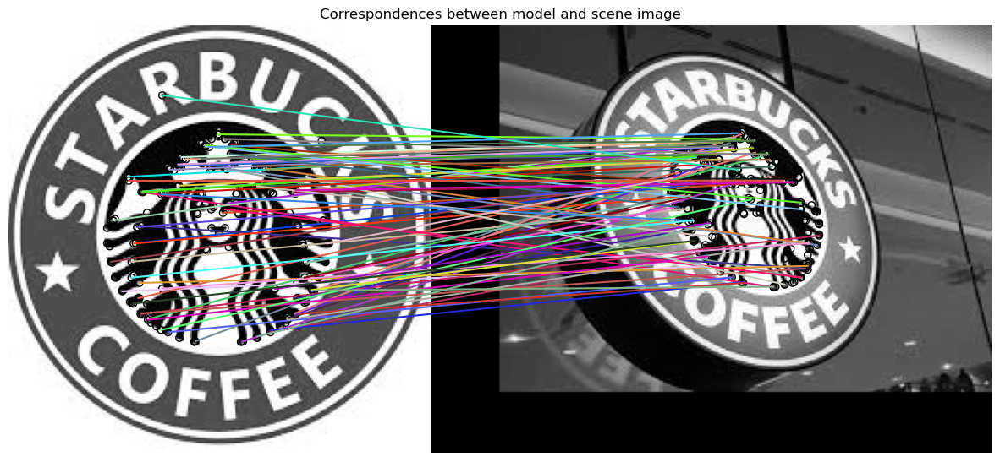

In [22]:
# Your solution here

# Load images
starbucks = io.imread('./images/starbucks.jpg')
starbucksScene = io.imread('./images/starbucks4.jpg')

# Detect ORB features and matches
results = get_ORB(starbucks, starbucksScene, 200)

# Plotting the matches
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))
ax.set_title("Correspondences between model and scene image")
plot_matches(ax, results[0], results[1], results[2], results[3], results[4])
ax.axis('off')
plt.show()

Repeate the experiment comparing the `starbucks.jpg` image as a model, and showing its matches to all Starbucks images, sorting them based on their similarity to the model. Comment when does the algorithm work better.

**Answer to the question**

> The algorithm tends to work better when:

    - The model and scene images have a similar scale and orientation.

    - The images have distinctive features that are not repeated too many times within the same image.

    - The images have good lighting and contrast, which helps in feature detection.

> Images that are too dissimilar, have low contrast, or contain repetitive patterns may result in fewer or less reliable matches. 

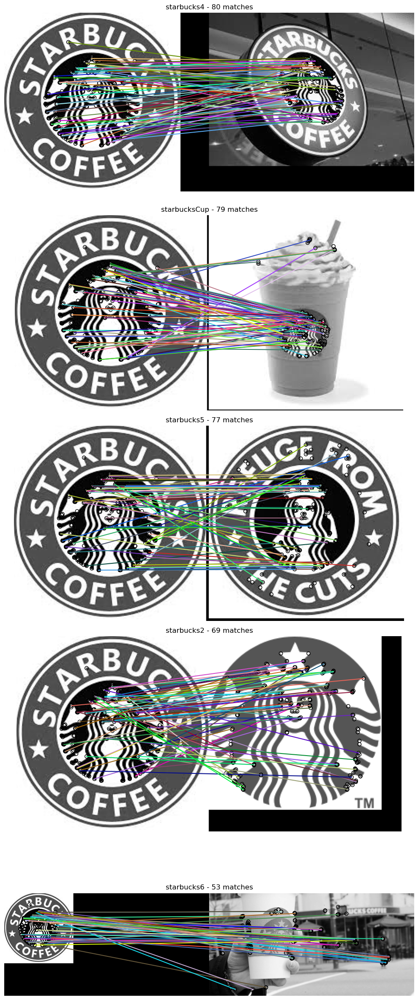

In [23]:
# Your solution here

# Load images
starbucks = io.imread('./images/starbucks.jpg')
starbucks_gray = to_grayscale(starbucks)

other_images = {
    'starbucks2': to_grayscale(io.imread('./images/starbucks2.png')),
    'starbucks4': to_grayscale(io.imread('./images/starbucks4.jpg')),
    'starbucks5': to_grayscale(io.imread('./images/starbucks5.png')),
    'starbucks6': to_grayscale(io.imread('./images/starbucks6.jpg')),
    'starbucksCup': to_grayscale(io.imread('./images/starbucksCup.jpg'))
}

# Dictionary to store the number of matches for each image
match_counts = {}

# Detect ORB features and matches for each image
for name, image in other_images.items():
    _, _, _, _, matches = get_ORB(starbucks_gray, image, 200)
    match_counts[name] = len(matches)

# Sort the images based on the number of matches
sorted_images = sorted(match_counts, key=match_counts.get, reverse=True)

# Display the results
fig, axes = plt.subplots(nrows=len(sorted_images), ncols=1, figsize=(10, len(sorted_images) * 5))

for i, name in enumerate(sorted_images):
    _, _, keypoints1, keypoints2, matches = get_ORB(starbucks_gray, other_images[name], 200)
    plot_matches(axes[i], starbucks_gray, other_images[name], keypoints1, keypoints2, matches)
    axes[i].set_title(f'{name} - {match_counts[name]} matches')
    axes[i].axis('off')

plt.tight_layout()
plt.show()

**3.3 (5 points)** Repeat the experiment:
- Changing the orientation of the model image by rotating it and comparing it with its original version. Help: you can use the rotate() function from skimage.transform
- Change the scale and orientation of the scene image and compare it with the model image.

**Help:** To do so, you can use the function given below as example:

```
import transform as tf
rotationdegrees = 180
img_rotated = tf.rotate(image2transform, rotationdegrees)
```

or

```
tform = tf.AffineTransform(scale=(1.2, 1.2), translation=(0, -100), rotation=0.5)
img_transformed = tf.warp(image2transform, tform)
```

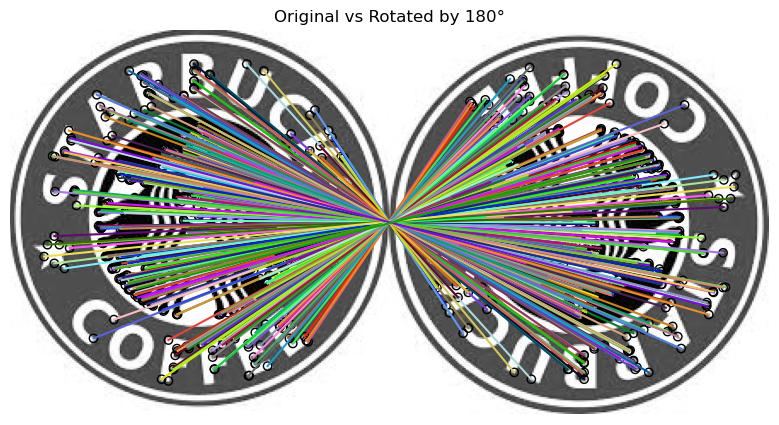

In [24]:
# Your solution here

## Rotate the model image and compare it with the original using the ORB feature matching ##

# Load the model image
starbucks = io.imread('./images/starbucks.jpg')
starbucks_gray = to_grayscale(starbucks)

# Rotate the model image
rotation_degrees = 180
starbucks_rotated = transform.rotate(starbucks_gray, rotation_degrees)

# Perform ORB matching
_, _, keypoints1, keypoints2, matches = get_ORB(starbucks_gray, starbucks_rotated, 500)

# Plotting the matches
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
plot_matches(ax, starbucks_gray, starbucks_rotated, keypoints1, keypoints2, matches)
ax.set_title(f'Original vs Rotated by {rotation_degrees}°')
ax.axis('off')
plt.show()

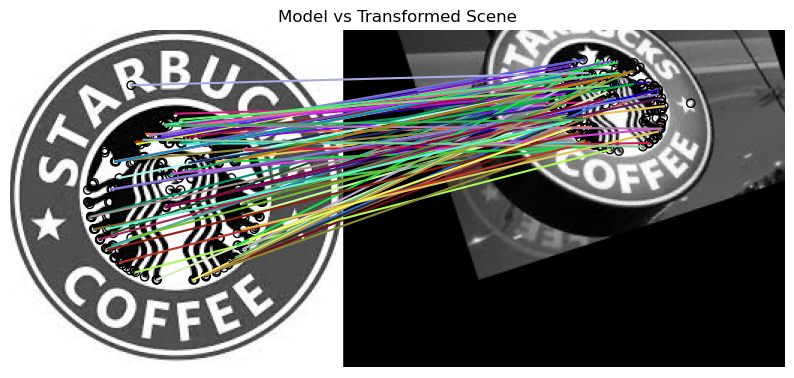

In [25]:
## Apply scaling and rotation transformation to the scene image and compare it with the original using the ORB feature matching ##

# Choose the scene image
starbucks_scene = io.imread('./images/starbucks4.jpg')
starbucks_scene_gray = to_grayscale(starbucks_scene)

# Apply scaling and rotation transformation
tform = transform.AffineTransform(scale=(1.1, 1.1), rotation=np.deg2rad(18))
starbucks_transformed = transform.warp(starbucks_scene_gray, tform)

# Perform ORB matching
_, _, keypoints1, keypoints2, matches = get_ORB(starbucks_gray, starbucks_transformed, 200)

# Plotting the matches
fig, ax = plt.subplots(1, 1, figsize=(10, 5))
plot_matches(ax, starbucks_gray, starbucks_transformed, keypoints1, keypoints2, matches)
ax.set_title('Model vs Transformed Scene')
ax.axis('off')
plt.show()

**(Optional)** Repeat the experiment (3.1 to 3.3) with a new group of images. You could use Coca-Cola advertisements or from another famous brand, easily to find on internet.


## 3.1

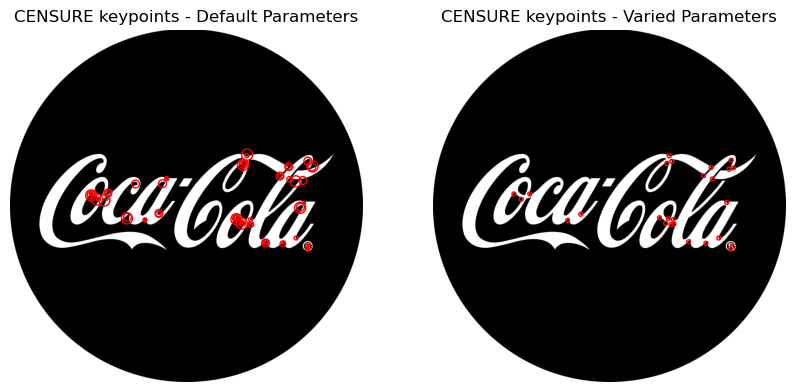

In [26]:
# Load and convert the image to grayscale
model = to_grayscale(io.imread("./images/CocaColaImages/cocacola_logo.png"))

# Initialize CENSURE detector with default parameters
detector = CENSURE()

# Detect features
detector.detect(model)

# Display the keypoints with default parameters
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(model, cmap=plt.cm.gray)
plt.scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2 ** detector.scales,
            facecolors='none', edgecolors='r')
plt.title('CENSURE keypoints - Default Parameters')
plt.axis('off')

# Now vary the parameters --> change the mode to 'Star'
detector = CENSURE(mode='star', min_scale=2, max_scale=4, line_threshold=10)

# Detect features with new parameters
detector.detect(model)

# Display the keypoints with varied parameters
plt.subplot(1, 2, 2)
plt.imshow(model, cmap=plt.cm.gray)
plt.scatter(detector.keypoints[:, 1], detector.keypoints[:, 0], 2 ** detector.scales,
            facecolors='none', edgecolors='r')
plt.title('CENSURE keypoints - Varied Parameters')
plt.axis('off')

plt.show()



## 3.2

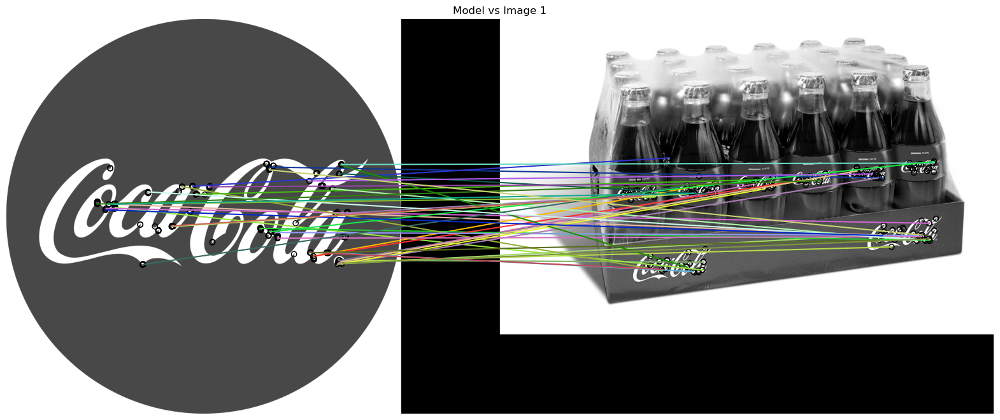

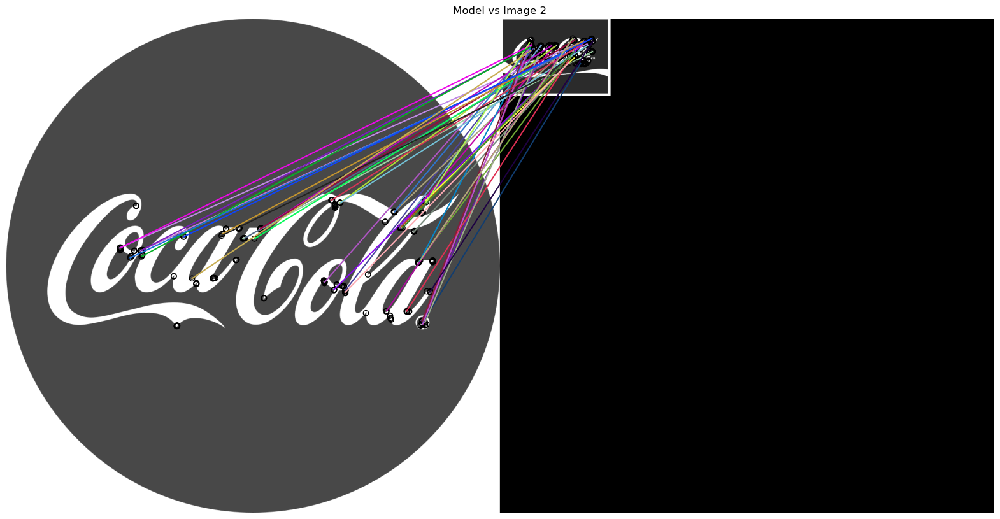

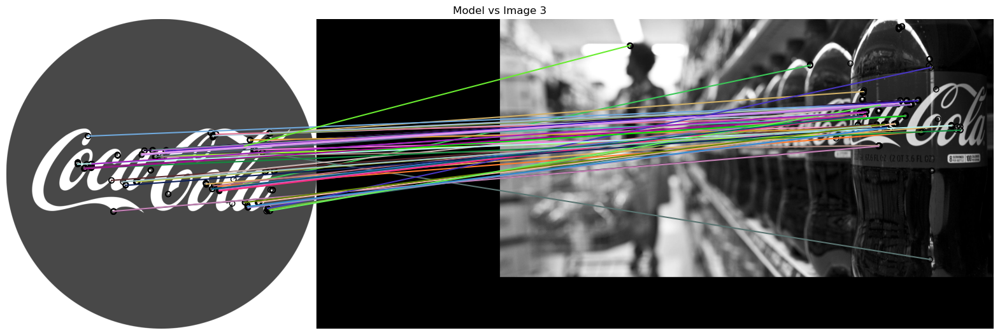

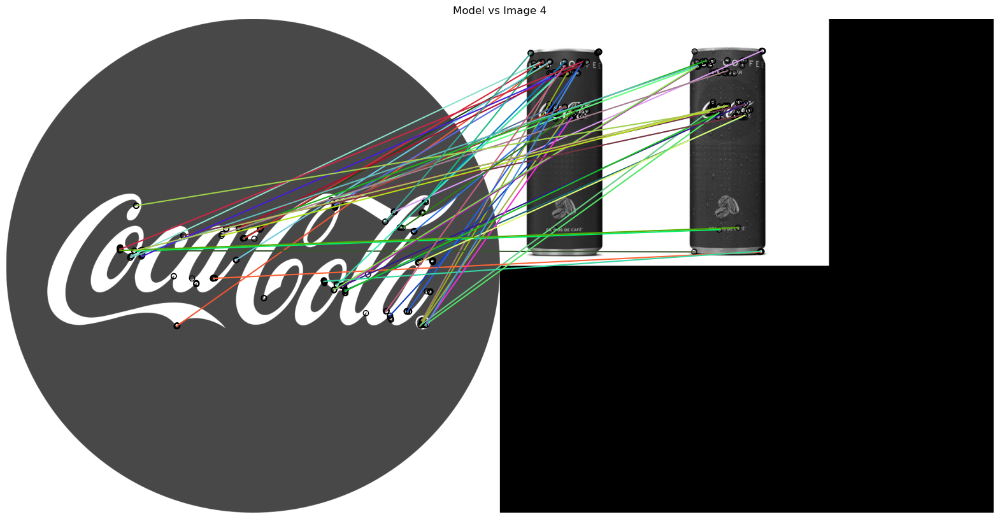

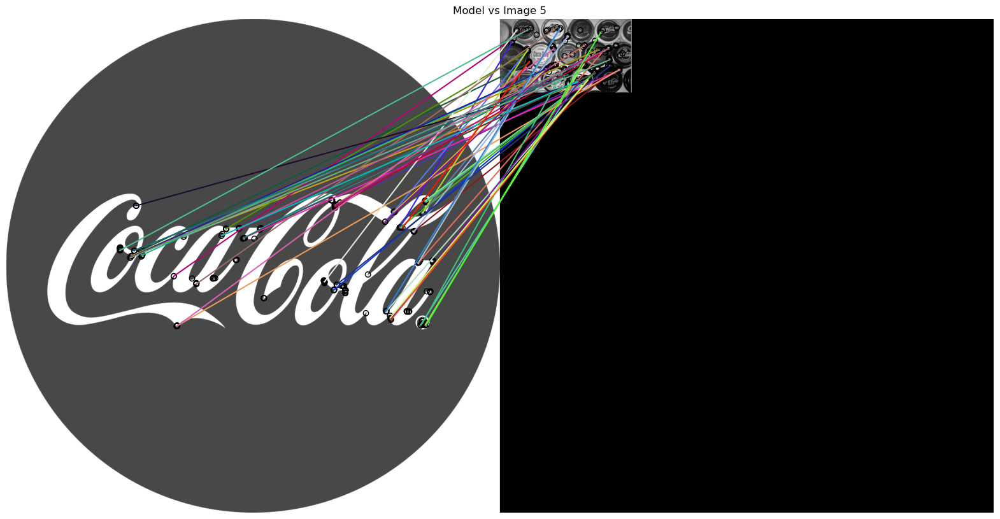

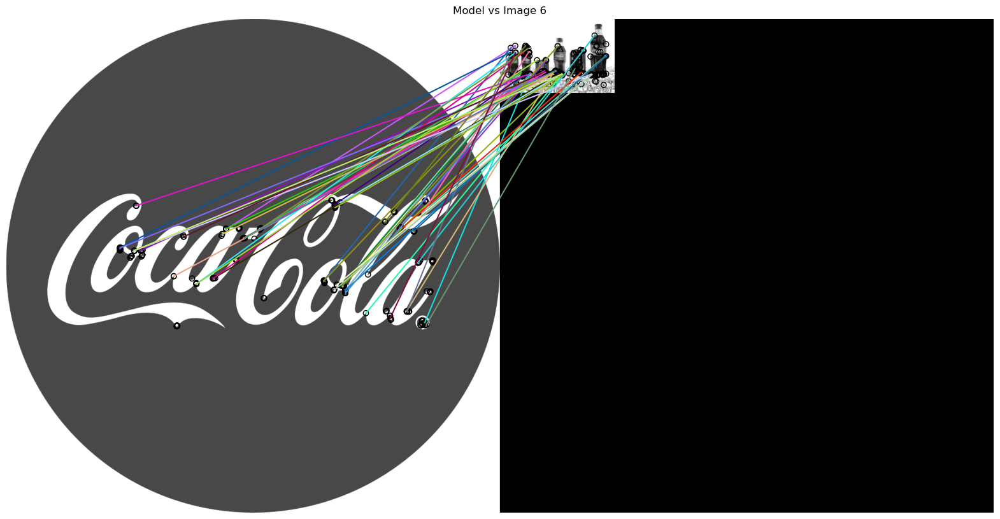

In [27]:
# Load other Coca-Cola images
cocacola_images = [
    to_grayscale(io.imread("./images/CocaColaImages/cocacola1.jpg")),
    to_grayscale(io.imread("./images/CocaColaImages/cocacola2.png")),
    to_grayscale(io.imread("./images/CocaColaImages/cocacola3.jpg")), 
    to_grayscale(io.imread("./images/CocaColaImages/cocacola4.jpg")),
    to_grayscale(io.imread("./images/CocaColaImages/cocacola5.png")),
    to_grayscale(io.imread("./images/CocaColaImages/cocacola6.jpg"))
]

# Match features between the model and each Coca-Cola image
for i, actual_Image in enumerate(cocacola_images):
    _, _, keypoints1, keypoints2, matches = get_ORB(model, actual_Image, 200)
    
    # Plotting the matches
    fig, ax = plt.subplots(1, 1, figsize=(20, 15))
    plot_matches(ax, model, actual_Image, keypoints1, keypoints2, matches)
    ax.set_title(f'Model vs Image {i+1}')
    ax.axis('off')
    plt.show()

Repeate the experiment comparing the `cocacola_logo.png` image as a model, and showing its matches to all Coca-Cola images, sorting them based on their similarity to the model. Comment when does the algorithm work better. (ANSWERED BEFORE)

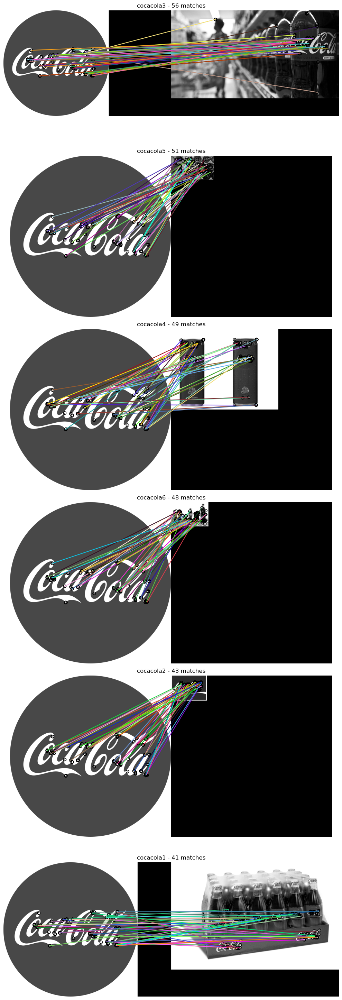

In [28]:
# Load the model image
model = to_grayscale(io.imread("./images/CocaColaImages/cocacola_logo.png"))

# Load other Coca-Cola images and convert to grayscale
cocacola_images_2 = {
    'cocacola1': to_grayscale(io.imread("./images/CocaColaImages/cocacola1.jpg")),
    'cocacola2': to_grayscale(io.imread("./images/CocaColaImages/cocacola2.png")),
    'cocacola3': to_grayscale(io.imread("./images/CocaColaImages/cocacola3.jpg")),
    'cocacola4': to_grayscale(io.imread("./images/CocaColaImages/cocacola4.jpg")),
    'cocacola5': to_grayscale(io.imread("./images/CocaColaImages/cocacola5.png")),
    'cocacola6': to_grayscale(io.imread("./images/CocaColaImages/cocacola6.jpg"))
}

# Dictionary to store the number of matches for each image
match_counts = {}

# Detect ORB features and matches for each image
for name, image in cocacola_images_2.items():
    _, _, _, _, matches = get_ORB(model, image, 200)
    match_counts[name] = len(matches)

# Sort the images based on the number of matches
sorted_images = sorted(match_counts, key=match_counts.get, reverse=True)

# Display the results
fig, axes = plt.subplots(nrows=len(sorted_images), ncols=1, figsize=(10, len(sorted_images) * 5))

for i, name in enumerate(sorted_images):
    _, _, keypoints1, keypoints2, matches = get_ORB(model, cocacola_images_2[name], 200)
    plot_matches(axes[i], model, cocacola_images_2[name], keypoints1, keypoints2, matches)
    axes[i].set_title(f'{name} - {match_counts[name]} matches')
    axes[i].axis('off')

plt.tight_layout()
plt.show()

## 3.3

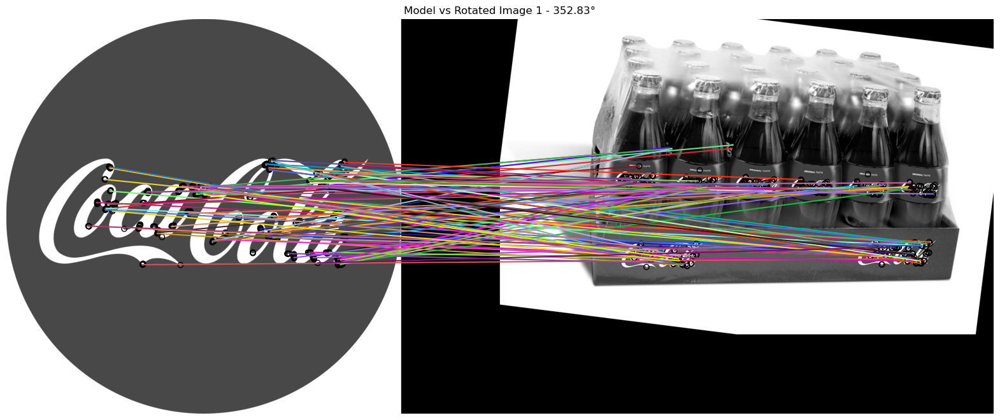

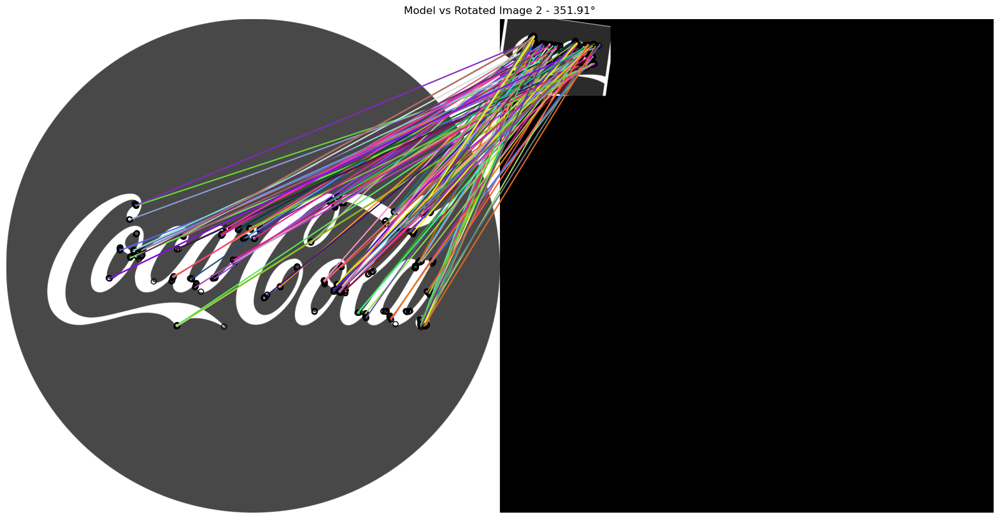

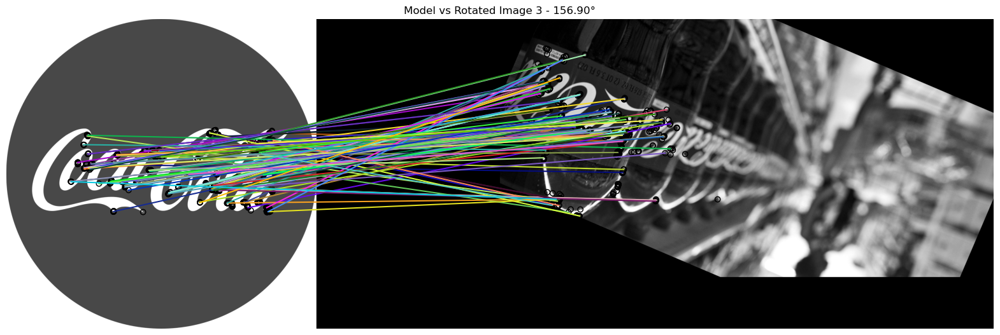

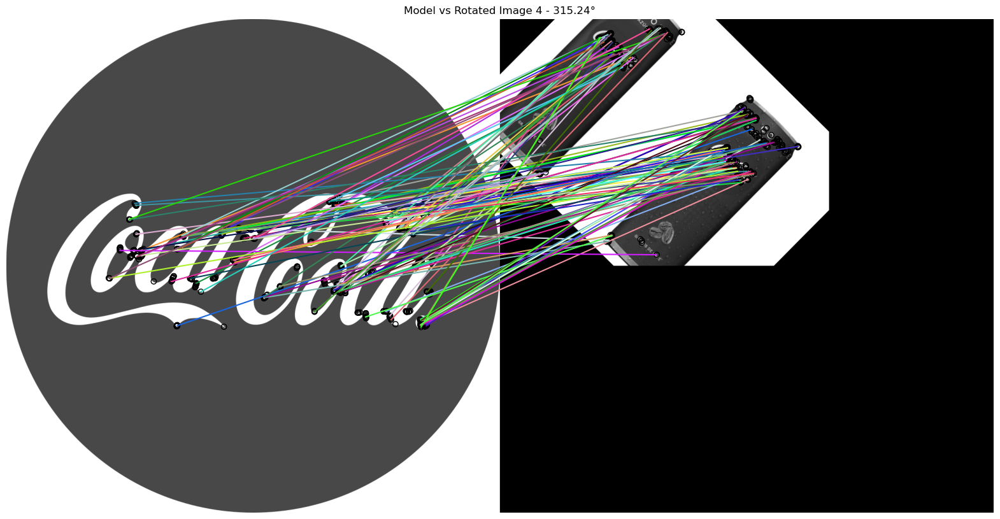

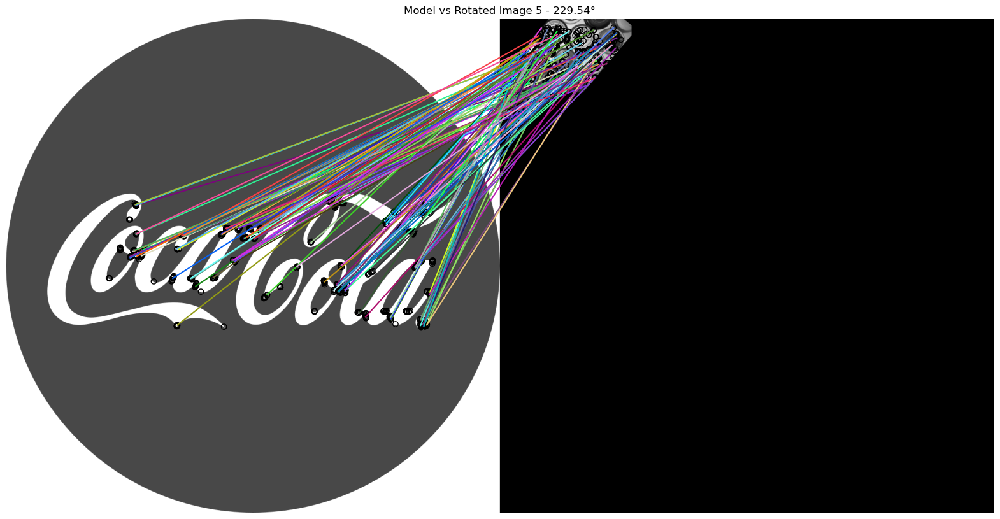

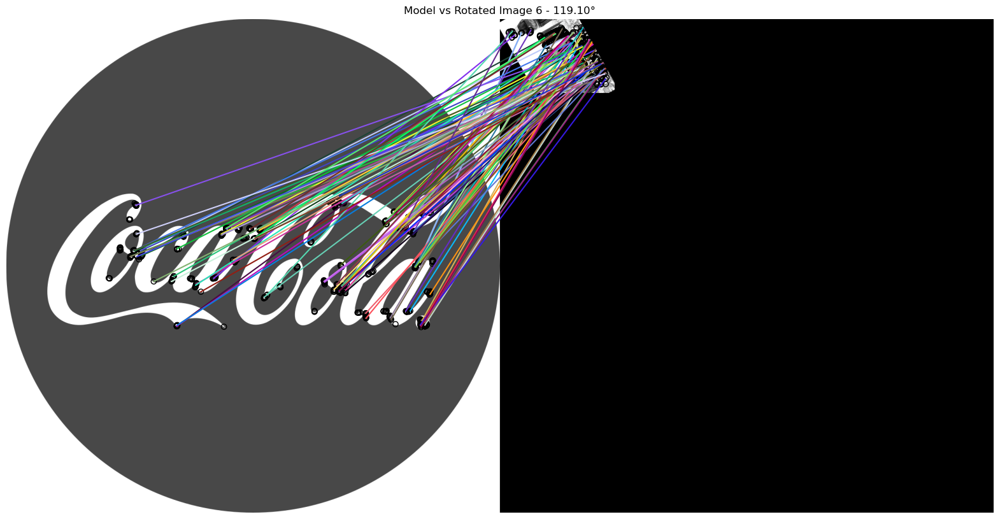

In [29]:
## Experiment with rotated versions of the Coca-Cola model image ##

# Rotate and match features with the model image
for i, actual_Image in enumerate(cocacola_images):
    rotation_angle = random.random() * 360
    rotated_image = transform.rotate(actual_Image, rotation_angle)

    _, _, keypoints1, keypoints2, matches = get_ORB(model, rotated_image, 500)
    
    # Plotting the matches
    fig, ax = plt.subplots(1, 1, figsize=(20, 15))
    plot_matches(ax, model, rotated_image, keypoints1, keypoints2, matches)
    ax.set_title(f'Model vs Rotated Image {i+1} - {rotation_angle:.2f}°')
    ax.axis('off')
    plt.show()

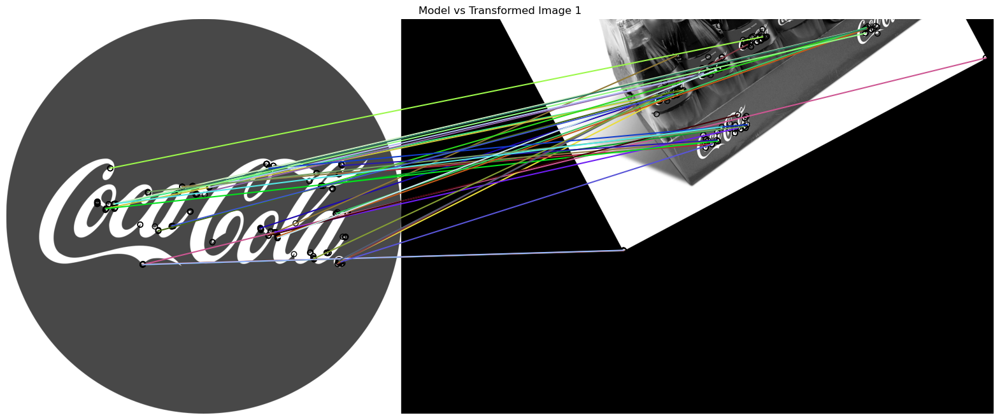

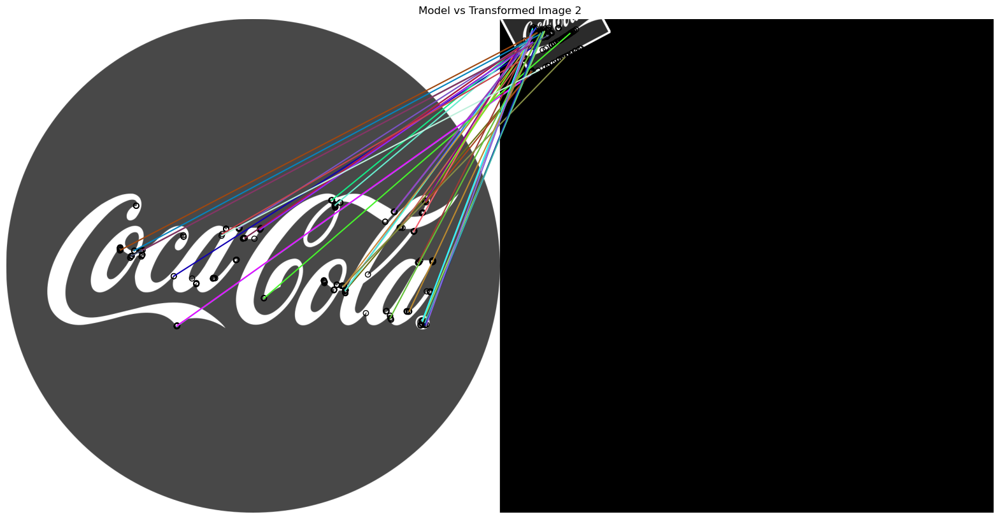

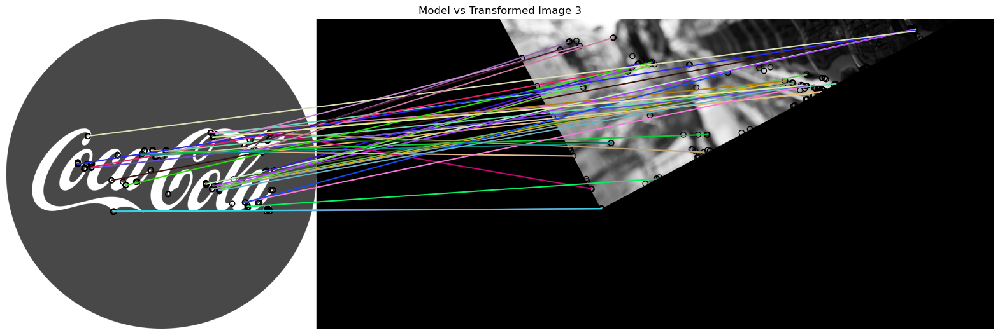

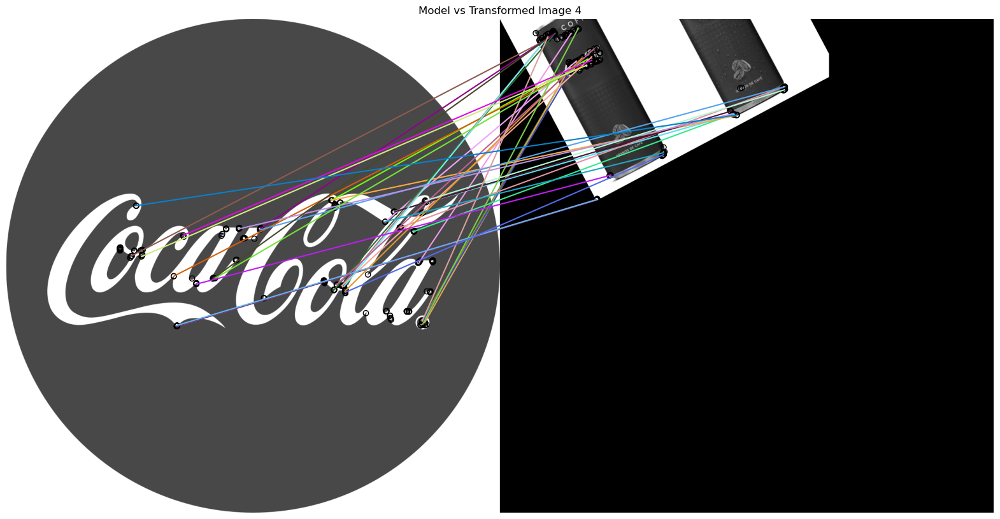

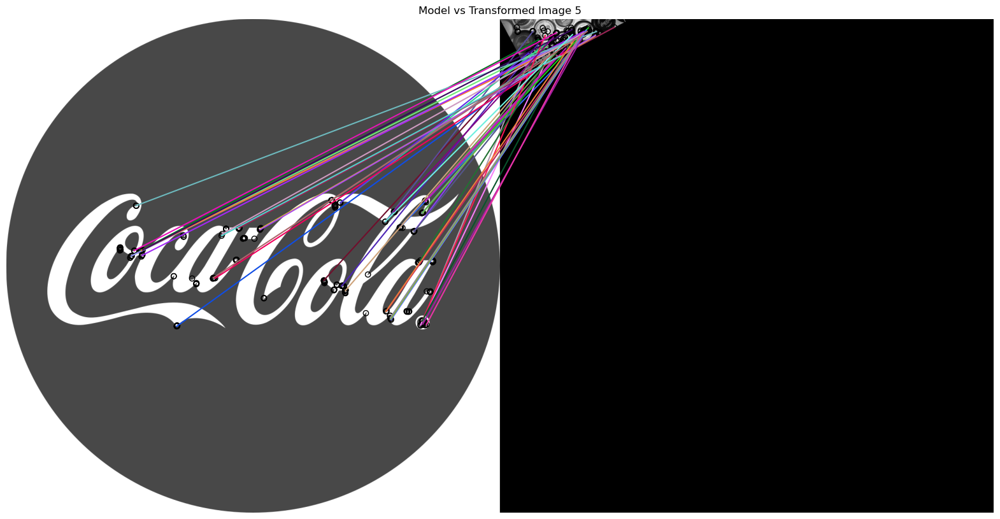

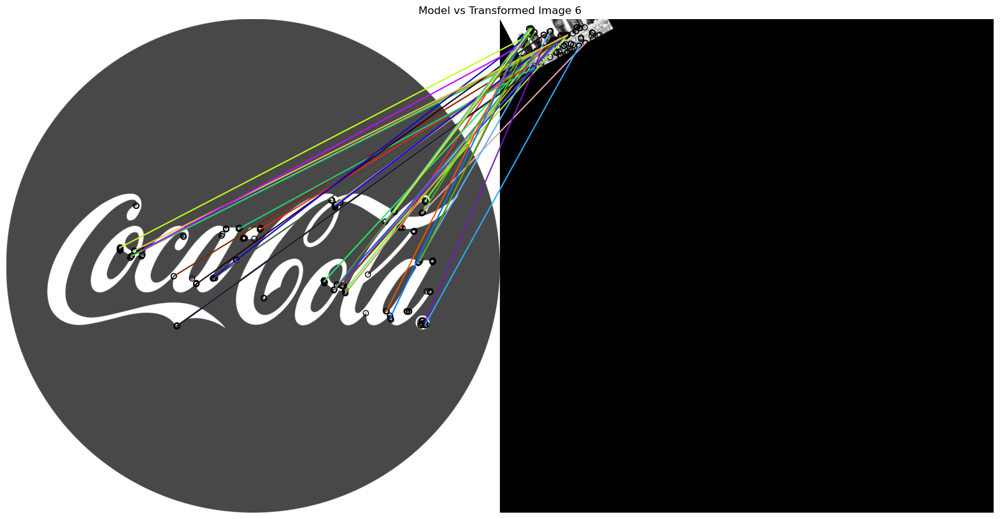

In [30]:
## Apply scaling and rotation transformation to the scene image and compare it with the original using the ORB feature matching ##

# Apply scaling and rotation transformations
for i, actual_Image in enumerate(cocacola_images):
    # These values could be assigned randomly, but to avoid the RuntimeError: ORB found no features, we chose them manually
    scale_factor = 1.2
    rotation_angle = np.deg2rad(28)
    tform = transform.AffineTransform(scale=(scale_factor, scale_factor), rotation=rotation_angle)
    transformed_image = transform.warp(actual_Image, tform)

    _, _, keypoints1, keypoints2, matches = get_ORB(model, transformed_image, 200)
    
    # Plotting the matches
    fig, ax = plt.subplots(1, 1, figsize=(20, 15))
    plot_matches(ax, model, transformed_image, keypoints1, keypoints2, matches)
    ax.set_title(f'Model vs Transformed Image {i+1}')
    ax.axis('off')
    plt.show()

**3.4 (5 points)** Analysis of the applied techniques and results

- What are the advantages of the ORB object detection with respect to the HOG and template object detector?

- What would happen if you analyse an image that does not contain the Starbucks logo?

- Could you think of ways of defining a quality measure for the correspondance between two images? (no need of implementing it)

**Answer to the question**

1. **Advantages of ORB over HOG and Template Matching**:

    - Robustness: ORB is more robust to changes in scale, rotation, and viewpoint compared to HOG and template matching.

    - Speed: ORB is faster, suitable for real-time applications, while HOG is computationally more intensive, and template matching can be inefficient.

    - Occlusions and Background Clutter: ORB handles occlusions and cluttered backgrounds better due to its feature-based approach.

2. **Analyzing an Image Without the Starbucks Logo**:
    - False Positives: ORB might incorrectly match unrelated features, leading to false positives.

    - Fewer Matches: The number of matches will likely be lower, and the matches could be of poor quality.

3. **Quality Measure for Image Correspondence**:

    - Number and Distribution of Matches: More and evenly distributed matches indicate better similarity.

    - Match Strength: Lower descriptor distance suggests stronger matches.

    - Geometric Consistency: Checking the alignment of matched features using a homography matrix helps assess match quality.

    - Robustness to Transformations: Good performance under scaling, rotation, and translation enhances the quality measure.

# 4. SIFT

**4.1 (5 points)** Now use SIFT to the same problem statement as 3.2 exercise, make sure to show the results with all starbucks images provided. For now, you can use the default parameters of SIFT.
* Compare the results and the running time of both algortihms.
* Which one works best on this case?

**Answer to the question**

1. The results and running time are compared below, where we print the result of using ORB next to the result using SIFT, along with the number of matches and running time of each one of the methods.

2. Based on the results, it appears that SIFT generally finds more matches compared to ORB across all the images shown. Here's a summary of the results:

    - Image 1: SIFT found more matches (177 vs 84) but took about twice as long as ORB.
    - Image 2: Again, SIFT outperformed ORB in terms of matches (188 vs 61) but with a longer processing time.
    - Image 3: SIFT detected significantly more matches (202 vs 72) but was slower.
    - Image 4: SIFT matches (91) outnumber ORB matches (69), with SIFT being slower.
    - Image 5: SIFT had more matches (188 vs 61), taking longer to compute.

> In terms of match count, SIFT consistently outperforms ORB. The higher number of matches suggests that SIFT is likely providing a more thorough detection of features within the Starbucks images. This can be attributed to SIFT's scale and rotation invariance, which tends to detect more features that are consistent across different views of an object.

> However, SIFT's running time is longer than ORB's in all cases. This is expected as SIFT is a more complex algorithm and computationally intensive.

> In conclusion, if the priority is to find the highest number of reliable matches, regardless of processing time, SIFT seems to be the better algorithm for this case. However, if speed is a crucial factor, ORB would be preferable despite finding fewer matches.

In [31]:
def get_SIFT(img1, img2):
    """
    Extracts and matches SIFT features between two images.
    """
    sift = SIFT()
    sift.detect_and_extract(img1)
    keypoints1 = sift.keypoints
    descriptors1 = sift.descriptors

    sift.detect_and_extract(img2)
    keypoints2 = sift.keypoints
    descriptors2 = sift.descriptors

    matches = match_descriptors(descriptors1, descriptors2, cross_check=True)
    return keypoints1, keypoints2, matches

Image 1: ORB Matches: 69, Time: 0.2856261730194092 seconds
Image 1: SIFT Matches: 167, Time: 0.5569801330566406 seconds


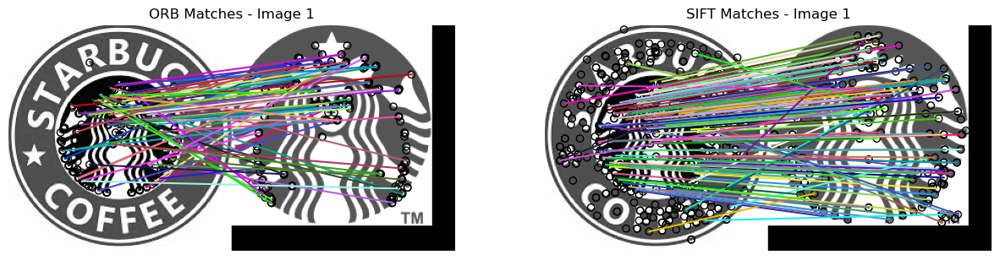

Image 2: ORB Matches: 80, Time: 0.28377509117126465 seconds
Image 2: SIFT Matches: 179, Time: 0.7093040943145752 seconds


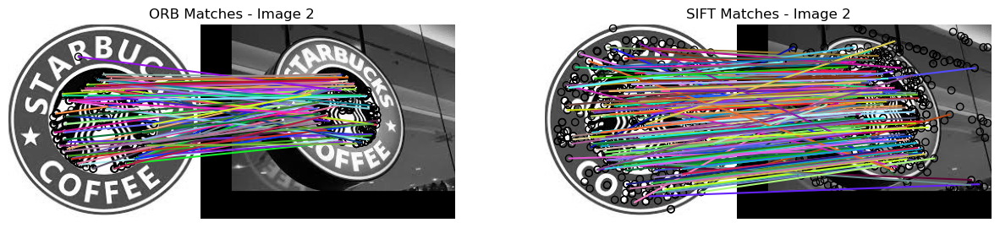

Image 3: ORB Matches: 77, Time: 0.6017708778381348 seconds
Image 3: SIFT Matches: 204, Time: 0.9754202365875244 seconds


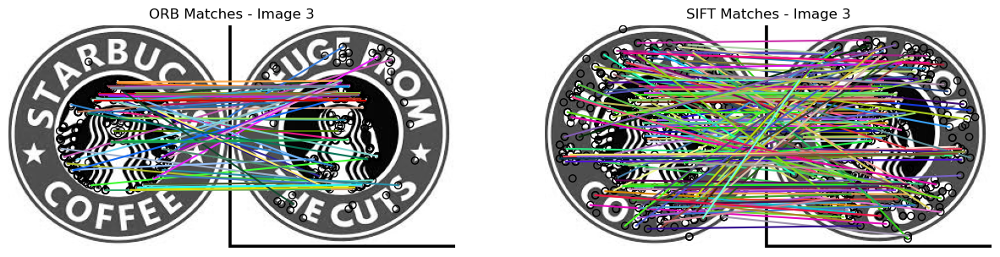

Image 4: ORB Matches: 53, Time: 0.532508134841919 seconds
Image 4: SIFT Matches: 191, Time: 1.7653748989105225 seconds


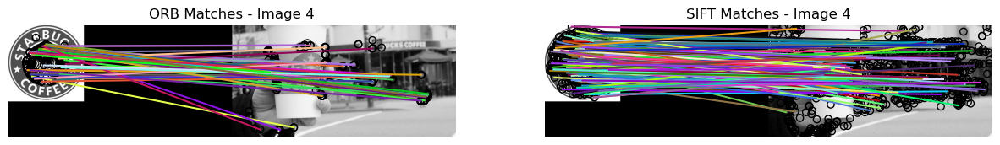

Image 5: ORB Matches: 79, Time: 0.26429176330566406 seconds
Image 5: SIFT Matches: 92, Time: 0.6053452491760254 seconds


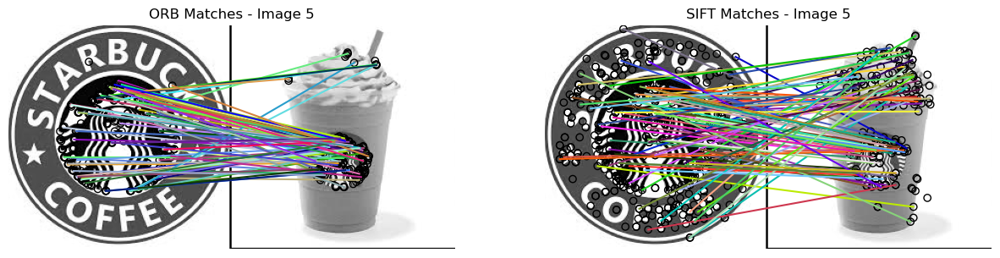

In [32]:
# Your solution

# Load images
starbucks = to_grayscale(io.imread('./images/starbucks.jpg'))
image_paths = ['./images/starbucks2.png', './images/starbucks4.jpg', './images/starbucks5.png', './images/starbucks6.jpg', './images/starbucksCup.jpg']
other_images = [to_grayscale(io.imread(path)) for path in image_paths]

# Compare ORB and SIFT
for i, image in enumerate(other_images):
    start_orb = time.time()
    _, _, keypoints1_orb, keypoints2_orb, matches_orb = get_ORB(starbucks, image, 200)
    end_orb = time.time()

    start_sift = time.time()
    keypoints1_sift, keypoints2_sift, matches_sift = get_SIFT(starbucks, image)
    end_sift = time.time()

    print(f"Image {i+1}: ORB Matches: {len(matches_orb)}, Time: {end_orb - start_orb} seconds")
    print(f"Image {i+1}: SIFT Matches: {len(matches_sift)}, Time: {end_sift - start_sift} seconds")

    # Plot ORB matches
    fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15, 15))
    plot_matches(ax[0], starbucks, image, keypoints1_orb, keypoints2_orb, matches_orb)
    ax[0].set_title(f"ORB Matches - Image {i+1}")
    ax[0].axis('off')

    # Plot SIFT matches
    plot_matches(ax[1], starbucks, image, keypoints1_sift, keypoints2_sift, matches_sift)
    ax[1].set_title(f"SIFT Matches - Image {i+1}")
    ax[1].axis('off')

    plt.show()

**4.2 (10 points)** Analyze the different SIFT parameters. Try and show the results for at least 3 different combination of parameters for starbucks4.jpg image against starbucks model image.

* What are their effect?
* How do they compare to ORB parameters? 
* Which algorithm is more suitable for images with rotation? And for images that have been rescaled, which one is more effective?
* When it comes to changes in image intensity, which algorithm performs better, ORB or SIFT?

**Answer to the questions**

1. Their effect:

    - upsampling: This increases the size of the image before feature detection. Upsampling can help detect features that are not apparent in the original scale, but it will increase computational time.
    - n_octaves: This controls how many times the image size is halved and the sigma doubled. More octaves increase the scale invariance but also increase computation.
    - n_scales: This defines how many scales are looked at within each octave. More scales can find more features but increase computation.
    - sigma_min: The minimum sigma for the Gaussian blur applied to images, influencing the level of detail captured.
    - sigma_in: The assumed level of blur in the input image; if the actual level is different, features may not be detected optimally.
    - c_dog: The contrast threshold for discarding weak keypoints in the Difference of Gaussians (DoG) step. Lower values mean more features are kept.
    - c_edge: The threshold for discarding keypoints that have too much edge response, which can help reduce false positives.
    - n_bins: The number of orientation bins. More bins can capture finer changes in orientation but may lead to more noise.
    - lambda_ori: A multiplier for the window size when finding the keypoint orientation.
    - c_max: The threshold for accepting secondary peaks in the orientation histogram, which affects keypoint orientation assignment.
    - lambda_descr: A multiplier for the descriptor window size, impacting the spatial binning of the descriptor.
    - n_hist: Defines the number of histograms used in the descriptor. More histograms can capture more spatial information but increase descriptor size.
    - n_ori: The number of bins in the histograms of the descriptor patch, affecting the descriptor's sensitivity to orientations.


2. Comparison to ORB Parameters

    - ORB also has parameters, but they are different because the algorithms are inherently different. ORB parameters typically involve the number of features, pyramid decimation ratio, and fast threshold for corner detection. While both can be fine-tuned, SIFT parameters are more focused on the scale-space construction, which is central to its algorithm.


3. Suitability for Rotation and Scaling

    - Rotation: SIFT is more suitable for images with rotation because it was specifically designed to be rotation-invariant. ORB is also rotation-invariant to some extent but not as robust as SIFT in practice.
    - Scaling: SIFT is more effective for images that have been rescaled because of its scale-invariant nature. ORB has some scale invariance but again is not as robust as SIFT.


4. Changes in Image Intensity

    - When it comes to changes in image intensity or lighting conditions, SIFT tends to perform better. It is designed to be invariant to uniform scaling of intensity and generally copes well with changes in illumination. ORB uses the FAST feature detector, which is not as robust to changes in image intensity as SIFT is. However, ORB's BRIEF descriptors are somewhat insensitive to lighting changes, but this is not as reliable as SIFT's more thorough approach to invariance.

> In summary, while ORB is faster and more suitable for real-time applications, SIFT is more robust to variations in rotation, scale, and intensity, making it better for applications where accuracy is paramount and computational resources are not as constrained.

In [33]:
# Helper function to create a string representation of the parameters
def parameters_to_string(params):
    return '\n'.join(f"{key}: {value}" for key, value in params.items())

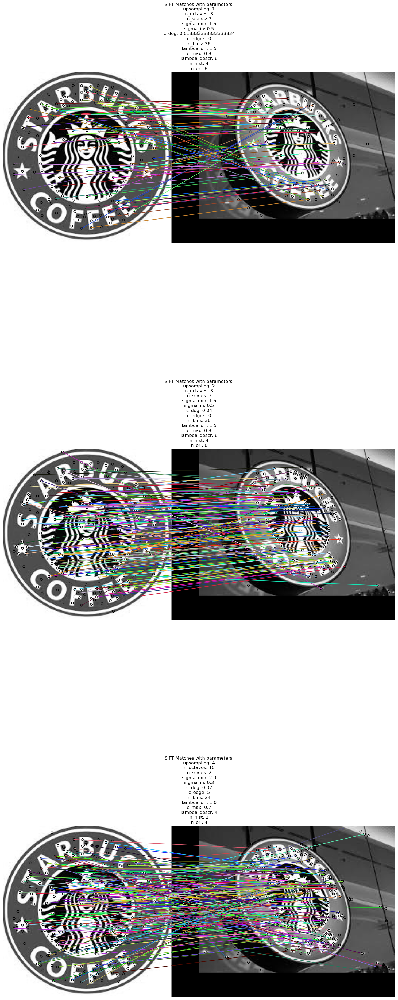

In [34]:
# Your solution here

# Define a function to run SIFT with the given parameters
def run_SIFT(img1, img2, **kwargs):
    # Create a SIFT object with the given parameters
    sift = SIFT(**kwargs)
    
    # Detect and extract features from the first image
    sift.detect_and_extract(img1)
    keypoints1 = sift.keypoints
    descriptors1 = sift.descriptors

    # Detect and extract features from the second image
    sift.detect_and_extract(img2)
    keypoints2 = sift.keypoints
    descriptors2 = sift.descriptors

    # Match descriptors between the two images
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True)
    
    return keypoints1, keypoints2, matches

# Load the reference and scene images
starbucks_model_image = to_grayscale(io.imread('./images/starbucks.jpg'))
starbucks_scene_image = to_grayscale(io.imread('./images/starbucks4.jpg'))

# SIFT parameters
sift_parameters_list = [
    {
        'upsampling': 1, 'n_octaves': 8, 'n_scales': 3, 'sigma_min': 1.6, 'sigma_in': 0.5,
        'c_dog': 0.013333333333333334, 'c_edge': 10, 'n_bins': 36, 'lambda_ori': 1.5,
        'c_max': 0.8, 'lambda_descr': 6, 'n_hist': 4, 'n_ori': 8
    },
    {
        'upsampling': 2, 'n_octaves': 8, 'n_scales': 3, 'sigma_min': 1.6, 'sigma_in': 0.5,
        'c_dog': 0.04, 'c_edge': 10, 'n_bins': 36, 'lambda_ori': 1.5, 'c_max': 0.8,
        'lambda_descr': 6, 'n_hist': 4, 'n_ori': 8
    },
    {
        'upsampling': 4, 'n_octaves': 10, 'n_scales': 2, 'sigma_min': 2.0, 'sigma_in': 0.3,
        'c_dog': 0.02, 'c_edge': 5, 'n_bins': 24, 'lambda_ori': 1.0, 'c_max': 0.7,
        'lambda_descr': 4, 'n_hist': 2, 'n_ori': 4
    }
]

# Create a figure with subplots
fig, axes = plt.subplots(len(sift_parameters_list), 1, figsize=(15, 15 * len(sift_parameters_list)))

# Run SIFT with different parameters and plot the results
for idx, sift_parameters in enumerate(sift_parameters_list):
    keypoints1, keypoints2, matches = run_SIFT(starbucks_model_image, starbucks_scene_image, **sift_parameters)
    ax = axes[idx]
    plot_matches(ax, starbucks_model_image, starbucks_scene_image, keypoints1, keypoints2, matches)
    ax.axis('off')
    # Use the helper function to get the parameters as a string and set it as the title
    ax.set_title(f"SIFT Matches with parameters:\n{parameters_to_string(sift_parameters)}")
    ax.axis('off')

plt.tight_layout()
plt.show()

**4.3 (10 points)** Can we build an image classifier using the SIFT algorithm? Start by uploading the images from the folder `matches_SIFT`, then use the SIFT algorithm to find the most similar pairs (use the following parameters for this: max_ratio=0.8, upsampling=2, n_octaves=8, n_scales=3). To compare all the images, we'll need to establish a metric. We suggest to use the number of matches between images.

Show your results (SIFT result image matches and print the similarity only for the most similar image for each of the 6 images provided). Rescale the images to see the matches between images.

Answer the following: 
* Is the algorithm failing to find accurate matches (similar images) for some cases? If so, why do you think this is happening? You can assume that a good results is that eiffel tower images match between them and so on. 

Here is an example of the expected results for ciudad_ciencias_1.jpg (you also have to print the similarity metric result): 

<img src="images/example_city_of_arts.png" width="400" height="300">

**Answer to the question**

The algorithm is not failing to find accurate matches for the given cases.

In [35]:
def get_SIFT(img1, img2, n_octaves=8, n_scales=3, max_ratio=0.8, upsampling=2):
    # Initialize SIFT with the specified parameters
    
    sift = SIFT(n_octaves=n_octaves, n_scales=n_scales, upsampling=upsampling)

    # Detect and extract features from the first image
    sift.detect_and_extract(img1)
    keypoints1 = sift.keypoints
    descriptors1 = sift.descriptors

    # Detect and extract features from the second image
    sift.detect_and_extract(img2)
    keypoints2 = sift.keypoints
    descriptors2 = sift.descriptors

    # Match descriptors between the two images
    matches = match_descriptors(descriptors1, descriptors2, max_ratio=max_ratio, cross_check=True)
    
    return keypoints1, keypoints2, matches

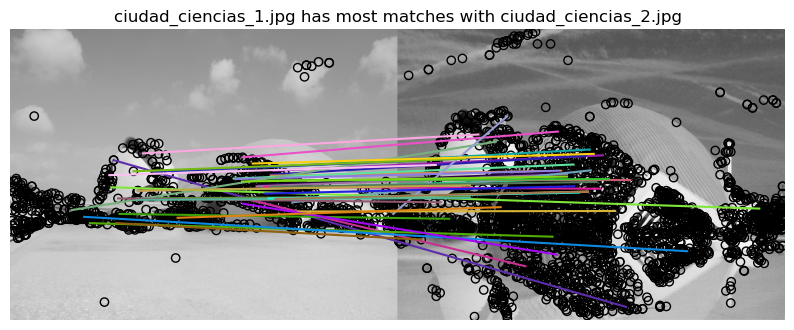

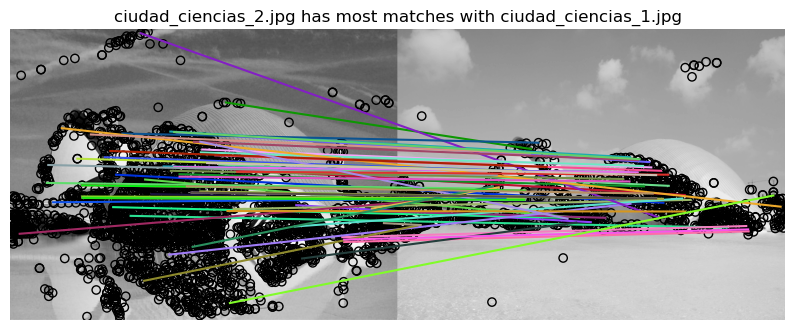

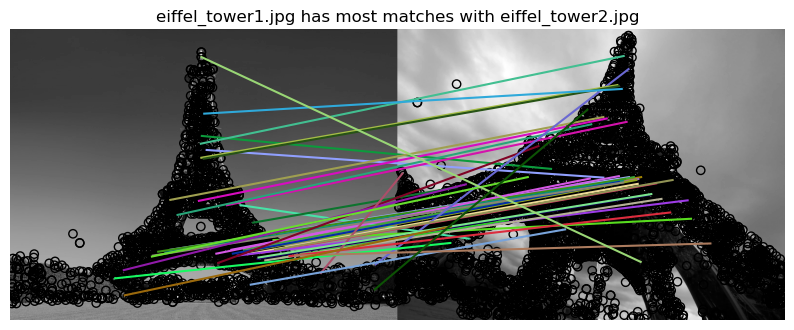

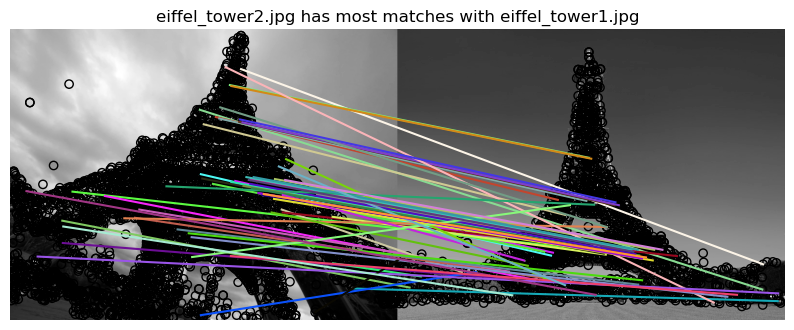

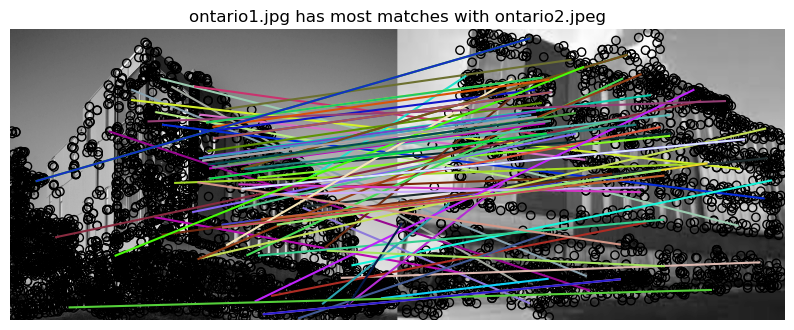

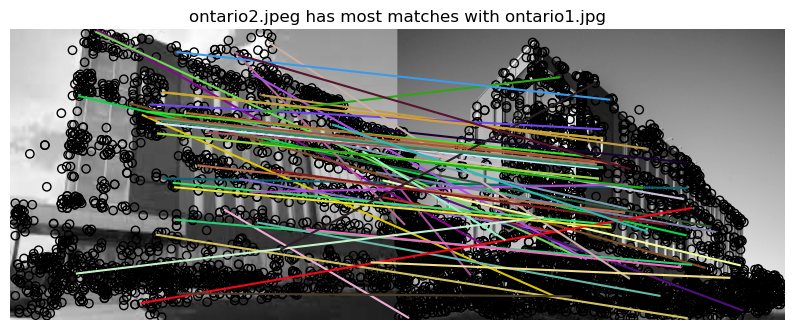

In [36]:
from skimage.transform import resize

# Load images
folder_path = './images/matches_SIFT'
image_filenames = sorted(os.listdir(folder_path))
common_size = (600, 800)
images = [resize(to_grayscale(io.imread(os.path.join(folder_path, filename))),common_size) for filename in image_filenames]


# Use two nested for loops to compare each image with every other image
for img1_idx in range(len(images)):
    most_matches = 0
    best_match_idx = None
    best_match_keypoints = None

    for img2_idx in range(len(images)): 
        # Skip comparison with itself
        if img1_idx == img2_idx: continue

        img1 = images[img1_idx]
        img2 = images[img2_idx]

        # Use get_SIFT to find matches between img1 and img2
        keypoints1, keypoints2, matches = get_SIFT(img1, img2)

        # Update most similar match if current one has more matches
        n_matches = len(matches)
        if n_matches > most_matches:
            most_matches = n_matches
            best_match_idx = img2_idx
            best_match_keypoints = (keypoints1, keypoints2, matches)

    # Plot the matches for the best match found
    if best_match_idx is not None:
        kp1, kp2, matches = best_match_keypoints
        fig, ax = plt.subplots(figsize=(10, 5))
        plot_matches(ax, images[img1_idx], images[best_match_idx], kp1, kp2, matches)
        plt.title(f"{image_filenames[img1_idx]} has most matches with {image_filenames[best_match_idx]}")
        plt.axis('off')
        plt.show()

### Appendix

In [37]:
# In case the plot_matches() function gives you some problems, you can use the following one:

from skimage.util import img_as_float
import numpy as np

def plot_matches_aux(ax, image1, image2, keypoints1, keypoints2, matches,
                 keypoints_color='k', matches_color=None, only_matches=False):
    """Plot matched features.
    Parameters
    ----------
    ax : matplotlib.axes.Axes
        Matches and image are drawn in this ax.
    image1 : (N, M [, 3]) array
        First grayscale or color image.
    image2 : (N, M [, 3]) array
        Second grayscale or color image.
    keypoints1 : (K1, 2) array
        First keypoint coordinates as ``(row, col)``.
    keypoints2 : (K2, 2) array
        Second keypoint coordinates as ``(row, col)``.
    matches : (Q, 2) array
        Indices of corresponding matches in first and second set of
        descriptors, where ``matches[:, 0]`` denote the indices in the first
        and ``matches[:, 1]`` the indices in the second set of descriptors.
    keypoints_color : matplotlib color, optional
        Color for keypoint locations.
    matches_color : matplotlib color, optional
        Color for lines which connect keypoint matches. By default the
        color is chosen randomly.
    only_matches : bool, optional
        Whether to only plot matches and not plot the keypoint locations.
    """

    image1 = img_as_float(image1)
    image2 = img_as_float(image2)

    new_shape1 = list(image1.shape)
    new_shape2 = list(image2.shape)

    if image1.shape[0] < image2.shape[0]:
        new_shape1[0] = image2.shape[0]
    elif image1.shape[0] > image2.shape[0]:
        new_shape2[0] = image1.shape[0]

    if image1.shape[1] < image2.shape[1]:
        new_shape1[1] = image2.shape[1]
    elif image1.shape[1] > image2.shape[1]:
        new_shape2[1] = image1.shape[1]

    if new_shape1 != image1.shape:
        new_image1 = np.zeros(new_shape1, dtype=image1.dtype)
        new_image1[:image1.shape[0], :image1.shape[1]] = image1
        image1 = new_image1

    if new_shape2 != image2.shape:
        new_image2 = np.zeros(new_shape2, dtype=image2.dtype)
        new_image2[:image2.shape[0], :image2.shape[1]] = image2
        image2 = new_image2

    image = np.concatenate([image1, image2], axis=1)

    offset = image1.shape

    if not only_matches:
        ax.scatter(keypoints1[:, 1], keypoints1[:, 0],
                   facecolors='none', edgecolors=keypoints_color)
        ax.scatter(keypoints2[:, 1] + offset[1], keypoints2[:, 0],
                   facecolors='none', edgecolors=keypoints_color)

    ax.imshow(image, interpolation='nearest', cmap='gray')
    ax.axis((0, 2 * offset[1], offset[0], 0))

    for i in range(matches.shape[0]):
        idx1 = matches[i, 0]
        idx2 = matches[i, 1]

        if matches_color is None:
            color = np.random.rand(3)
        else:
            color = matches_color

        ax.plot((keypoints1[idx1, 1], keypoints2[idx2, 1] + offset[1]),
                (keypoints1[idx1, 0], keypoints2[idx2, 0]),
                '-', color=color)